In [120]:
# dataframe and plotting
import pandas as pd
import numpy as np
import seaborn as sns


#pipeline
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import OneHotEncoder, MinMaxScaler

from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA

In [121]:
# Load files into a pandas dataframe
df = pd.read_csv('bank_marketing_dataset.csv')

In [122]:
df.describe()

,age,duration,campaign,pdays,previous,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed
count,41188.00000,41188.000000,41188.000000,41188.000000,41188.000000,41188.000000,41188.000000,41188.000000,41188.000000,41188.000000
mean,40.02406,258.285010,2.567593,962.475454,0.172963,0.081886,93.575664,-40.502600,3.621291,5167.035911
std,10.42125,259.279249,2.770014,186.910907,0.494901,1.570960,0.578840,4.628198,1.734447,72.251528
min,17.00000,0.000000,1.000000,0.000000,0.000000,-3.400000,92.201000,-50.800000,0.634000,4963.600000
25%,32.00000,102.000000,1.000000,999.000000,0.000000,-1.800000,93.075000,-42.700000,1.344000,5099.100000
50%,38.00000,180.000000,2.000000,999.000000,0.000000,1.100000,93.749000,-41.800000,4.857000,5191.000000
75%,47.00000,319.000000,3.000000,999.000000,0.000000,1.400000,93.994000,-36.400000,4.961000,5228.100000
max,98.00000,4918.000000,56.000000,999.000000,7.000000,1.400000,94.767000,-26.900000,5.045000,5228.100000


In [123]:
#check missing values
print('missing values:', df.isnull().sum())

missing values: age               0
job               0
marital           0
education         0
default           0
housing           0
loan              0
contact           0
month             0
day_of_week       0
duration          0
campaign          0
pdays             0
previous          0
poutcome          0
emp.var.rate      0
cons.price.idx    0
cons.conf.idx     0
euribor3m         0
nr.employed       0
subscribed        0
dtype: int64


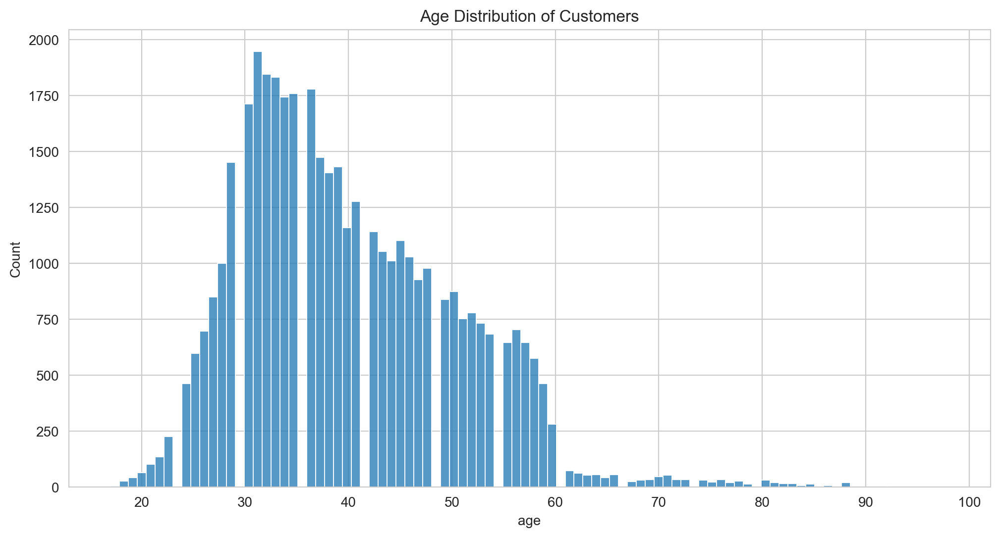

In [124]:
plt.figure(figsize=(12,6),dpi=200)
sns.histplot(data=df,x="age")
plt.title("Age Distribution of Customers")
plt.show()

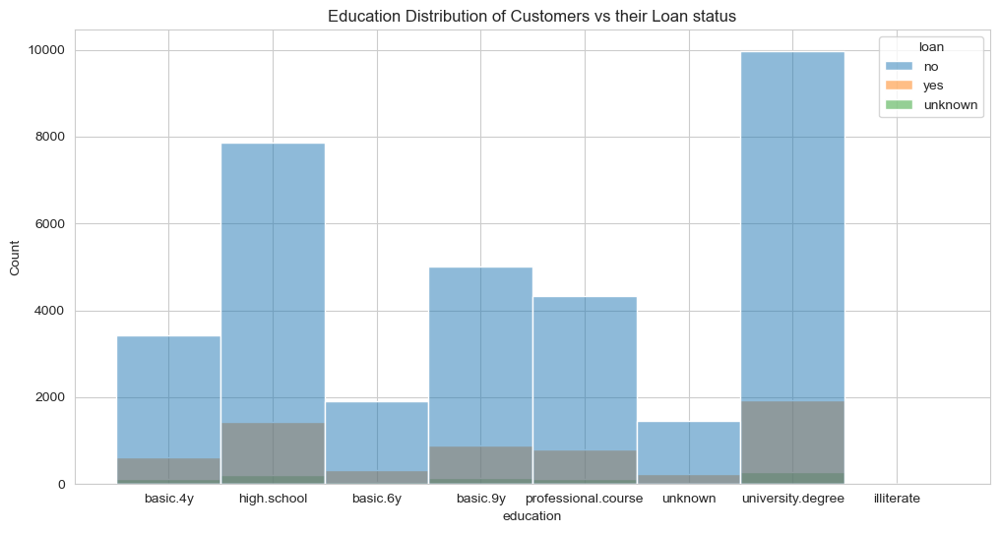

In [125]:
plt.figure(figsize=(12,6),dpi=100)
sns.histplot(data=df,x="education",hue="loan",bins=30)
plt.title("Education Distribution of Customers vs their Loan status")
plt.show()

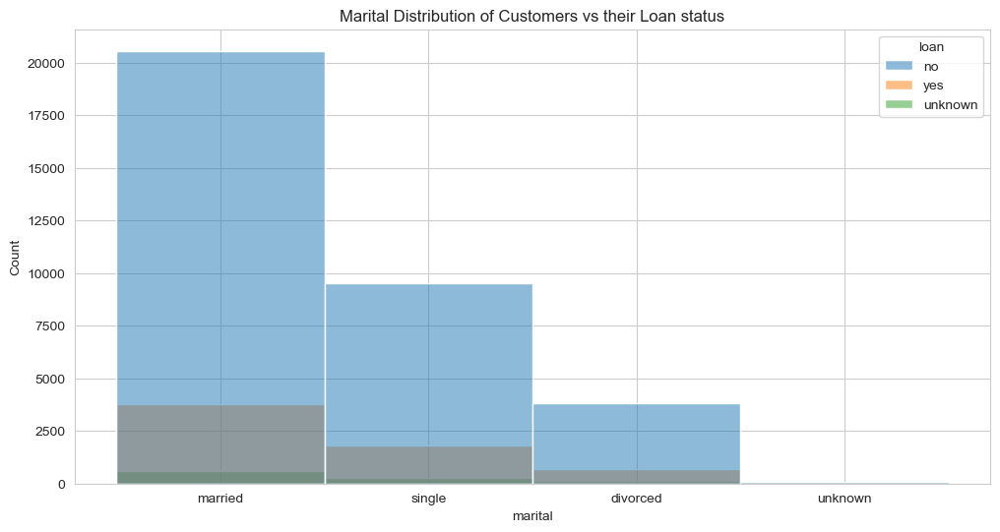

In [126]:
plt.figure(figsize=(12,6),dpi=100)
sns.histplot(data=df,x="marital",hue="loan",bins=30)
plt.title("Marital Distribution of Customers vs their Loan status")
plt.show()

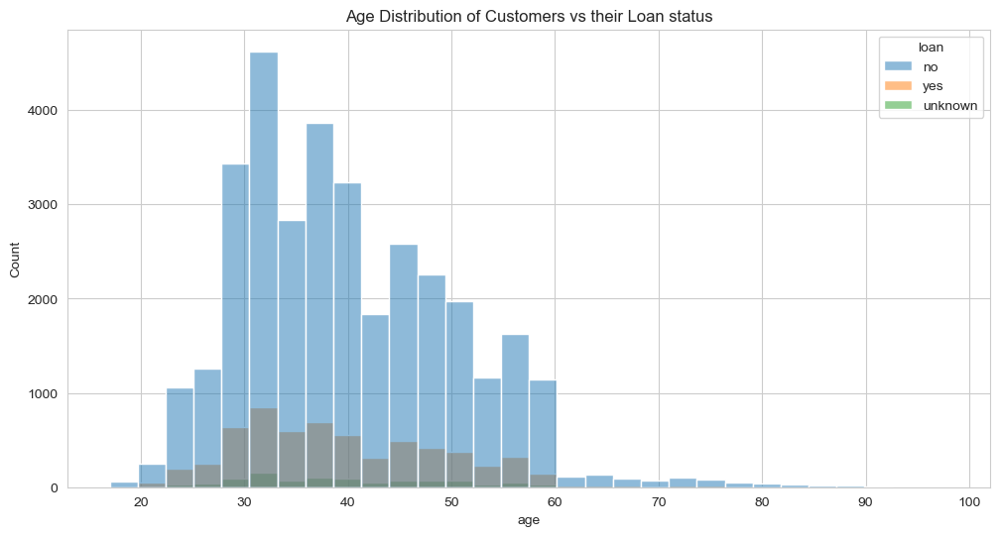

In [127]:
plt.figure(figsize=(12,6),dpi=100)
sns.histplot(data=df,x="age",hue="loan",bins=30)
plt.title("Age Distribution of Customers vs their Loan status")
plt.show()

Converting categorical data to numerical data

In [128]:

# Define categorical and numerical columns
categorical_columns = ['job', 'marital', 'education', 'default', 'housing', 'loan', 'contact', 'month', 'day_of_week', 'poutcome', 'subscribed']
numerical_columns = [col for col in df.columns if col not in categorical_columns]

categorical_columns.remove('month')

# Build transformers using ColumnTransformer
preprocessor = ColumnTransformer(
    transformers=[
        ('num', MinMaxScaler(), numerical_columns),
        ('cat', OneHotEncoder(drop='first'), categorical_columns) # drop='first' can be used to reduce multicollinearity
    ])

# Build and execute the pipeline
pipeline = Pipeline([
    ('preprocessor', preprocessor)
])

df_transformed = pipeline.fit_transform(df)

# Get feature names from one-hot encoding
encoded_features = list(preprocessor.named_transformers_['cat'].get_feature_names_out(categorical_columns))
all_columns = numerical_columns + encoded_features

# Convert transformed data back to DataFrame with appropriate column names
df_transformed = pd.DataFrame(df_transformed, columns=all_columns)


Check Elbow

/Users/yunxu/.conda/envs/test_project/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/Users/yunxu/.conda/envs/test_project/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/Users/yunxu/.conda/envs/test_project/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/Users/yunxu/.conda/envs/test_project/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly t

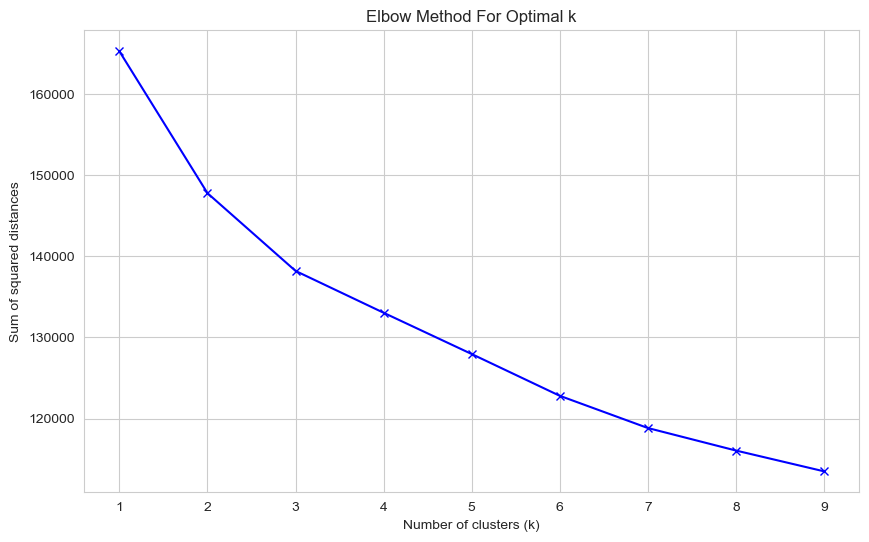

In [129]:
# Calculate the sum of squared distances for different cluster numbers
ssd = []
K = range(1, 10)
for k in K:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(df_transformed)
    ssd.append(kmeans.inertia_)

# Plot the elbow
plt.figure(figsize=(10, 6))
plt.plot(K, ssd, 'bx-')
plt.xlabel('Number of clusters (k)')
plt.ylabel('Sum of squared distances')
plt.title('Elbow Method For Optimal k')
plt.show()

Apply K-means clusters

/Users/yunxu/.conda/envs/test_project/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


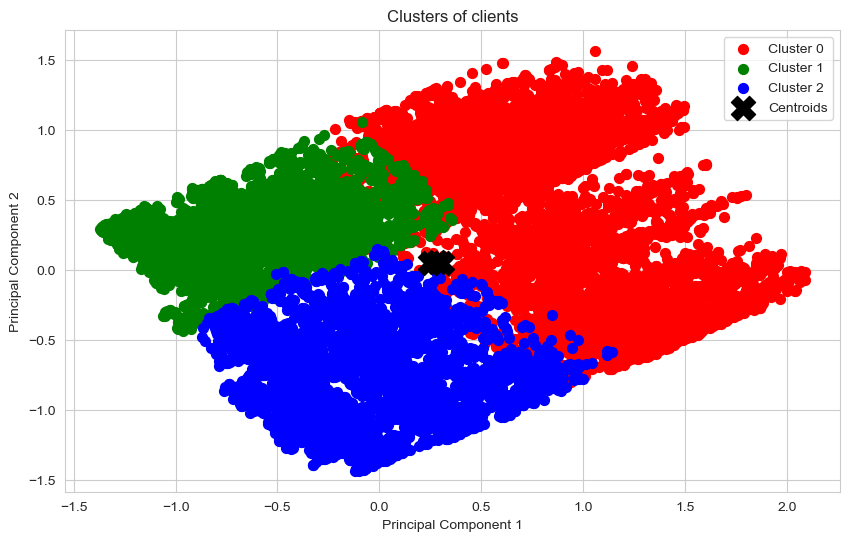

In [130]:
#Apply K-means clustering
n_clusters = 3
kmeans = KMeans(n_clusters=n_clusters, random_state=42)
df_transformed['cluster'] = kmeans.fit_predict(df_transformed)

#Reduce dimensionality for visualization using PCA
pca = PCA(n_components=2)  # Reduce to 2 dimensions for visualization
principal_components = pca.fit_transform(df_transformed.drop('cluster', axis=1))
df_pca = pd.DataFrame(data=principal_components, columns=['PC1', 'PC2'])
df_pca['cluster'] = df_transformed['cluster']

#Visualize the clusters
plt.figure(figsize=(10, 6))
colors = ['r', 'g', 'b', 'y', 'c', 'm']

for i in range(n_clusters):
    plt.scatter(df_pca[df_pca['cluster'] == i]['PC1'],
                df_pca[df_pca['cluster'] == i]['PC2'],
                s = 50, c = colors[i], label = f'Cluster {i}')

plt.scatter(kmeans.cluster_centers_[:, 0], kmeans.cluster_centers_[:, 1], s = 300, c = 'black', marker='X', label = 'Centroids')
plt.title('Clusters of clients')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.legend()
plt.show()

In [131]:
print(df_transformed['cluster'].value_counts().sort_index())

0    13480
1    17673
2    10035
Name: cluster, dtype: int64


             age                                                     duration  \
           count       mean        std   min   25%   50%   75%   max    count   
cluster                                                                         
0        13480.0  39.801632  12.564556  17.0  31.0  37.0  46.0  98.0  13480.0   
1        17673.0  41.912409   8.890519  20.0  35.0  41.0  49.0  61.0  17673.0   
2        10035.0  36.997210   8.888059  18.0  30.0  35.0  43.0  66.0  10035.0   

                     ... euribor3m        nr.employed                          \
               mean  ...       75%    max       count         mean        std   
cluster              ...                                                        
0        272.380341  ...     1.344  4.191     13480.0  5073.426001  45.033529   
1        250.836078  ...     4.963  5.045     17673.0  5212.724744  18.526152   
2        252.469357  ...     4.962  5.045     10035.0  5212.317708  24.485974   

                          

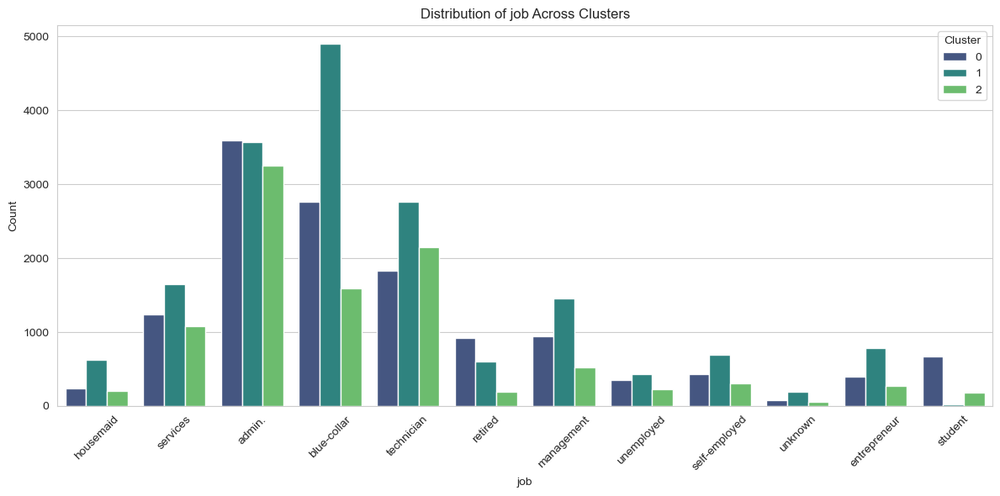

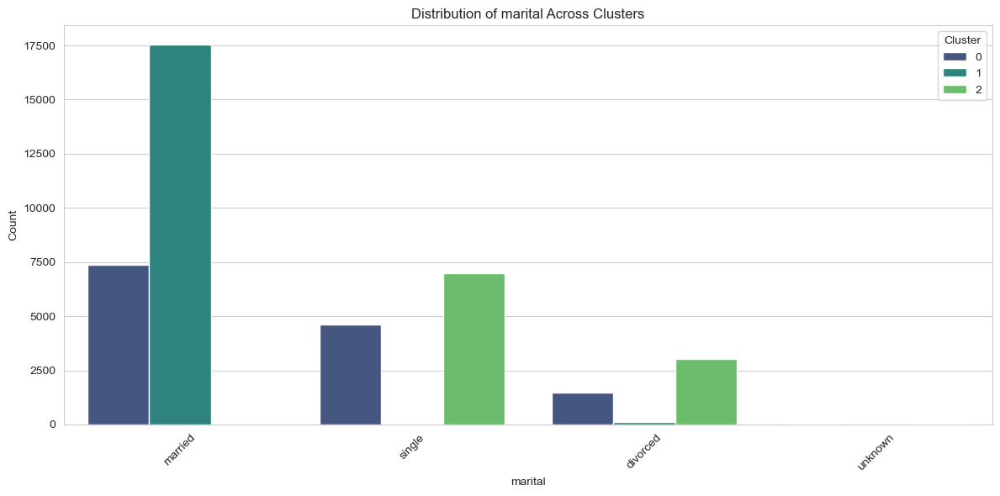

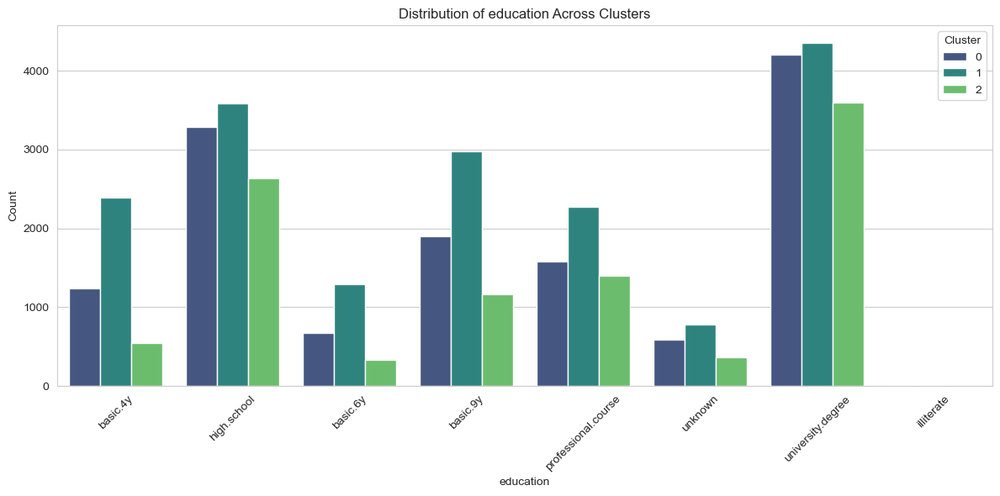

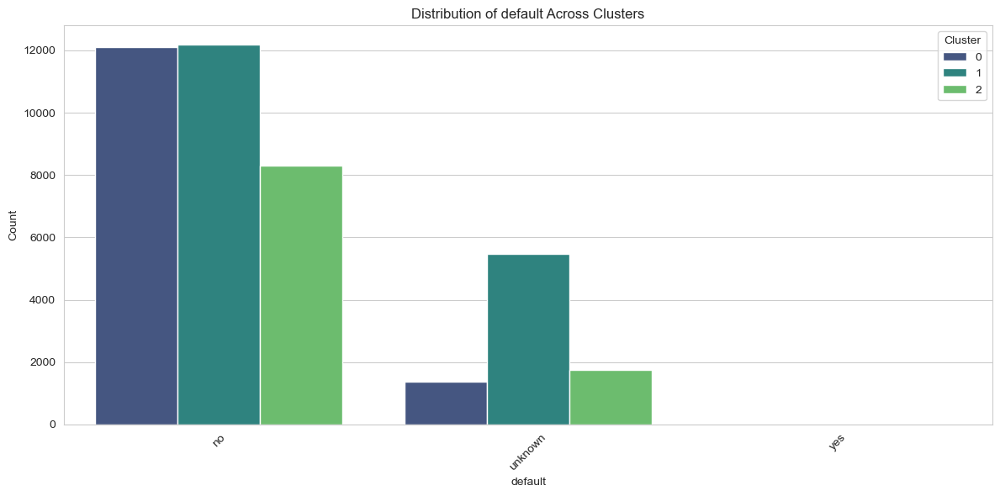

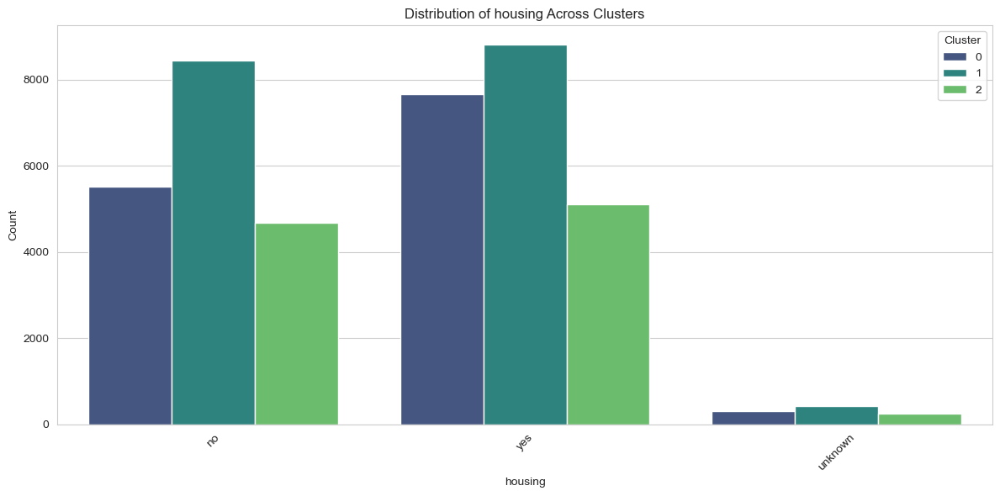

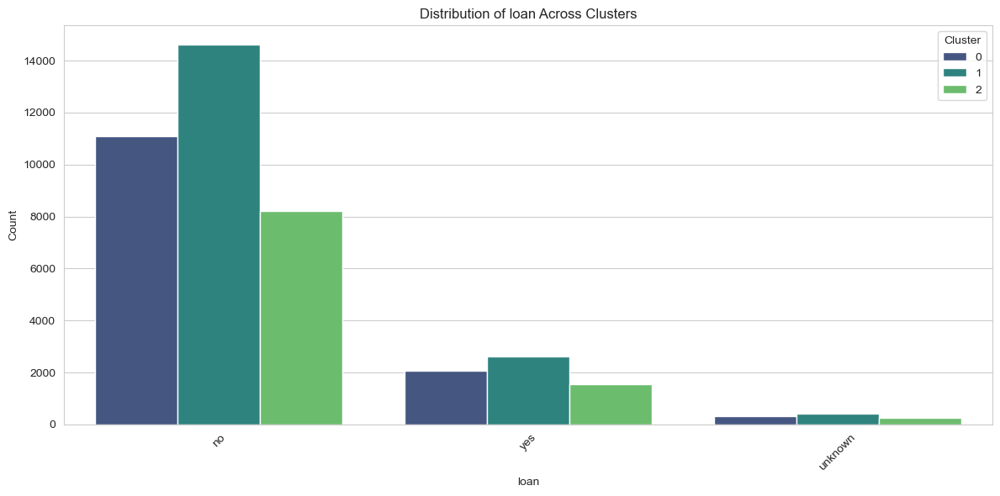

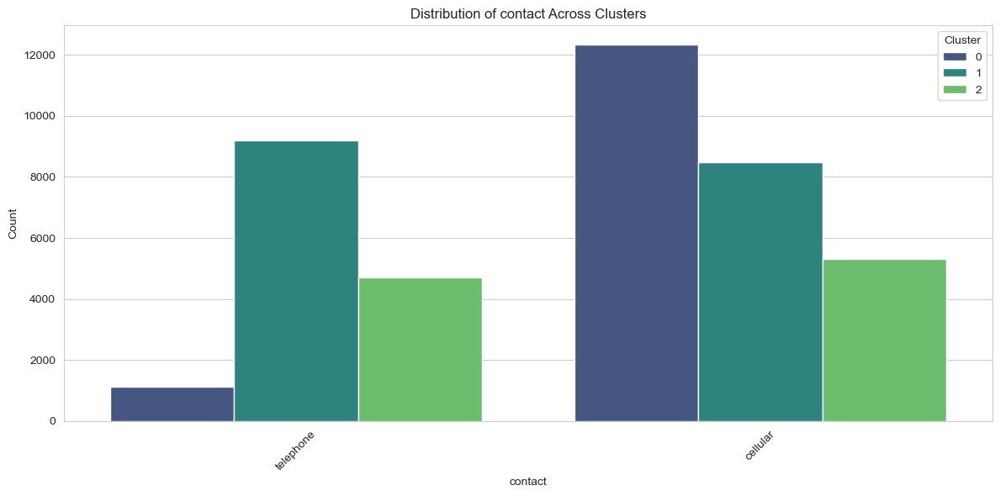

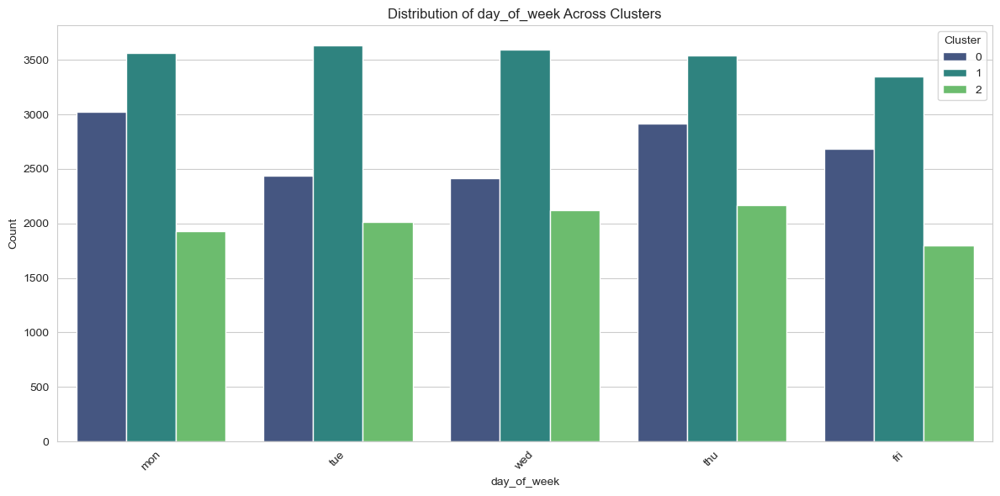

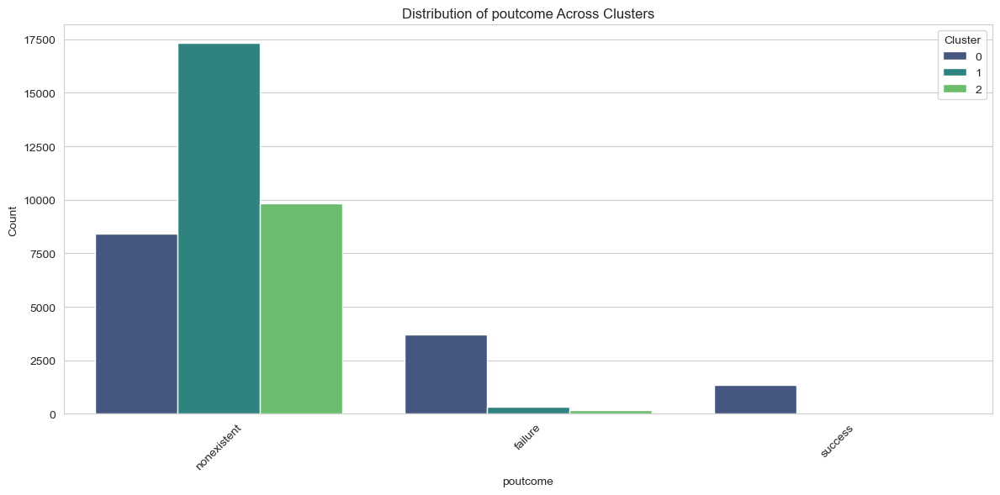

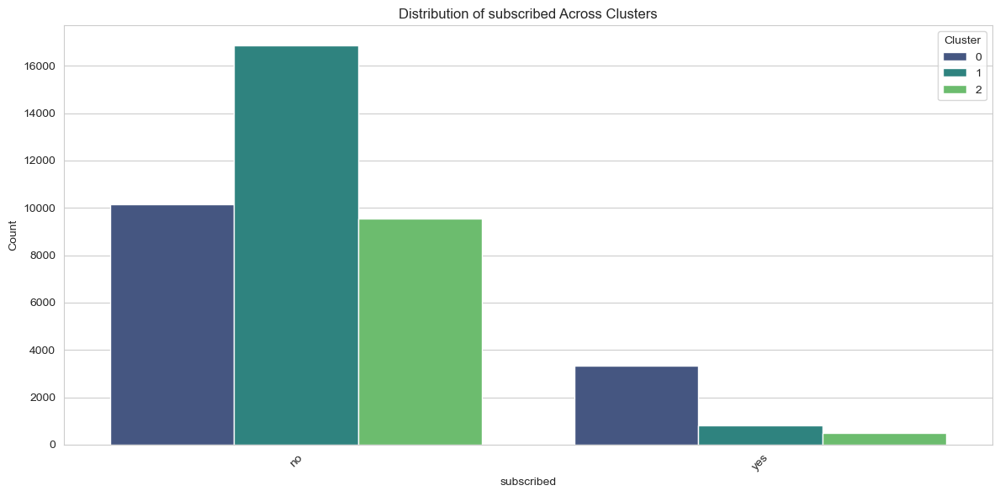

In [132]:

df['cluster'] = df_transformed['cluster']

#Summarize All Clusters
# Group by the cluster column and describe
cluster_summary = df.groupby('cluster').describe()

# Print summary statistics for each cluster
print(cluster_summary)

# Visualize with Column Charts for each categorical column

for col in categorical_columns:
    plt.figure(figsize=(12, 6))

# Using seaborn's countplot to get the counts and plot for each cluster
    sns.countplot(data=df, x=col, hue='cluster', palette='viridis')

    plt.title(f'Distribution of {col} Across Clusters')
    plt.ylabel('Count')
    plt.xlabel(col)
    plt.xticks(rotation=45)
    plt.legend(title='Cluster')
    plt.tight_layout()
    plt.show()


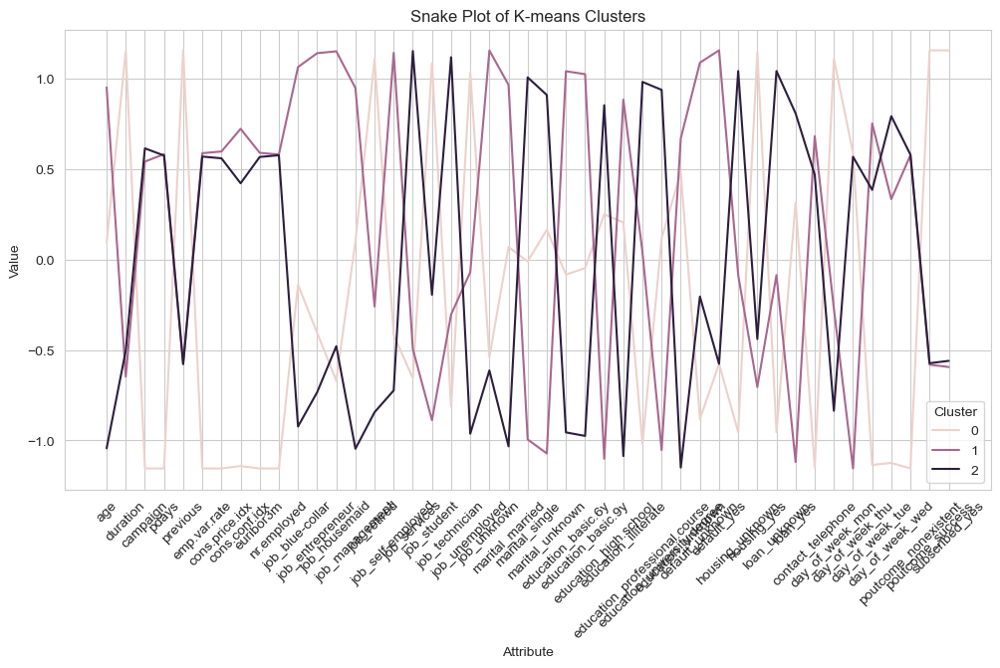

In [133]:
import matplotlib.pyplot as plt
import seaborn as sns

# 1. Standardize the data to get a dataframe of the cluster centroids

# Convert cluster centroids to a dataframe
df_centroids = pd.DataFrame(kmeans.cluster_centers_, columns=all_columns)

# This will have a mean of 0 and standard deviation of 1 across rows
df_centroids_standardized = (df_centroids - df_centroids.mean()) / df_centroids.std()

# 2. Melt the data into a long format
df_melted = pd.melt(df_centroids_standardized.reset_index(),
                    id_vars='index',
                    value_vars=[col for col in df_transformed.columns if col != 'cluster'],
                    var_name='Attribute',
                    value_name='Value')

# 3. Create the snake plot
plt.figure(figsize=(12, 6))
sns.lineplot(x='Attribute', y='Value', hue='index', data=df_melted)
plt.title('Snake Plot of K-means Clusters')
plt.xlabel('Attribute')
plt.ylabel('Value')
plt.xticks(rotation=45)
plt.legend(title='Cluster')
plt.show()


from above barchart for each cluster, I noticed that customer in cluster 0 have higher willing to subscribe than customer in cluster 1 and 2. This heightened inclination can be attributed to several distinct characteristics, and patterns observed with this clusters:

communication preference:
Majority of individuals in this cluster prefer to be contacted via cellular, which might suggest their oppenness to mobile communication

Housing and financial:
Most of customers in this clsuter have house, underscore a certain level of financial stability or commitment. furthermore, a consistent trend across all clusters, including cluster 0, is the absense of credit defaults, which indicate a creditworthy clientele.

Educational & professional profile:
A significant portion of cluster 0 have university degree. this educational attainment, combined with the observation that many work in administrative role, suggest a certain professional segment that aligns with subscription preference.

Marital Status

Cluster 0 leans toward married. this could indicate a lifestyle stage where certain services or offers are more appealing pr relevant.


in summary, cluster 0 encapsulates a demographic that is well-educated, primarily married, financial stable, who work as administrative and keen on mobile communication. these attributes collectively seem to resonate with a higher propensity to subscribe


In [ ]:
# dataframe and plotting
import pandas as pd
import numpy as np
import seaborn as sns


#pipeline
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import OneHotEncoder, MinMaxScaler

from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA

In [4]:
import pandas as pd
df= pd.read_excel('cluster_0_data.xlsx')
df.head()

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,...,pdays,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,subscribed,cluster
0,44,management,married,university.degree,no,yes,no,cellular,nov,mon,...,999,1,failure,-0.1,93.2,-42.0,4.191,5195.8,no,0
1,52,admin.,married,university.degree,no,yes,yes,cellular,nov,mon,...,999,1,failure,-0.1,93.2,-42.0,4.191,5195.8,no,0
2,41,entrepreneur,married,university.degree,no,yes,no,cellular,nov,mon,...,999,1,failure,-0.1,93.2,-42.0,4.191,5195.8,no,0
3,36,unemployed,divorced,high.school,no,yes,yes,cellular,nov,mon,...,999,1,failure,-0.1,93.2,-42.0,4.191,5195.8,no,0
4,39,admin.,married,university.degree,no,yes,no,cellular,nov,mon,...,999,1,failure,-0.1,93.2,-42.0,4.191,5195.8,no,0


In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 13480 entries, 0 to 13479
Data columns (total 22 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   age             13480 non-null  int64  
 1   job             13480 non-null  object 
 2   marital         13480 non-null  object 
 3   education       13480 non-null  object 
 4   default         13480 non-null  object 
 5   housing         13480 non-null  object 
 6   loan            13480 non-null  object 
 7   contact         13480 non-null  object 
 8   month           13480 non-null  object 
 9   day_of_week     13480 non-null  object 
 10  duration        13480 non-null  int64  
 11  campaign        13480 non-null  int64  
 12  pdays           13480 non-null  int64  
 13  previous        13480 non-null  int64  
 14  poutcome        13480 non-null  object 
 15  emp.var.rate    13480 non-null  float64
 16  cons.price.idx  13480 non-null  float64
 17  cons.conf.idx   13480 non-null 

Columns
1 - age (numeric) <br>
2 - job : type of job (categorical: 'admin.','blue-collar','entrepreneur','housemaid','management','retired','self-employed','services','student','technician','unemployed','unknown')<br>
3 - marital : marital status (categorical: 'divorced','married','single','unknown'; note: 'divorced' means divorced or widowed)<br>
4 - education (categorical: <br>'basic.4y','basic.6y','basic.9y','high.school','illiterate','professional.course','university.degree','unknown')<br>
5 - default: has credit in default? (categorical: 'no','yes','unknown')<br>
6 - housing: has housing loan? (categorical: 'no','yes','unknown')<br>
7 - loan: has personal loan? (categorical: 'no','yes','unknown')<br>

Related with the last contact of the current campaign:<br>
8 - contact: contact communication type (categorical: 'cellular','telephone')<br>
9 - month: last contact month of year (categorical: 'jan', 'feb', 'mar', …, 'nov', 'dec')<br>
10 - day_of_week: last contact day of the week (categorical: 'mon','tue','wed','thu','fri')<br>
11 - duration: last contact duration, in seconds (numeric). Important note: this attribute highly affects the output target (e.g., if duration=0 then y='no'). Yet, the duration is not known before a call is performed. Also, after the end of the call y is obviously known. Thus, this input should only be included for benchmark purposes and should be discarded if the intention is to have a realistic predictive model.<br>

Other attributes:<br>
12 - campaign: number of contacts performed during this campaign and for this client (numeric, includes last contact)<br>
13 - pdays: number of days that passed by after the client was last contacted from a previous campaign (numeric; 999 means client was not previously contacted)<br>
14 - previous: number of contacts performed before this campaign and for this client (numeric)<br>
15 - poutcome: outcome of the previous marketing campaign (categorical: 'failure','nonexistent','success')<br>

Social and economic context attributes<br>
16 - emp.var.rate: employment variation rate - quarterly indicator (numeric)<br>
17 - cons.price.idx: consumer price index - monthly indicator (numeric)<br>
18 - cons.conf.idx: consumer confidence index - monthly indicator (numeric)<br>
19 - euribor3m: euribor 3 month rate - daily indicator (numeric)<br>
20 - nr.employed: number of employees - quarterly indicator (numeric)<br>
21 - subscribed : has the client subscribed a term deposit? (binary: 'yes','no')<br>



In [6]:
df.describe()

,age,duration,campaign,pdays,previous,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,cluster
count,13480.000000,13480.000000,13480.000000,13480.000000,13480.000000,13480.000000,13480.000000,13480.000000,13480.000000,13480.000000,13480.0
mean,39.801632,272.380341,2.075964,888.432938,0.487166,-2.017396,93.029154,-42.579718,1.205746,5073.426001,0.0
std,12.564556,254.322547,1.623704,312.367222,0.749002,0.621006,0.509913,6.320441,0.426080,45.033529,0.0
min,17.000000,0.000000,1.000000,0.000000,0.000000,-3.400000,92.201000,-50.800000,0.634000,4963.600000,0.0
25%,31.000000,113.750000,1.000000,999.000000,0.000000,-1.800000,92.893000,-46.200000,0.884000,5076.200000,0.0
50%,37.000000,201.000000,2.000000,999.000000,0.000000,-1.800000,92.893000,-46.200000,1.268000,5099.100000,0.0
75%,46.000000,341.000000,2.000000,999.000000,1.000000,-1.800000,93.075000,-39.800000,1.344000,5099.100000,0.0
max,98.000000,3785.000000,23.000000,999.000000,7.000000,-0.100000,94.767000,-26.900000,4.191000,5195.800000,0.0


### EDA

In [7]:
Target = 'subscribed'
predictors = [col for col in df.columns if col not in Target]
categorical_features = ['job','marital','education','default','housing','loan',
                        'contact','month','day_of_week','poutcome']
numerical_features = [col for col in predictors if col not in categorical_features]
print(f'numerical_features: {numerical_features}')

numerical_features: ['age', 'duration', 'campaign', 'pdays', 'previous', 'emp.var.rate', 'cons.price.idx', 'cons.conf.idx', 'euribor3m', 'nr.employed', 'cluster']


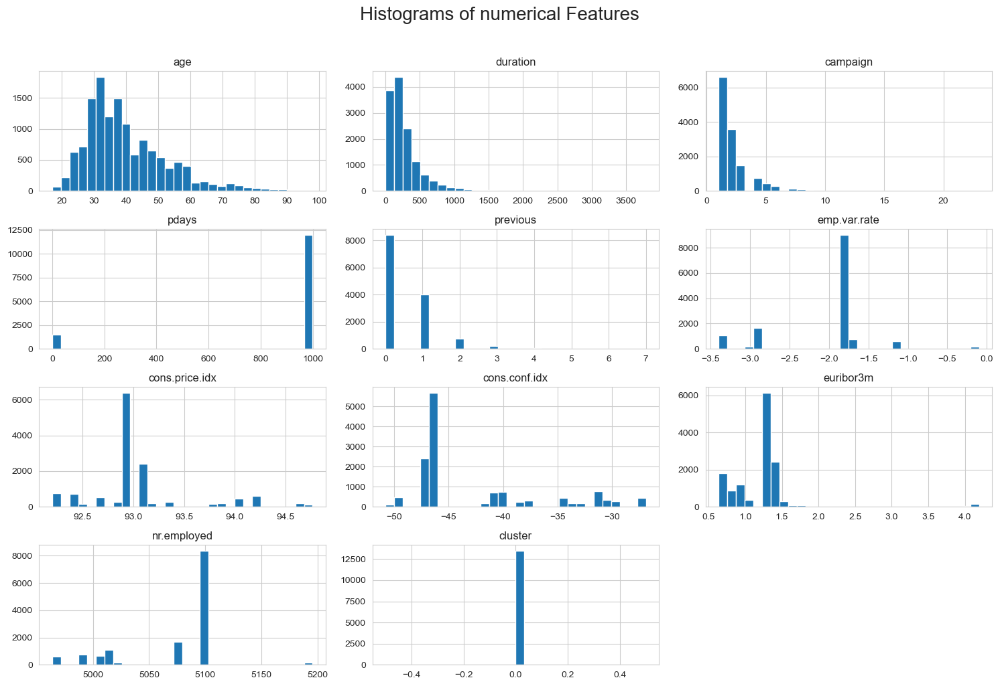

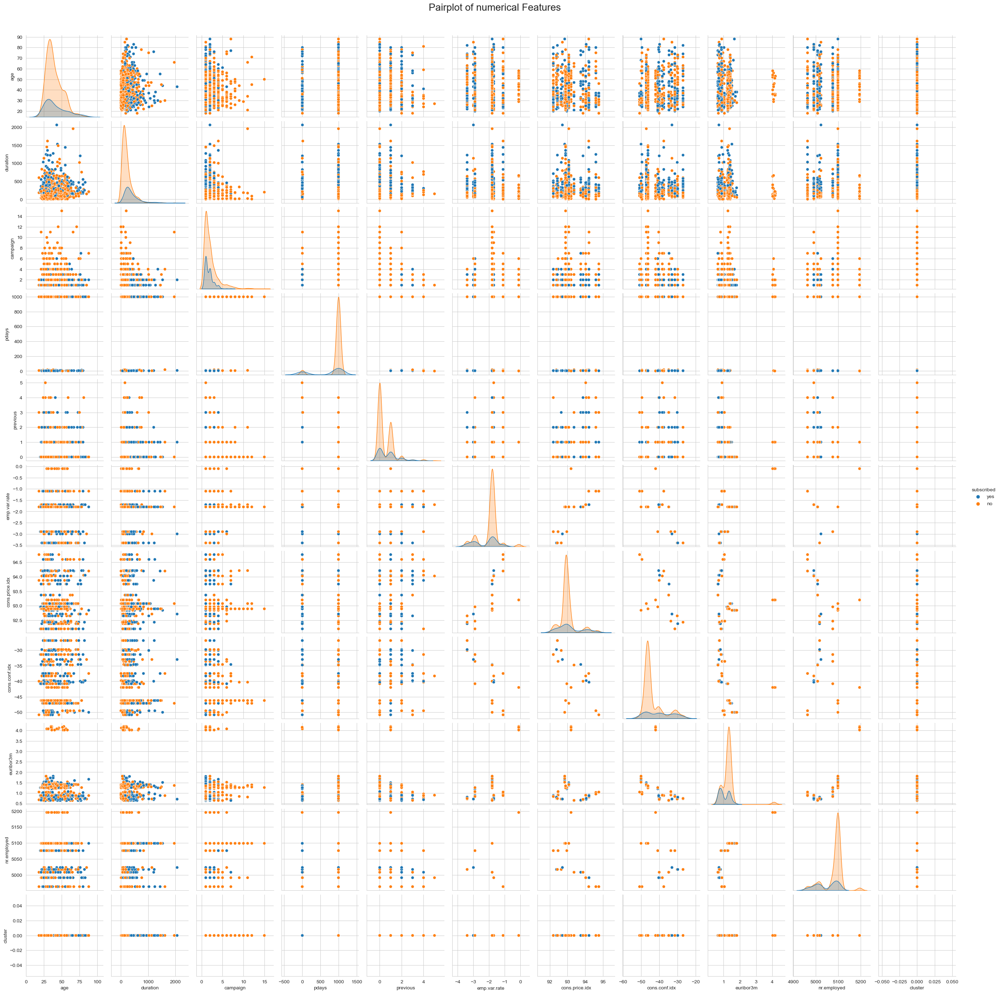

In [8]:
# Set the style of seaborn for better visualization
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style("whitegrid")

# Histograms
df.hist(figsize=(15, 10), bins=30)
plt.suptitle('Histograms of numerical Features', x=0.5, y=1.02, ha='center', fontsize=20)
plt.tight_layout()
plt.show()

# Pairplot
sns.pairplot(df.drop(columns = categorical_features).sample(1000,random_state=42), hue ='subscribed')
plt.suptitle('Pairplot of numerical Features', x=0.5, y=1.02, ha='center', fontsize=20)
plt.show()


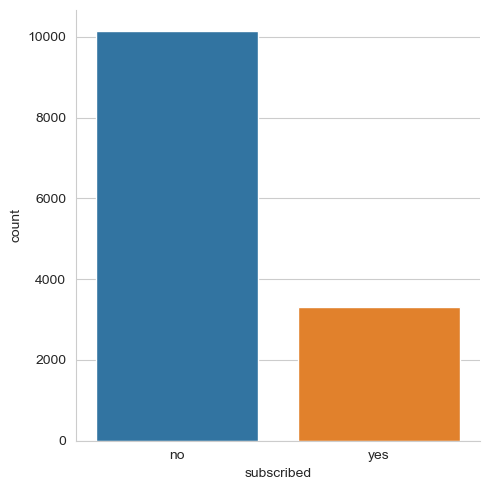

In [9]:
import seaborn as sns
import matplotlib.pyplot as plt
sns.catplot(x='subscribed',kind = 'count', data=df)


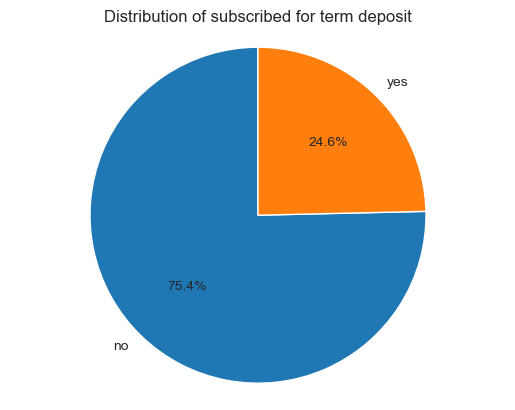

In [10]:
subscribed_counts = df['subscribed'].value_counts()
explode = [0.05] * len(subscribed_counts)

# Get the labels and sizes for the pie chart
labels = subscribed_counts.index
sizes = subscribed_counts.values

# Create the pie chart using matplotlib
plt.pie(sizes, labels=labels, autopct='%1.1f%%', startangle=90)

# Aspect ratio to make the pie circular
plt.axis('equal')

# Add a title
plt.title('Distribution of subscribed for term deposit')

# Show the pie chart
plt.show()

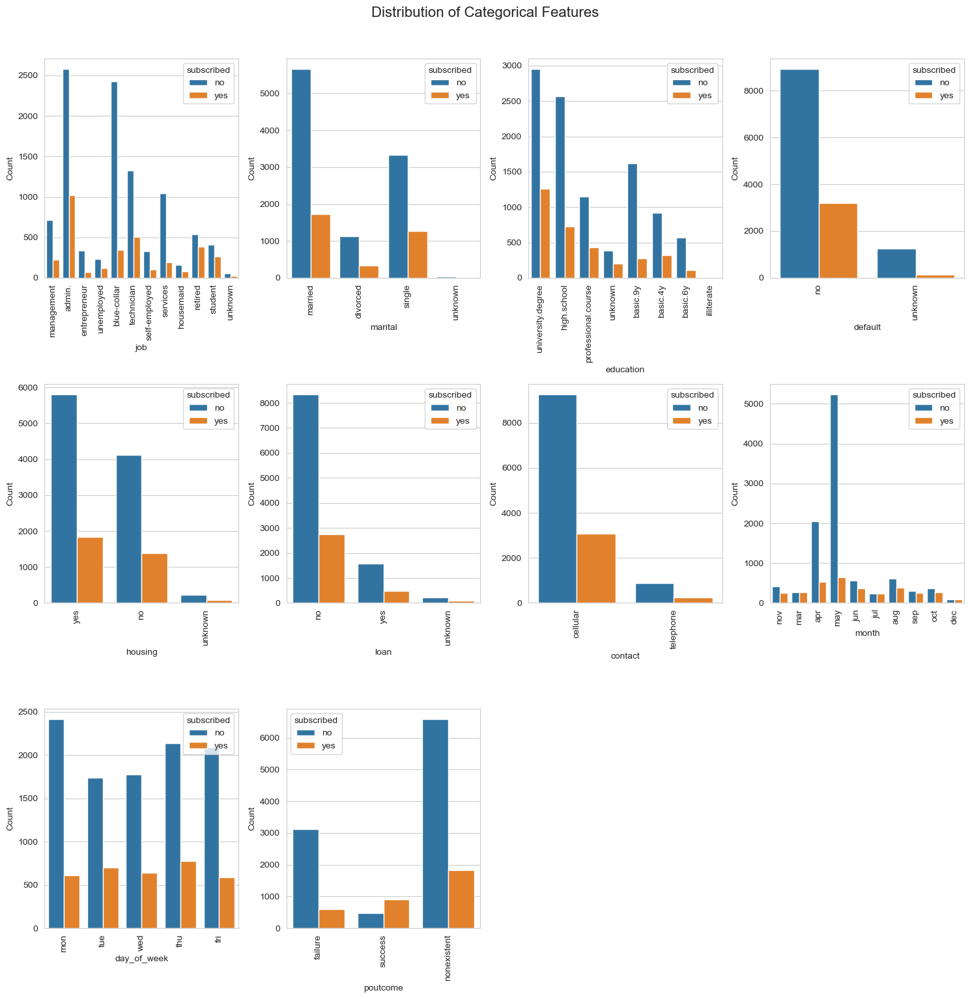

In [11]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
df_subset = df[[Target]+categorical_features]

# Determine the number of rows and columns for subplots
num_plots_per_row = 4
num_rows = (len(categorical_features) + num_plots_per_row - 1) // num_plots_per_row

# Create subplots for each categorical feature
fig, axs = plt.subplots(num_rows, num_plots_per_row, figsize=(15, 5*num_rows))

for i, feature in enumerate(categorical_features):
    # Calculate the row and column indices for the current subplot
    row_idx = i // num_plots_per_row
    col_idx = i % num_plots_per_row

    # Create a count plot for the current categorical feature
    sns.countplot(x=feature, data=df_subset, hue='subscribed', ax=axs[row_idx, col_idx])
    axs[row_idx, col_idx].set_xlabel(feature)
    axs[row_idx, col_idx].set_ylabel('Count')
    axs[row_idx, col_idx].tick_params(axis='x', rotation=90)
# Set the main title at the top
plt.suptitle('Distribution of Categorical Features', fontsize=16,y=1.02)

# Hide any empty subplots
for i in range(len(categorical_features), num_plots_per_row*num_rows):
    row_idx = i // num_plots_per_row
    col_idx = i % num_plots_per_row
    axs[row_idx, col_idx].axis('off')

plt.tight_layout()
plt.show()

# split train and test

In [12]:
# define X and y
X = df[predictors].drop(columns='duration') #duration: this attribute highly affects the output target 
#(e.g., if duration=0 then y='no'). Yet, the duration is not known before a call is performed. 
#Also, after the end of the call y is obviously known. 
#Thus, this input should be discarded if the intention is to have a realistic predictive model.

# Cobvert target label to numerical Data
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
df[Target] = le.fit_transform(df[Target])

y = df[Target]
display(X)
display(y)

from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size = 0.2, random_state=42, stratify=y)
print(f"X_train.shape: {X_train.shape}")
print(f"X_test.shape: {X_test.shape}")
print(f"y_train.shape: {y_train.shape}")
print(f"y_test.shape: {y_test.shape}")

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,campaign,pdays,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,cluster
0,44,management,married,university.degree,no,yes,no,cellular,nov,mon,1,999,1,failure,-0.1,93.200,-42.0,4.191,5195.8,0
1,52,admin.,married,university.degree,no,yes,yes,cellular,nov,mon,1,999,1,failure,-0.1,93.200,-42.0,4.191,5195.8,0
2,41,entrepreneur,married,university.degree,no,yes,no,cellular,nov,mon,1,999,1,failure,-0.1,93.200,-42.0,4.191,5195.8,0
3,36,unemployed,divorced,high.school,no,yes,yes,cellular,nov,mon,1,999,1,failure,-0.1,93.200,-42.0,4.191,5195.8,0
4,39,admin.,married,university.degree,no,yes,no,cellular,nov,mon,1,999,1,failure,-0.1,93.200,-42.0,4.191,5195.8,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13475,73,retired,married,professional.course,no,yes,no,cellular,nov,fri,1,999,0,nonexistent,-1.1,94.767,-50.8,1.028,4963.6,0
13476,46,blue-collar,married,professional.course,no,no,no,cellular,nov,fri,1,999,0,nonexistent,-1.1,94.767,-50.8,1.028,4963.6,0
13477,56,retired,married,university.degree,no,yes,no,cellular,nov,fri,2,999,0,nonexistent,-1.1,94.767,-50.8,1.028,4963.6,0
13478,44,technician,married,professional.course,no,no,no,cellular,nov,fri,1,999,0,nonexistent,-1.1,94.767,-50.8,1.028,4963.6,0


0        0
1        0
2        0
3        0
4        0
        ..
13475    1
13476    0
13477    0
13478    1
13479    0
Name: subscribed, Length: 13480, dtype: int64

X_train.shape: (10784, 20)
X_test.shape: (2696, 20)
y_train.shape: (10784,)
y_test.shape: (2696,)


### Define the  Pipeline

In [13]:
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import MinMaxScaler, OneHotEncoder
numerical_features= ['age','campaign', 'pdays', 'previous', 'emp.var.rate', 'cons.price.idx', 
                     'cons.conf.idx', 'euribor3m', 'nr.employed']

# Define pipeline for categorical features
pipeline_categorical = Pipeline([('onehot', OneHotEncoder(handle_unknown='ignore'))])

# Define pipeline for numerical features
pipeline_numerical = Pipeline([('scaler', MinMaxScaler(feature_range=(0, 1)))])

pipeline_full = ColumnTransformer([
    ('categorical', pipeline_categorical, categorical_features),
    ('numerical', pipeline_numerical, numerical_features)
])

pipeline_full

ColumnTransformer(transformers=[('categorical',
                                 Pipeline(steps=[('onehot',
                                                  OneHotEncoder(handle_unknown='ignore'))]),
                                 ['job', 'marital', 'education', 'default',
                                  'housing', 'loan', 'contact', 'month',
                                  'day_of_week', 'poutcome']),
                                ('numerical',
                                 Pipeline(steps=[('scaler', MinMaxScaler())]),
                                 ['age', 'campaign', 'pdays', 'previous',
                                  'emp.var.rate', 'cons.price.idx',
                                  'cons.conf.idx', 'euribor3m',
                                  'nr.employed'])])

In [14]:
print(X_train.columns)

Index(['age', 'job', 'marital', 'education', 'default', 'housing', 'loan',
       'contact', 'month', 'day_of_week', 'campaign', 'pdays', 'previous',
       'poutcome', 'emp.var.rate', 'cons.price.idx', 'cons.conf.idx',
       'euribor3m', 'nr.employed', 'cluster'],
      dtype='object')


In [15]:
# Fit the pipeline on the training data and transform both training and test data
pipeline_full.fit(X_train)
X_train_transformed = pipeline_full.transform(X_train)
X_test_transformed = pipeline_full.transform(X_test)

# Print the shapes of the transformed datasets
print(f'X_train_transformed.shape:{X_train_transformed.shape}')
print(f'X_test_transformed.shape:{X_test_transformed.shape}')

X_train_transformed.shape:(10784, 61)
X_test_transformed.shape:(2696, 61)


### Build Models

In [16]:
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
from imblearn.ensemble import BalancedBaggingClassifier
from imblearn.ensemble import BalancedRandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from lightgbm import LGBMClassifier
import xgboost as xgb
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score

models = {
    "Random Forest": BalancedRandomForestClassifier(random_state=42),
    "Decision Tree": DecisionTreeClassifier(random_state=42),
    "LightGBM": LGBMClassifier(random_state=42),
    "XGBoost": xgb.XGBClassifier(random_state=42),
    "KNN": KNeighborsClassifier(),
    "Logistic Regression": LogisticRegression(random_state=42),
    "Bagging": BalancedBaggingClassifier(random_state=42)
}

# list of model metrics
results =[]

for name, model in models.items():
    model.fit(X_train_transformed, y_train)
    y_pred = model.predict(X_test_transformed)
    accuracy = accuracy_score(y_test, model.predict(X_test_transformed))
    precision= precision_score(y_test, model.predict(X_test_transformed))
    recall = recall_score(y_test, model.predict(X_test_transformed))
    F1_s = f1_score(y_test, model.predict(X_test_transformed))
    AUC = roc_auc_score(y_test, model.predict_proba(X_test_transformed)[:,1])

    results.append({'Model':name,
               'Accuracy':accuracy,
               'AUC':AUC,
                'precision_score':precision,
                'recall_score':recall,
                'F1_score':F1_s})

# Convert results to DataFrame
results_df = pd.DataFrame(results)
print(results_df)

/Users/Ann/anaconda3/lib/python3.10/site-packages/imblearn/ensemble/_forest.py:546: FutureWarning: The default of `sampling_strategy` will change from `'auto'` to `'all'` in version 0.13. This change will follow the implementation proposed in the original paper. Set to `'all'` to silence this warning and adopt the future behaviour.
  warn(
/Users/Ann/anaconda3/lib/python3.10/site-packages/imblearn/ensemble/_forest.py:558: FutureWarning: The default of `replacement` will change from `False` to `True` in version 0.13. This change will follow the implementation proposed in the original paper. Set to `True` to silence this warning and adopt the future behaviour.
  warn(
/Users/Ann/anaconda3/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing

                 Model  Accuracy       AUC  precision_score  recall_score  \
0        Random Forest  0.718472  0.795117         0.456221      0.745482   
1        Decision Tree  0.721439  0.625310         0.433384      0.426205   
2             LightGBM  0.788576  0.807723         0.621762      0.361446   
3              XGBoost  0.777077  0.783847         0.571754      0.378012   
4                  KNN  0.771142  0.722684         0.556627      0.347892   
5  Logistic Regression  0.795623  0.792175         0.680511      0.320783   
6              Bagging  0.747033  0.767795         0.488889      0.596386   

   F1_score  
0  0.566038  
1  0.429765  
2  0.457143  
3  0.455122  
4  0.428174  
5  0.436029  
6  0.537313  


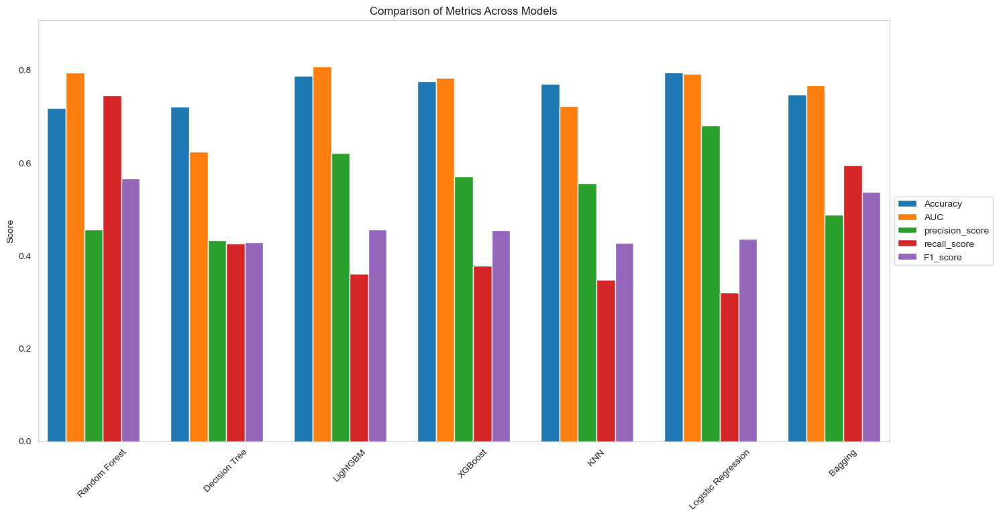

In [62]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming results_df has already been created as in your code
metrics = ['Accuracy', 'AUC', 'precision_score', 'recall_score', 'F1_score']

# Setting the positions and width for the bars
pos = list(range(len(results_df['Accuracy'])))
width = 0.15

# Plotting each metric
fig, ax = plt.subplots(figsize=(15,7))

for index, metric in enumerate(metrics):
    plt.bar([p + width*index for p in pos], 
            results_df[metric], 
            width=width, 
            label=metric)

# Setting the labels and titles
ax.set_ylabel('Score')
ax.set_title('Comparison of Metrics Across Models')
ax.set_xticks([p + 2.5*width for p in pos])
ax.set_xticklabels(results_df['Model'])
plt.xlim(min(pos)-width, max(pos)+width*len(metrics))
ymax = results_df[metrics].values.max() + 0.1
plt.ylim([0, ymax])


# Adding the legend and showing the plot

plt.legend(metrics, loc='center left', bbox_to_anchor=(1, 0.5))
plt.grid()
plt.tight_layout()
plt.xticks(rotation=45)
plt.show()



Since the Random Forest has relatively high AUC (the model is capable to distinguish the customers willsubscribe or not) and the highest recall_score(the model correctly identified most of the positive cases) and F1_Score, although we have higher AUC for LightGBM model, it has lower recall-score, which predicts only .36% customers who are actually subscribed term deposit. therefore,we will focus on Random forest. Because we don't want to lose revenue and want to make sure we identify as many potential subscribers as possible.  However, to control the cost of marketing campaign,improving precision score should also be taken into consideration.

### Hyperparameter Tuning

/Users/Ann/anaconda3/lib/python3.10/site-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
115 fits failed out of a total of 500.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
80 fits failed with the following error:
Traceback (most recent call last):
  File "/Users/Ann/anaconda3/lib/python3.10/site-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/Users/Ann/anaconda3/lib/python3.10/site-packages/imblearn/utils/fixes.py", line 85, in wrapper
    return fit_method(estimator, *args, **kwargs)
  File "/Users/Ann/anaconda3/lib/python3.10/site-packages/imblearn/ensemble/_forest.py", line 676, in fit
    samplers_trees = Parallel(
  F

Best Hyperparameters: {'sampling_strategy': 'auto', 'replacement': True, 'n_estimators': 136, 'min_samples_split': 9, 'min_samples_leaf': 13, 'max_features': 0.8, 'max_depth': 9}
Best Accuracy: 0.736702723314908
Confusion Matrix for Random Forest Model:
 [[1439  593]
 [ 139  525]]
Classification Report for Random Forest Model:
               precision    recall  f1-score   support

           0       0.91      0.71      0.80      2032
           1       0.47      0.79      0.59       664

    accuracy                           0.73      2696
   macro avg       0.69      0.75      0.69      2696
weighted avg       0.80      0.73      0.75      2696

AUC Score of the RF: 0.8100449287306707


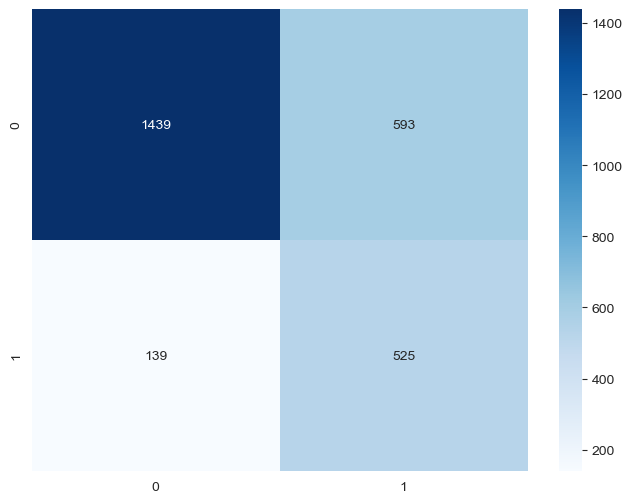

In [17]:
import numpy as np
from imblearn.ensemble import BalancedRandomForestClassifier
from sklearn.model_selection import RandomizedSearchCV
from sklearn.metrics import accuracy_score, roc_auc_score, confusion_matrix, classification_report
import seaborn as sns
import matplotlib.pyplot as plt

# Define the RandomForestClassifier
brf = BalancedRandomForestClassifier(random_state=42)

# Define the hyperparameter search space
param_dist = {
    'n_estimators': range(100, 150),
    'max_depth': [None] + list(range(1, 20)),
    'min_samples_split': range(2, 20),
    'min_samples_leaf': range(1, 20),
    'max_features': ['auto', 'sqrt', 'log2'] + list(np.arange(0.1, 1.1, 0.1)),
    'sampling_strategy': ['auto', 'majority', 'not minority'] + list(np.arange(0.1, 1.1, 0.1)),
    'replacement': [True, False]
}

# Create a RandomizedSearchCV to perform hyperparameter tuning
random_search = RandomizedSearchCV(
    brf, param_distributions=param_dist,
    n_iter=100, n_jobs=-1, cv=5,
    scoring='balanced_accuracy', random_state=42
)

# Fit the RandomizedSearchCV object to the data
random_search.fit(X_train_transformed, y_train)

# Print the best hyperparameters and the corresponding accuracy
print('Best Hyperparameters:', random_search.best_params_)
print('Best Accuracy:', random_search.best_score_)

# Make predictions on the test set using the best estimator found during the search
y_pred = random_search.best_estimator_.predict(X_test_transformed)

# Evaluate the model's performance
cm = confusion_matrix(y_test, y_pred)
print("Confusion Matrix for Random Forest Model:\n", cm)
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues")
print("Classification Report for Random Forest Model:\n", classification_report(y_test, y_pred))

# Evaluate the model's performance
y_prob = random_search.best_estimator_.predict_proba(X_test_transformed)[:, 1]

print("AUC Score of the RF:", roc_auc_score(y_test, y_prob))

In [18]:
import optuna
from imblearn.ensemble import BalancedRandomForestClassifier
from sklearn.metrics import roc_auc_score
from sklearn.model_selection import StratifiedKFold, cross_val_predict

def objective(trial):
    n_estimators = trial.suggest_int('n_estimators', 100, 150)
    max_depth = trial.suggest_int('max_depth', 5, 100, step=5)  
    min_samples_split = trial.suggest_int('min_samples_split', 5, 100, step=5)
    min_samples_leaf = trial.suggest_int('min_samples_leaf', 5, 100, step=5)
    max_leaf_nodes = trial.suggest_int('max_leaf_nodes', 10, 1010, step=100)  
    sampling_strategy = trial.suggest_categorical('sampling_strategy', ['auto', 'majority', 'not minority'])
    replacement = trial.suggest_categorical('replacement', [True, False])
    class_weight = trial.suggest_categorical('class_weight', ['balanced', None])

    clf = BalancedRandomForestClassifier(
        n_estimators=n_estimators,
        max_depth=max_depth,
        min_samples_split=min_samples_split,
        min_samples_leaf=min_samples_leaf,
        max_leaf_nodes=max_leaf_nodes,
        sampling_strategy=sampling_strategy,
        replacement=replacement,
        random_state=42,
        n_jobs=-1,
        class_weight=class_weight
    )

    # Use StratifiedKFold for imbalanced datasets
    stratified_kfold = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
    
    # Get the probabilities of the positive class
    y_prob = cross_val_predict(clf, X_train_transformed, y_train, cv=stratified_kfold, method='predict_proba')[:, 1]
    
    # Compute ROC-AUC score
    return roc_auc_score(y_train, y_prob)

study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=100)

# Results
print('Number of finished trials: ', len(study.trials))
print('Best trial:')
trial = study.best_trial

print('Value: ', trial.value)
print('Params: ')
for key, value in trial.params.items():
    print(f'    {key}: {value}')

# Fit the model with the best hyperparameters
best_params = trial.params
brf_best = BalancedRandomForestClassifier(**best_params, random_state=42, n_jobs=-1)
brf_best.fit(X_train_transformed, y_train)

[I 2023-10-04 21:54:45,581] A new study created in memory with name: no-name-c86df512-530b-47db-889a-75837d95aafa
[I 2023-10-04 21:54:47,336] Trial 0 finished with value: 0.7802535760978139 and parameters: {'n_estimators': 115, 'max_depth': 5, 'min_samples_split': 45, 'min_samples_leaf': 30, 'max_leaf_nodes': 310, 'sampling_strategy': 'majority', 'replacement': True, 'class_weight': None}. Best is trial 0 with value: 0.7802535760978139.
[I 2023-10-04 21:54:49,132] Trial 1 finished with value: 0.7907332639326232 and parameters: {'n_estimators': 114, 'max_depth': 75, 'min_samples_split': 10, 'min_samples_leaf': 25, 'max_leaf_nodes': 910, 'sampling_strategy': 'auto', 'replacement': False, 'class_weight': 'balanced'}. Best is trial 1 with value: 0.7907332639326232.
[I 2023-10-04 21:54:51,008] Trial 2 finished with value: 0.779950405305982 and parameters: {'n_estimators': 120, 'max_depth': 5, 'min_samples_split': 70, 'min_samples_leaf': 20, 'max_leaf_nodes': 410, 'sampling_strategy': 'major

[I 2023-10-04 21:55:37,574] Trial 25 finished with value: 0.7928013689713806 and parameters: {'n_estimators': 100, 'max_depth': 40, 'min_samples_split': 75, 'min_samples_leaf': 15, 'max_leaf_nodes': 910, 'sampling_strategy': 'not minority', 'replacement': True, 'class_weight': 'balanced'}. Best is trial 11 with value: 0.7959621901819345.
[I 2023-10-04 21:55:39,700] Trial 26 finished with value: 0.7939570903921325 and parameters: {'n_estimators': 140, 'max_depth': 55, 'min_samples_split': 85, 'min_samples_leaf': 5, 'max_leaf_nodes': 1010, 'sampling_strategy': 'not minority', 'replacement': True, 'class_weight': None}. Best is trial 11 with value: 0.7959621901819345.
[I 2023-10-04 21:55:41,718] Trial 27 finished with value: 0.7864810695508019 and parameters: {'n_estimators': 134, 'max_depth': 70, 'min_samples_split': 60, 'min_samples_leaf': 35, 'max_leaf_nodes': 510, 'sampling_strategy': 'not minority', 'replacement': True, 'class_weight': 'balanced'}. Best is trial 11 with value: 0.7959

[I 2023-10-04 21:56:31,911] Trial 50 finished with value: 0.7949055266277871 and parameters: {'n_estimators': 147, 'max_depth': 55, 'min_samples_split': 60, 'min_samples_leaf': 10, 'max_leaf_nodes': 710, 'sampling_strategy': 'not minority', 'replacement': True, 'class_weight': 'balanced'}. Best is trial 11 with value: 0.7959621901819345.
[I 2023-10-04 21:56:34,112] Trial 51 finished with value: 0.7952796217406594 and parameters: {'n_estimators': 144, 'max_depth': 20, 'min_samples_split': 65, 'min_samples_leaf': 5, 'max_leaf_nodes': 810, 'sampling_strategy': 'not minority', 'replacement': True, 'class_weight': 'balanced'}. Best is trial 11 with value: 0.7959621901819345.
[I 2023-10-04 21:56:36,324] Trial 52 finished with value: 0.7954165151738914 and parameters: {'n_estimators': 144, 'max_depth': 20, 'min_samples_split': 70, 'min_samples_leaf': 5, 'max_leaf_nodes': 810, 'sampling_strategy': 'not minority', 'replacement': True, 'class_weight': 'balanced'}. Best is trial 11 with value: 0.

[I 2023-10-04 21:57:25,639] Trial 75 finished with value: 0.7932601194279428 and parameters: {'n_estimators': 138, 'max_depth': 45, 'min_samples_split': 5, 'min_samples_leaf': 15, 'max_leaf_nodes': 110, 'sampling_strategy': 'auto', 'replacement': True, 'class_weight': None}. Best is trial 11 with value: 0.7959621901819345.
[I 2023-10-04 21:57:27,794] Trial 76 finished with value: 0.7917275474277163 and parameters: {'n_estimators': 137, 'max_depth': 40, 'min_samples_split': 20, 'min_samples_leaf': 20, 'max_leaf_nodes': 410, 'sampling_strategy': 'not minority', 'replacement': False, 'class_weight': None}. Best is trial 11 with value: 0.7959621901819345.
[I 2023-10-04 21:57:30,015] Trial 77 finished with value: 0.7817037156517774 and parameters: {'n_estimators': 141, 'max_depth': 50, 'min_samples_split': 25, 'min_samples_leaf': 60, 'max_leaf_nodes': 210, 'sampling_strategy': 'not minority', 'replacement': True, 'class_weight': None}. Best is trial 11 with value: 0.7959621901819345.
[I 202

Number of finished trials:  100
Best trial:
Value:  0.7982606198114159
Params: 
    n_estimators: 143
    max_depth: 40
    min_samples_split: 15
    min_samples_leaf: 5
    max_leaf_nodes: 310
    sampling_strategy: not minority
    replacement: True
    class_weight: None


BalancedRandomForestClassifier(max_depth=40, max_leaf_nodes=310,
                               min_samples_leaf=5, min_samples_split=15,
                               n_estimators=143, n_jobs=-1, random_state=42,
                               replacement=True,
                               sampling_strategy='not minority')

Confusion Matrix for Random Forest Model:
 [[1423  609]
 [ 134  530]]


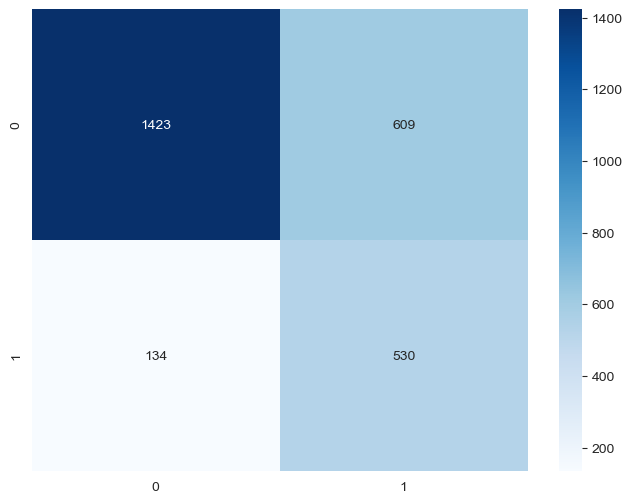

Classification Report for Random Forest Model:
               precision    recall  f1-score   support

           0       0.91      0.70      0.79      2032
           1       0.47      0.80      0.59       664

    accuracy                           0.72      2696
   macro avg       0.69      0.75      0.69      2696
weighted avg       0.80      0.72      0.74      2696

AUC Score of the RF: 0.8100449287306707


In [30]:
# Make predictions on the test set using the best model
y_pred = brf_best.predict(X_test_transformed)

# Compute and print the confusion matrix
cm = confusion_matrix(y_test, y_pred)
print("Confusion Matrix for Random Forest Model:\n", cm)

# Visualize the confusion matrix using seaborn heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues")
plt.show()

# Print the classification report
print("Classification Report for Random Forest Model:\n", classification_report(y_test, y_pred))
print("AUC Score of the RF:", roc_auc_score(y_test, y_prob))

AUC improved from 0.7184 to 0.8100, f1-score improved from 0.56 to 0.59, precision improved from 0.46 to 0.47, which will result in fewer false positive, therefore save cost of marketing campaign. and recall jumps to 80%,suggesting the model is identifying approximately 80% of the actual positive cases.

# Trade-off
While high recall(80%) is advantageous, this suggests that we are adeptly identifying 80% of those customers genuinely interested in subscribing, it’s important to note that this comes with a trade-off in precision. Lower precision implies that the model might be classifying many non-subscribers incorrectly, leading to increased marketing expenses as efforts are wasted on those who do not actually need intervention. In our model, specially in scenarios with imbalanced datasets, a precision nearing 50% is commendable. It signifies that nearly half of our targeted interventions will squarely land on those genuinely inclined towards term deposits

Thus, we need to strike a delicate balance. It is important to consider the Marketing Return on Investment (ROI) and assess the trade-off between the cost associated with losing subscribers and the increased expenditure of an expansive marketing campaign.

### Feature Importance

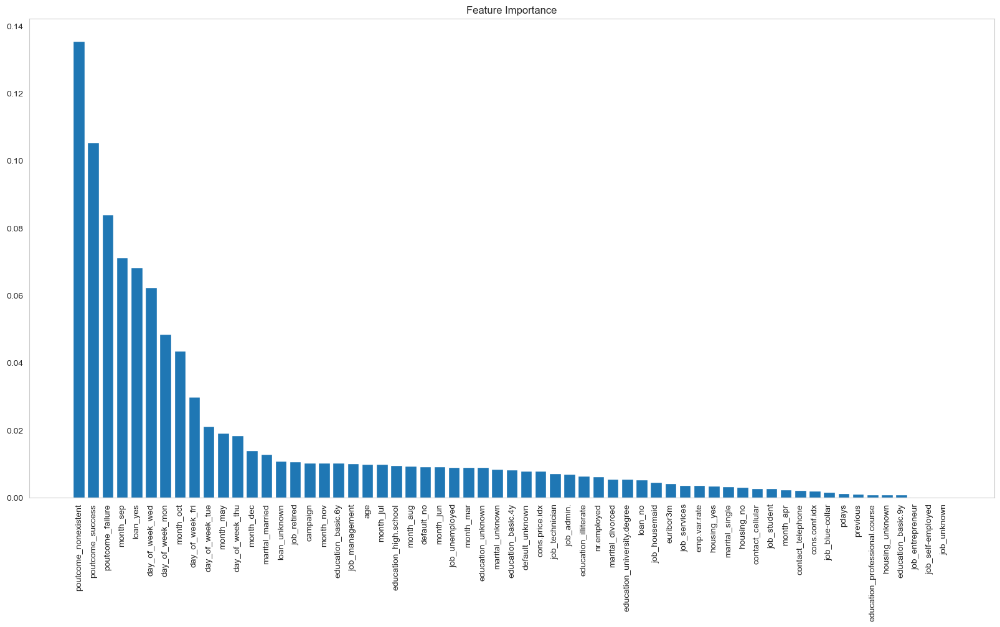

In [63]:
import numpy as np
import matplotlib.pyplot as plt
from imblearn.ensemble import BalancedRandomForestClassifier

# Balanced Random Forest model
final_brf = BalancedRandomForestClassifier(sampling_strategy= 'not minority', 
                                     replacement=True, n_estimators=143, min_samples_split=15, 
                                     min_samples_leaf=5, max_depth=40,max_leaf_nodes=310, random_state=42)
final_brf.fit(X_train_transformed, y_train)

importances = final_brf.feature_importances_


# Reconstructing feature names

transformed_feature_names = numerical_features.copy()

# categorical features
ohe_categories = pipeline_full.named_transformers_['categorical'].named_steps['onehot'].get_feature_names_out(categorical_features)
transformed_feature_names.extend(ohe_categories)

# Sort feature importances in descending order and get the indices
indices = np.argsort(importances)[::-1]

# Rearrange feature names so they match the sorted feature importances
names = [transformed_feature_names[i] for i in indices]

# Create a bar plot
plt.figure(figsize=(20, 10))
plt.bar(range(len(importances)), importances[indices])
plt.xticks(range(len(importances)), names, rotation=90)
plt.title("Feature Importance")
plt.grid(False)
plt.show()


### Visualize the trees

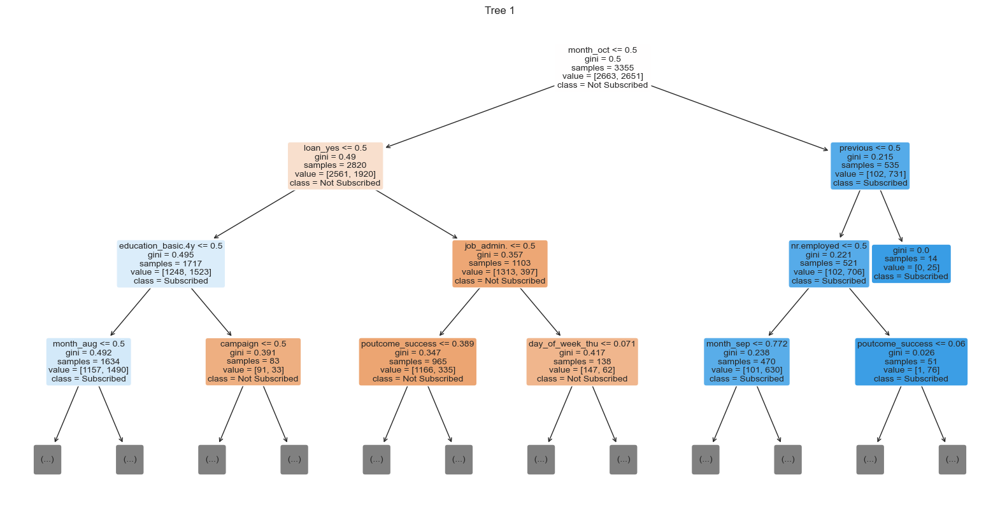

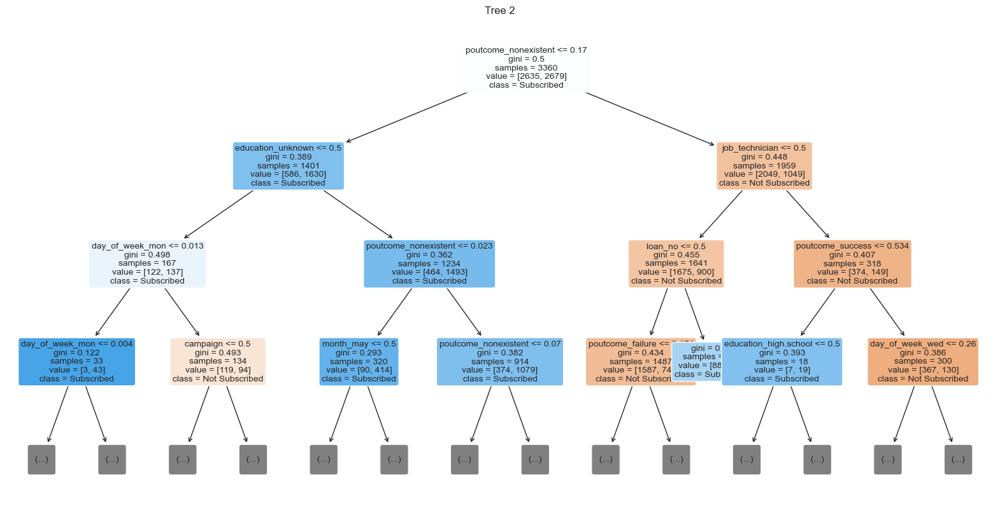

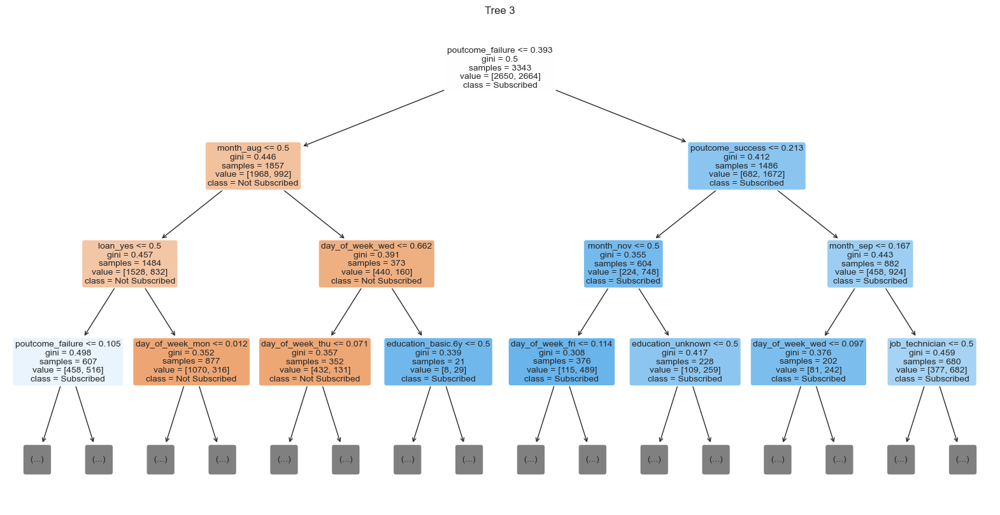

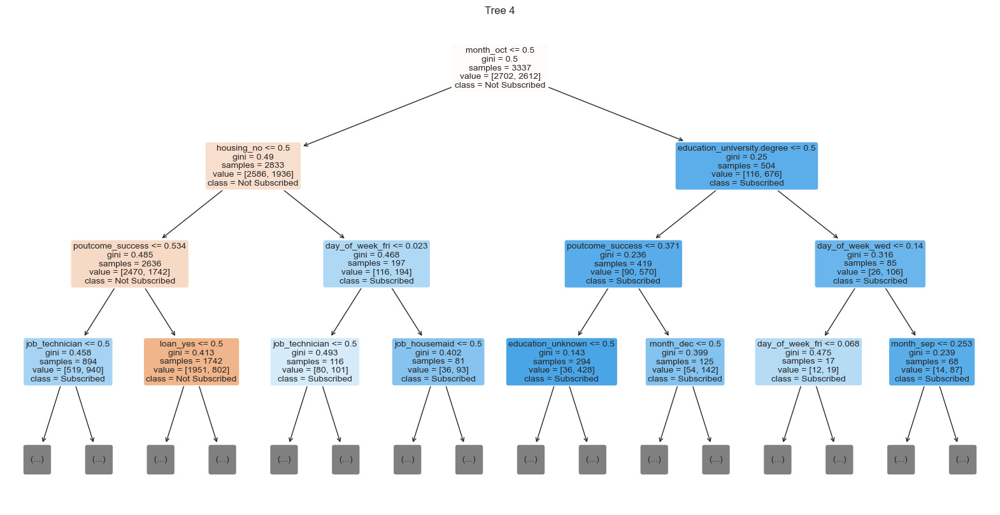

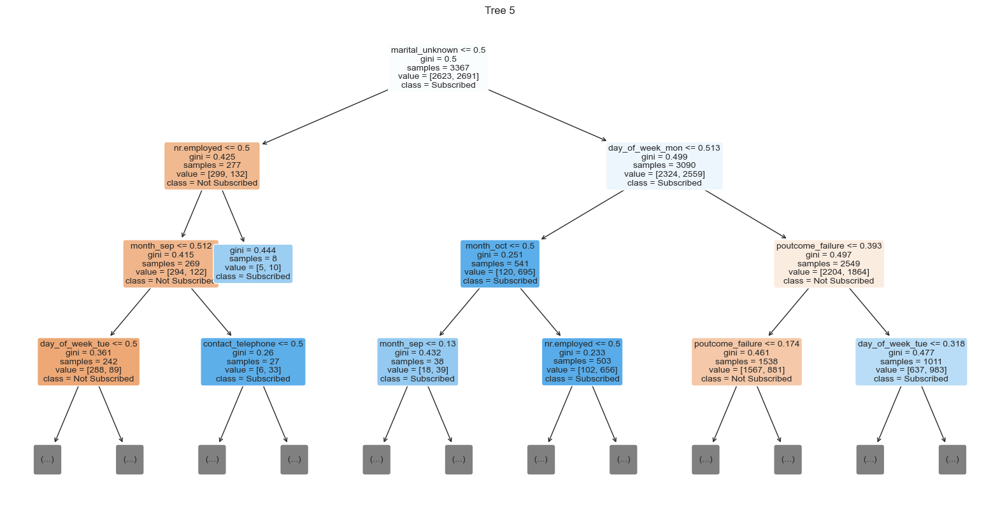

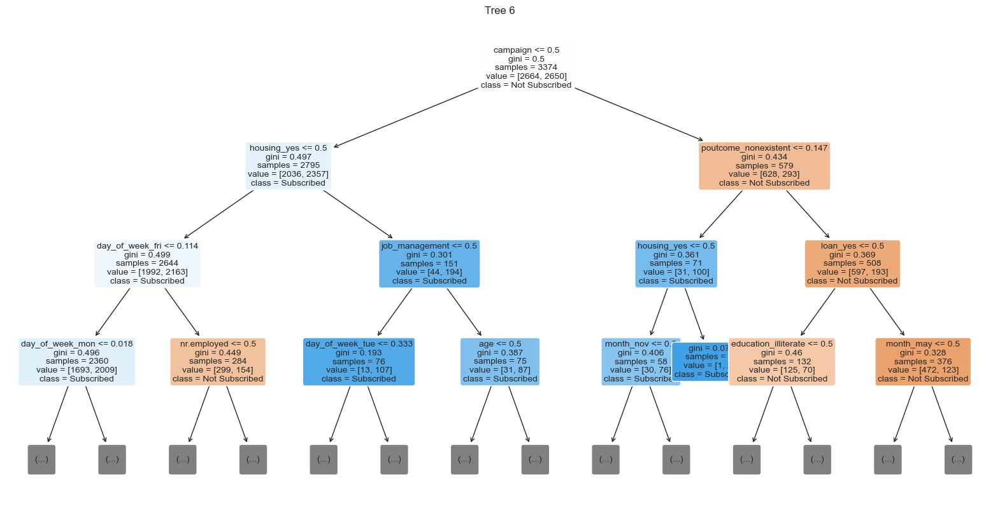

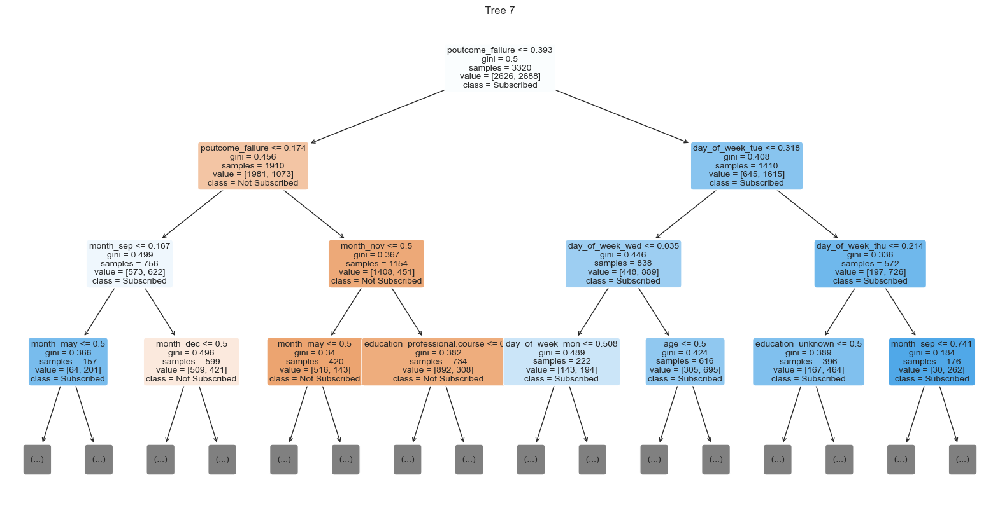

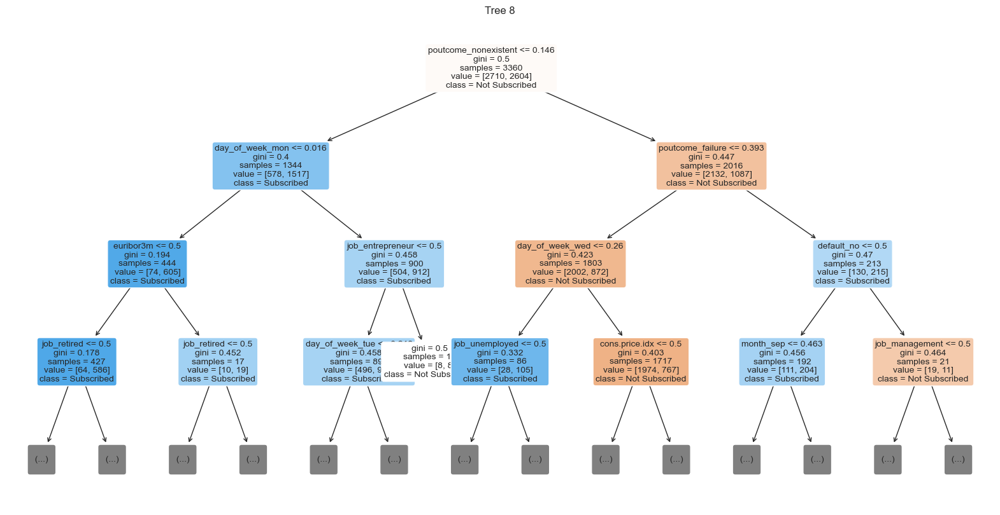

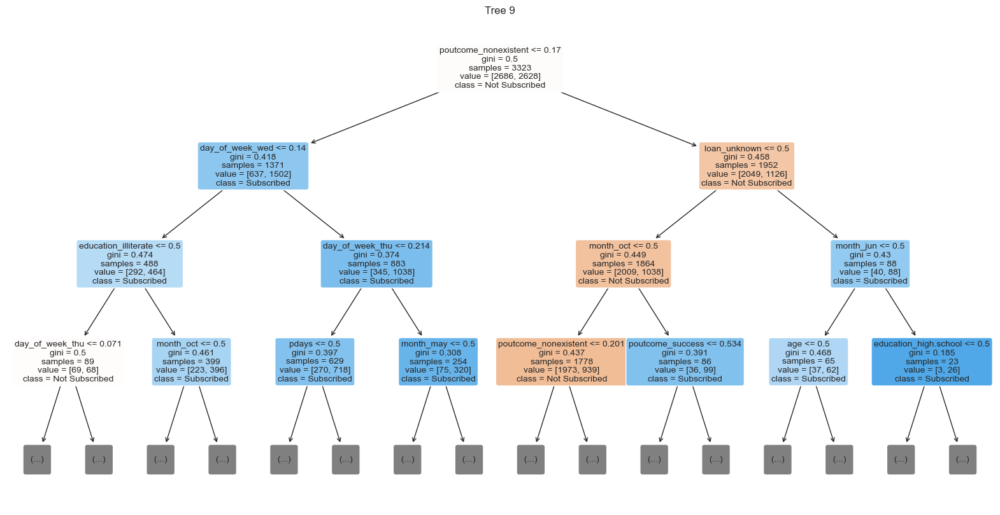

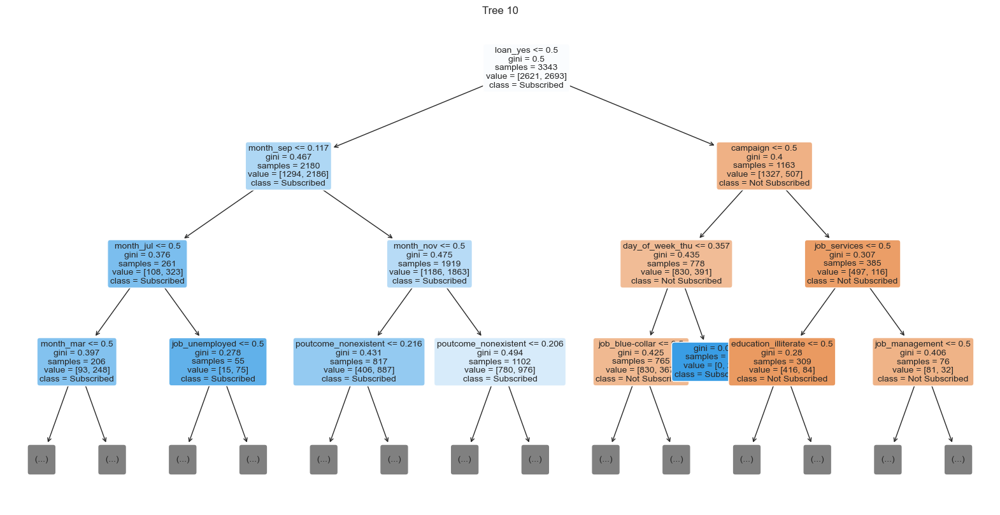

In [69]:
from sklearn.tree import plot_tree
import matplotlib.pyplot as plt
from imblearn.ensemble import BalancedRandomForestClassifier

# Number of trees to visualize
num_trees = 10

# Loop through the desired number of trees and plot them
for i in range(num_trees):
    chosen_tree = final_brf.estimators_[i]

    plt.figure(figsize=(20, 10))
    plot_tree(chosen_tree, feature_names=transformed_feature_names, class_names=['Not Subscribed', 'Subscribed'], 
              filled=True, rounded=True, fontsize=10, max_depth=3)
    plt.title(f"Tree {i+1}")
    plt.show()


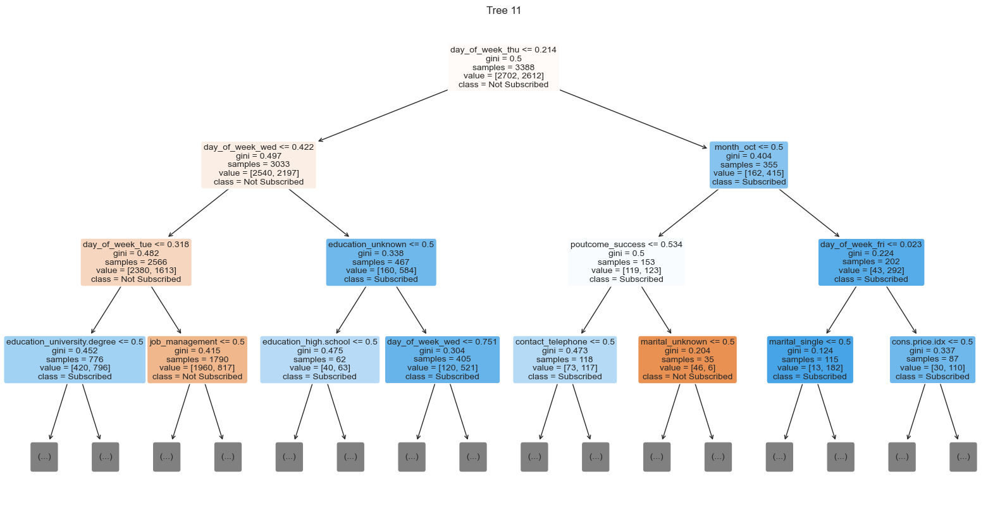

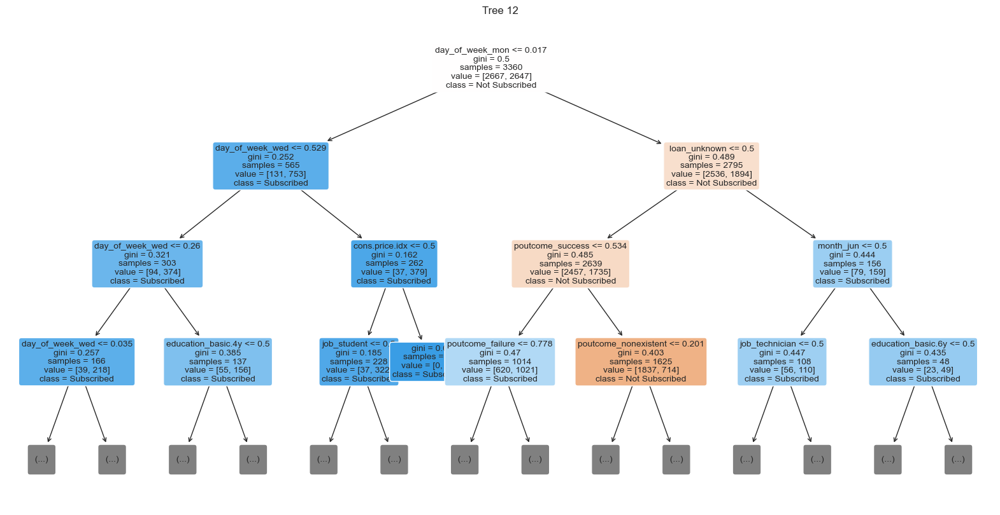

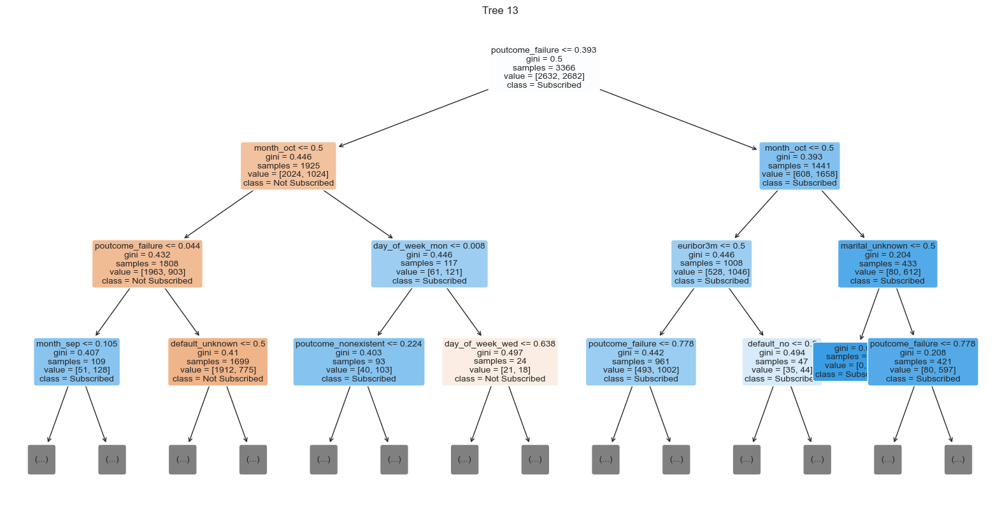

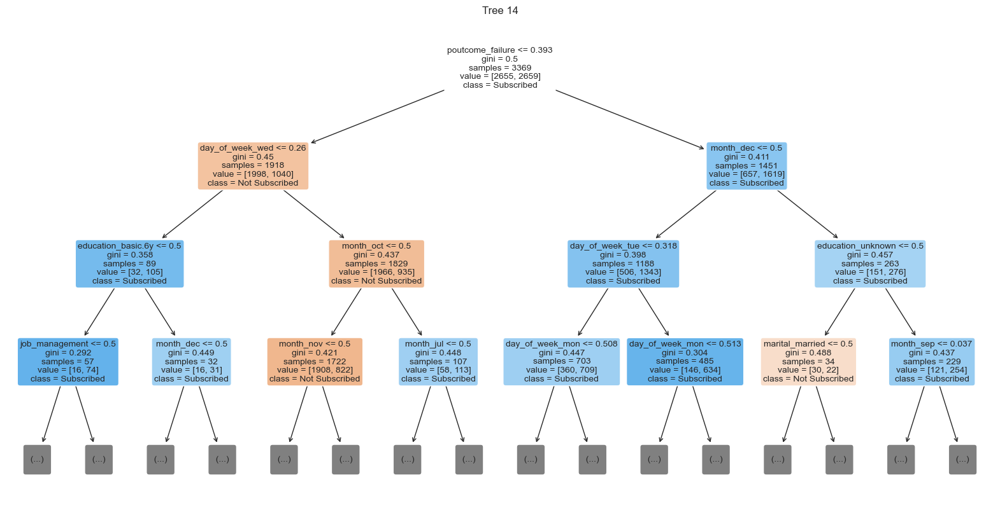

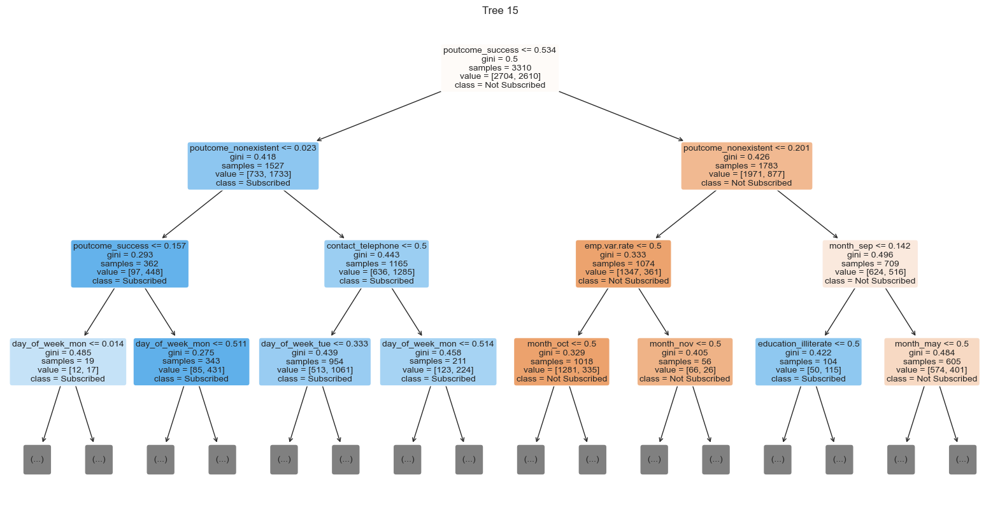

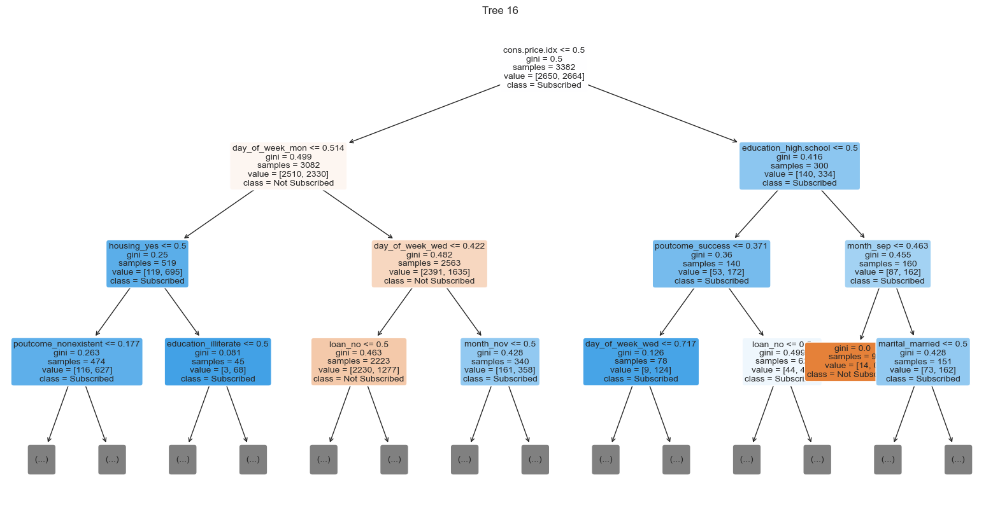

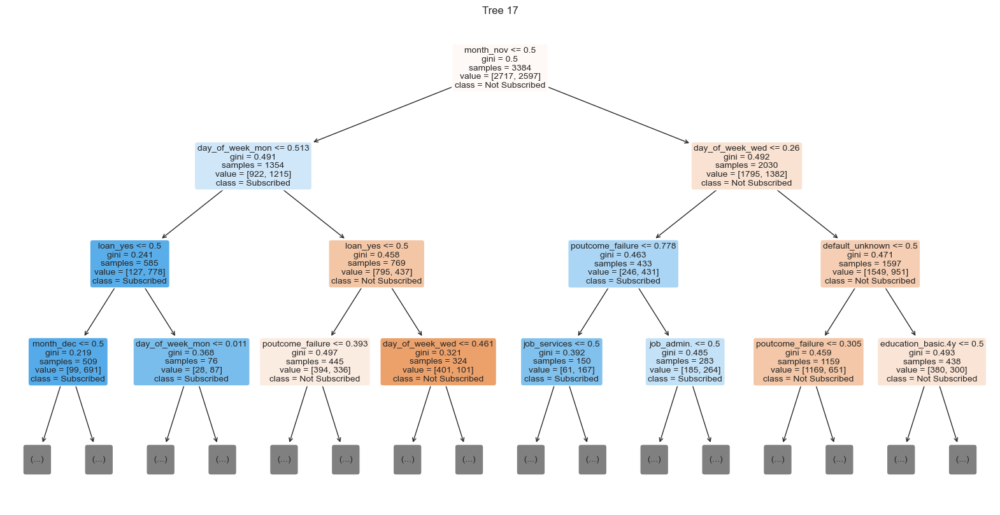

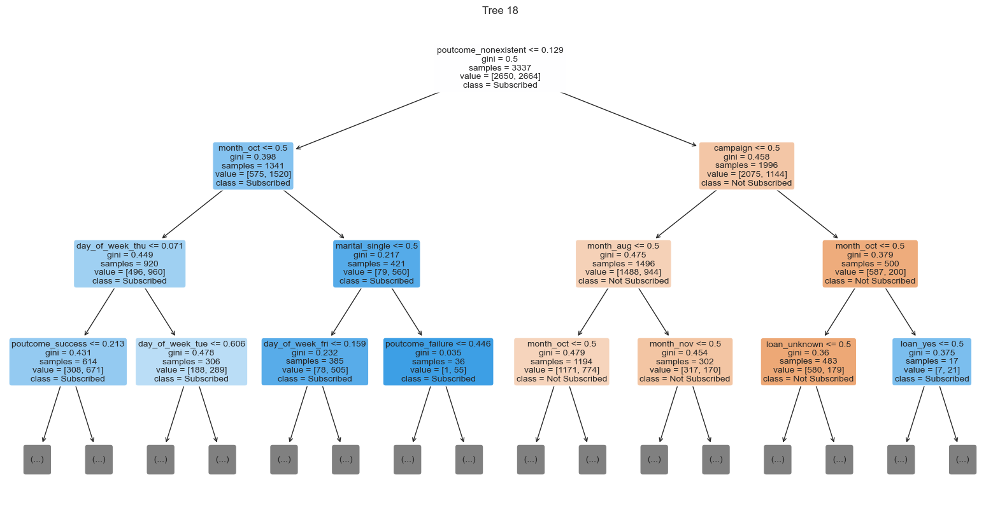

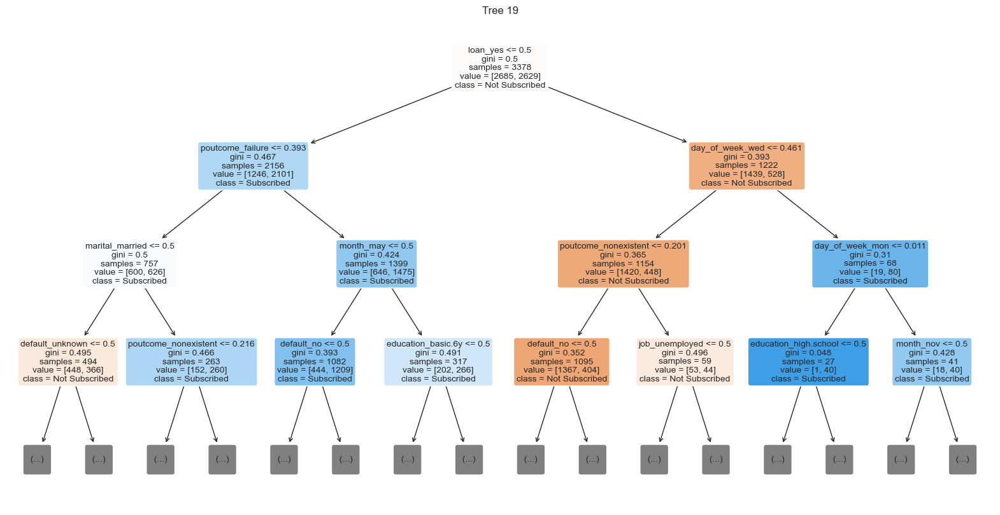

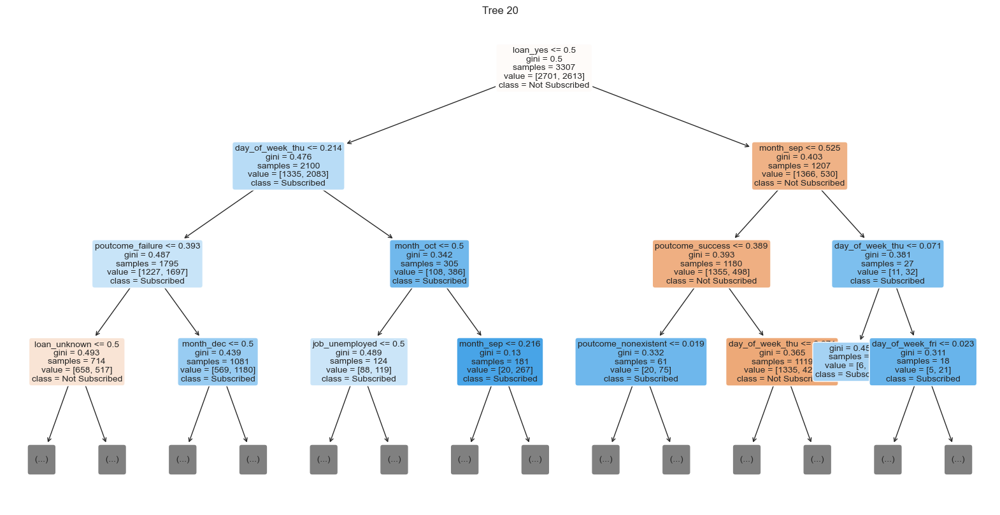

In [70]:
from sklearn.tree import plot_tree
import matplotlib.pyplot as plt
from imblearn.ensemble import BalancedRandomForestClassifier

# Define the range of trees to visualize
start_tree = 10  # 0-based index, so 10 refers to the 11th tree
end_tree = 20

# Loop through the desired range of trees and plot them
for i in range(start_tree, end_tree):
    chosen_tree = final_brf.estimators_[i]

    plt.figure(figsize=(20, 10))
    plot_tree(chosen_tree, feature_names=transformed_feature_names, class_names=['Not Subscribed', 'Subscribed'], 
              filled=True, rounded=True, fontsize=10, max_depth=3)
    plt.title(f"Tree {i+1}")
    plt.show()


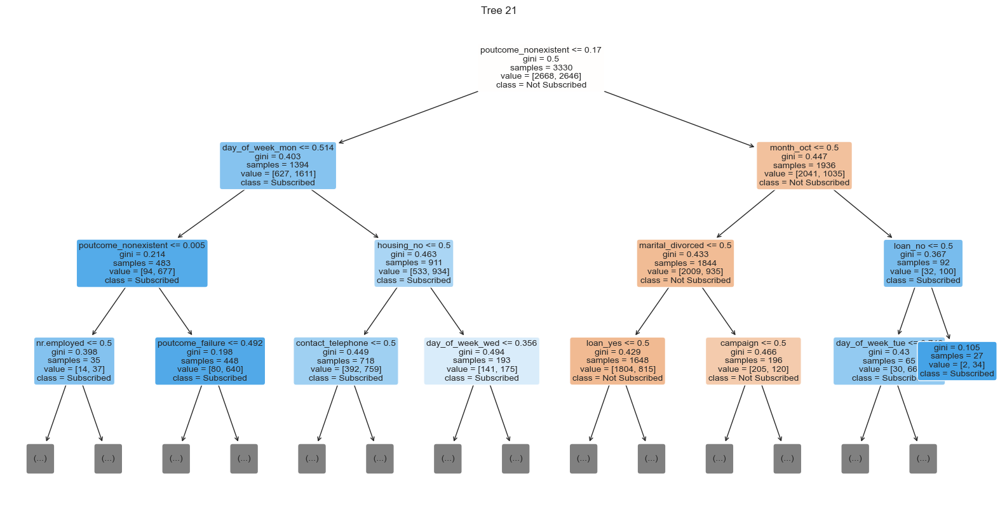

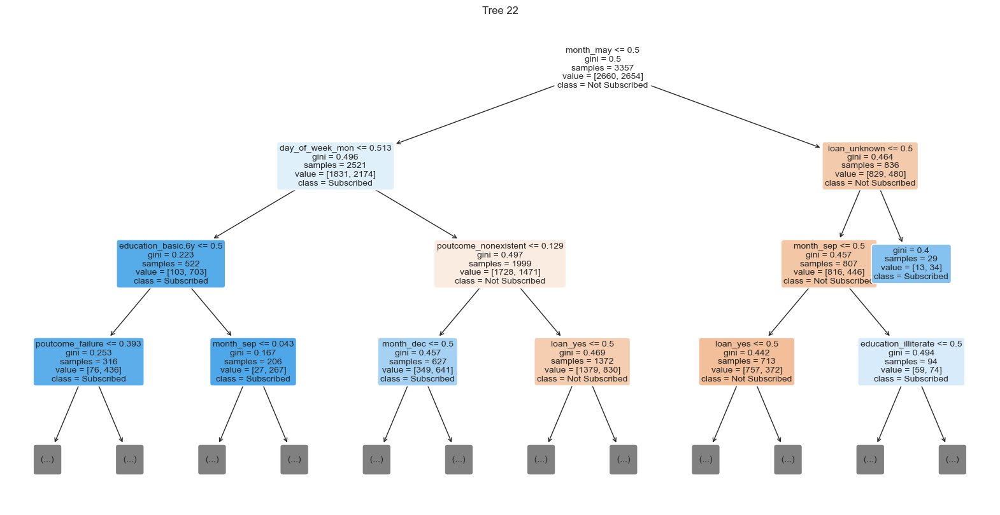

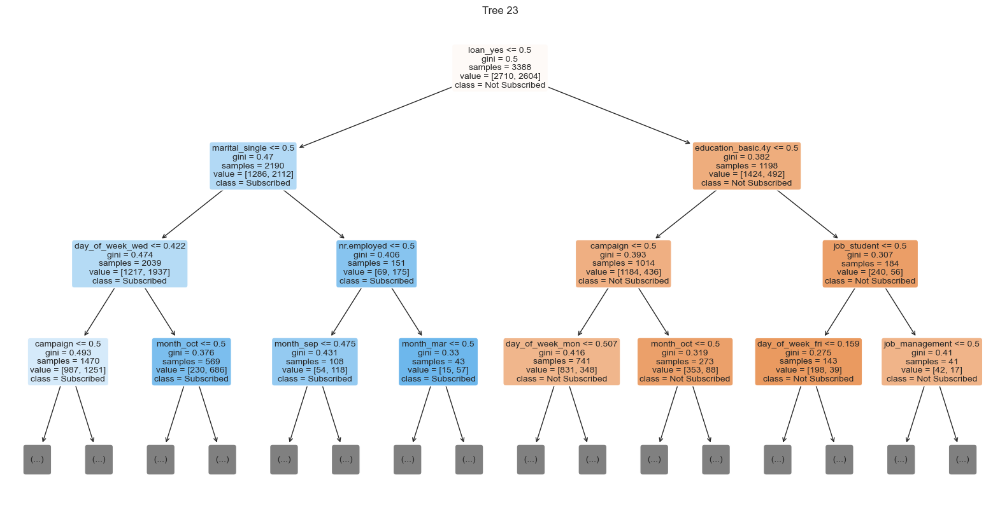

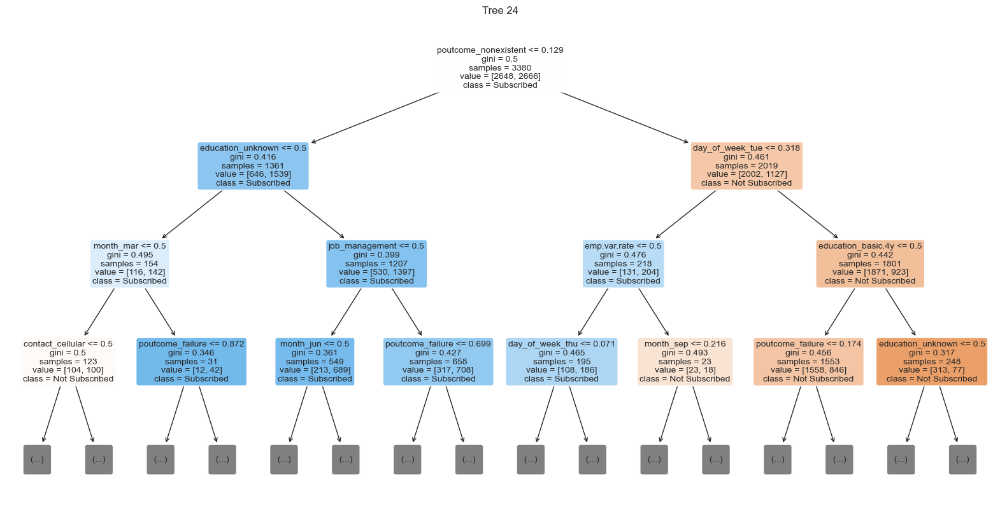

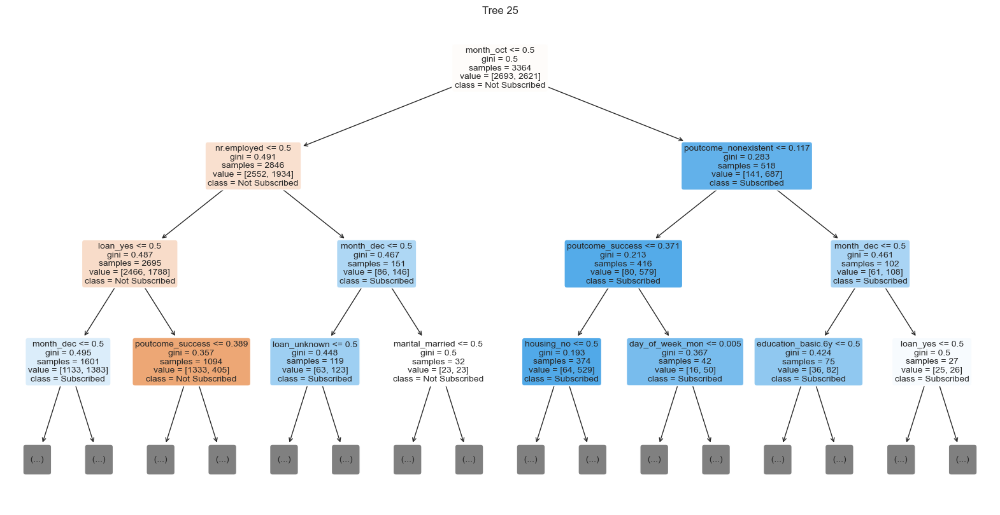

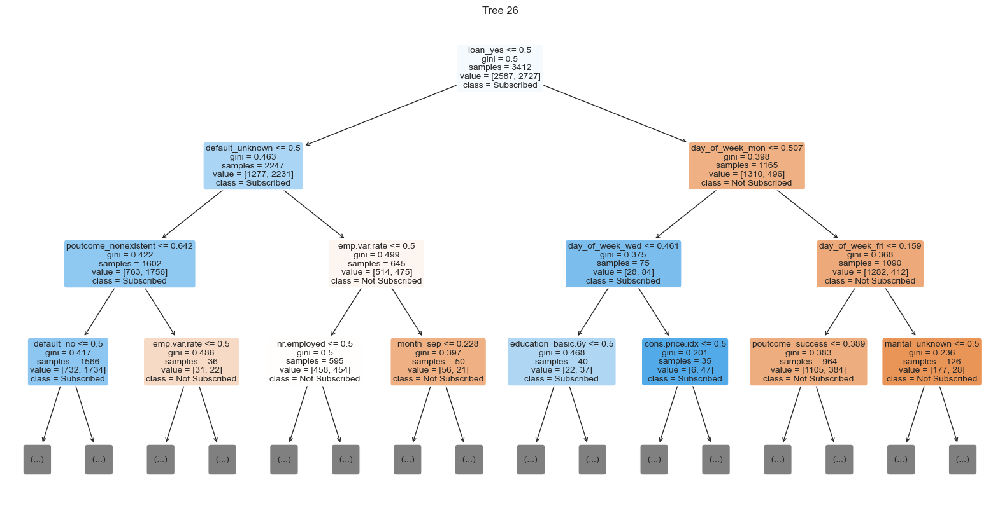

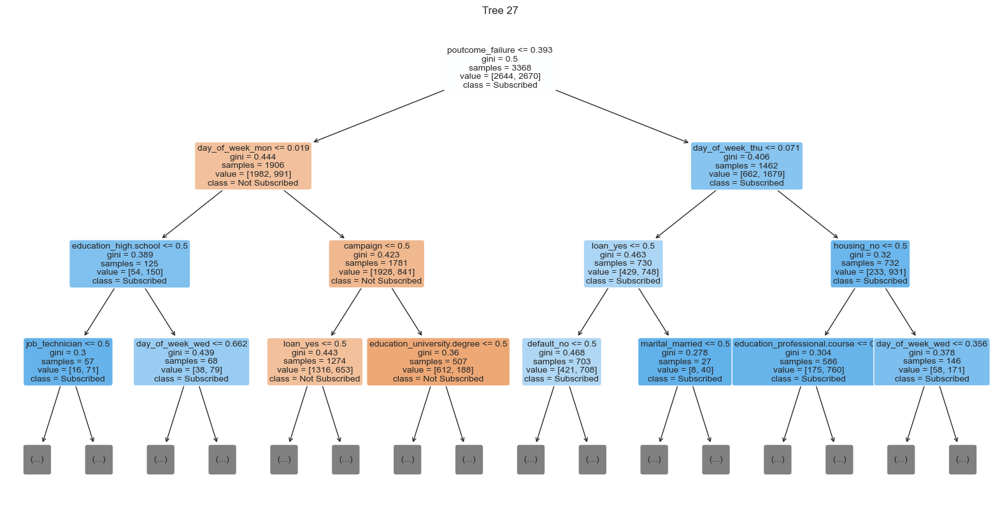

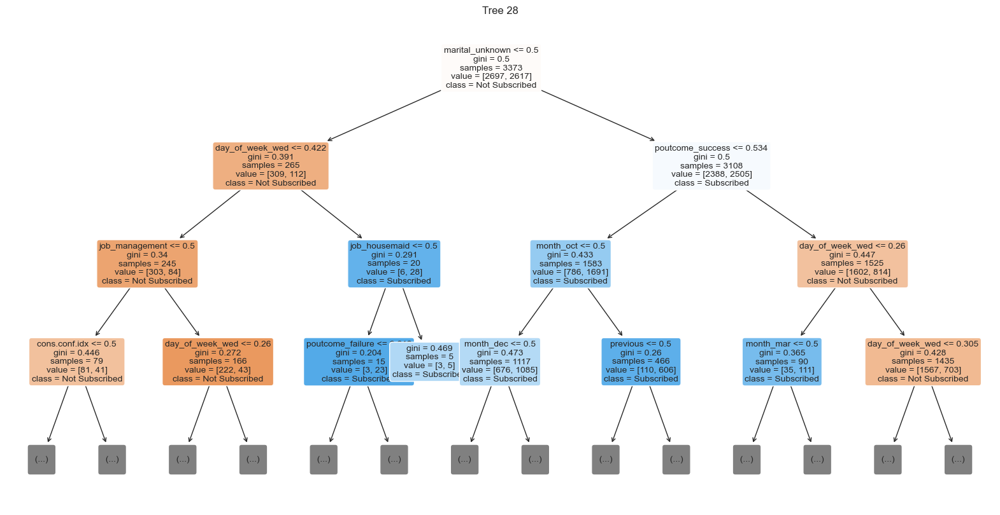

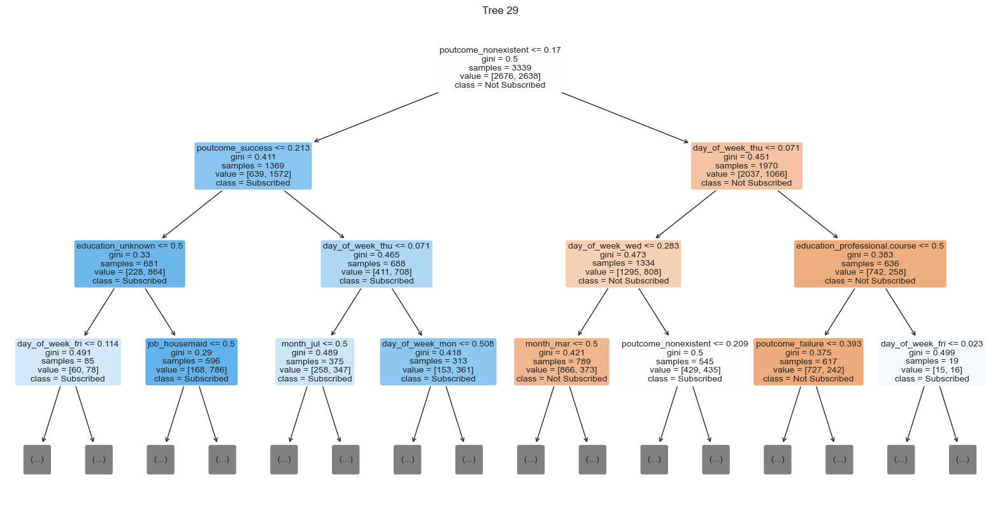

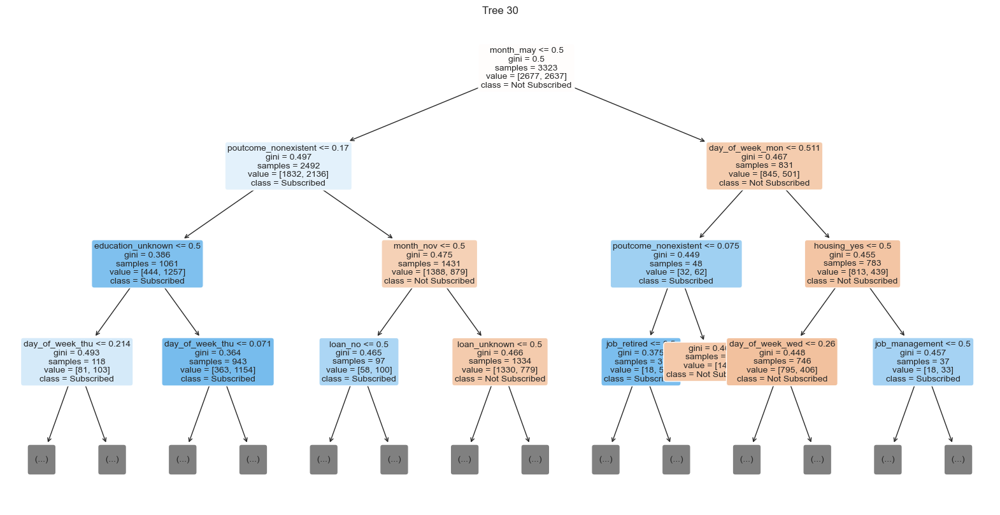

In [71]:
from sklearn.tree import plot_tree
import matplotlib.pyplot as plt
from imblearn.ensemble import BalancedRandomForestClassifier

# Define the range of trees to visualize
start_tree = 20  
end_tree = 30

# Loop through the desired range of trees and plot them
for i in range(start_tree, end_tree):
    chosen_tree = final_brf.estimators_[i]

    plt.figure(figsize=(20, 10))
    plot_tree(chosen_tree, feature_names=transformed_feature_names, class_names=['Not Subscribed', 'Subscribed'], 
              filled=True, rounded=True, fontsize=10, max_depth=3)
    plt.title(f"Tree {i+1}")
    plt.show()



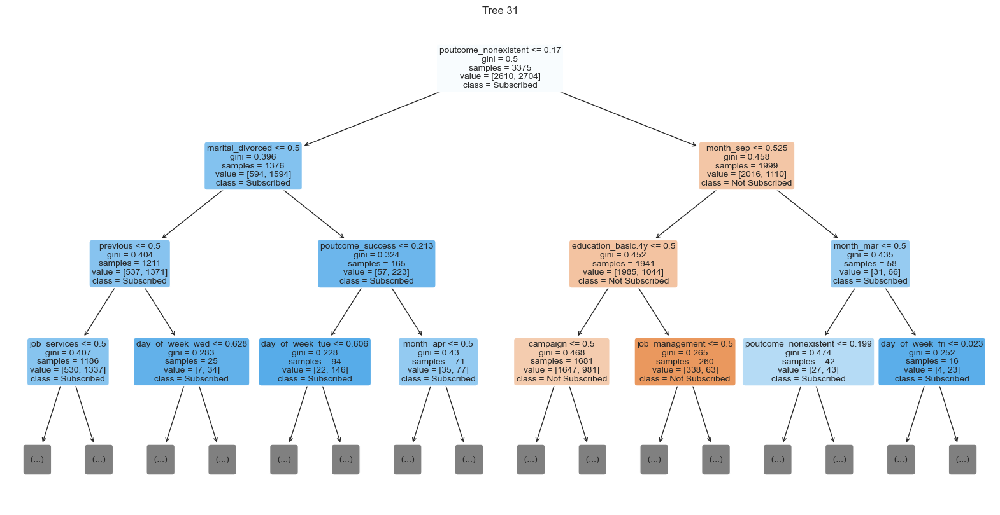

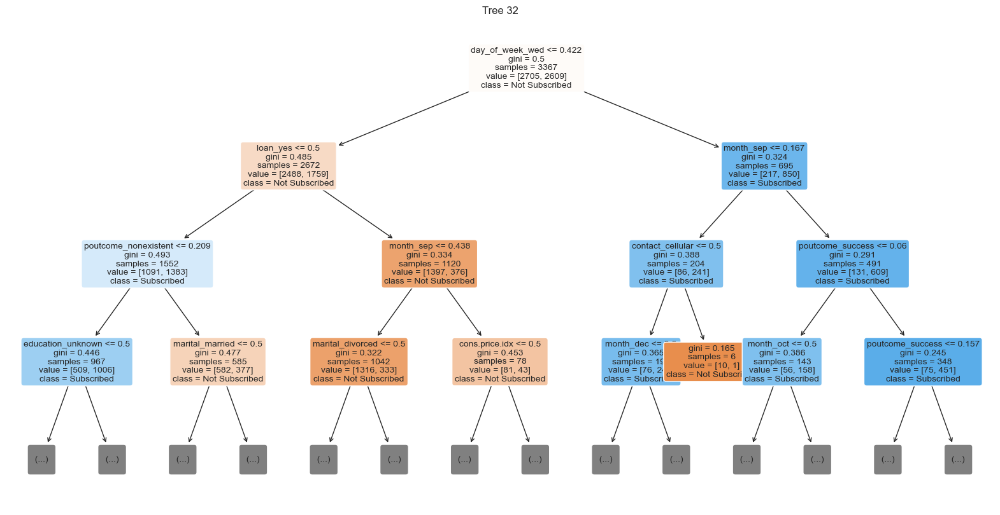

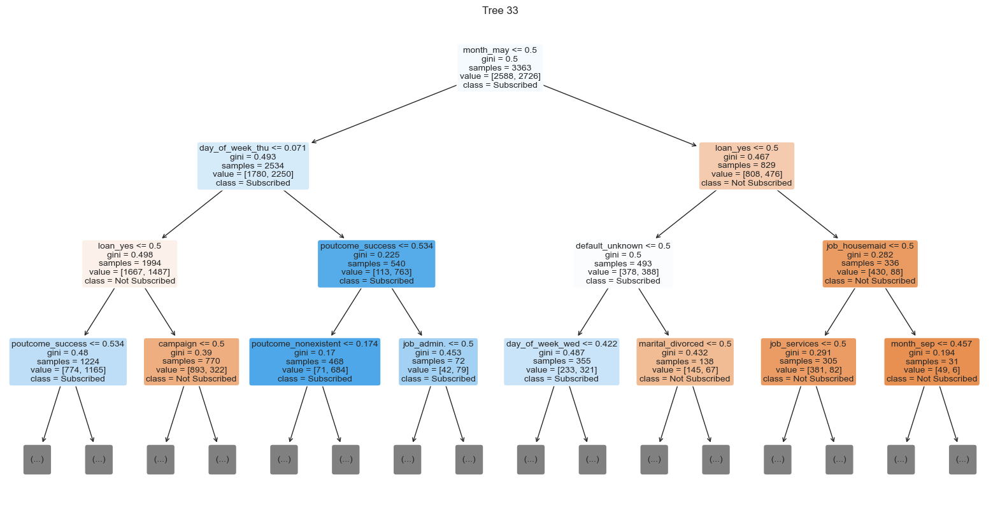

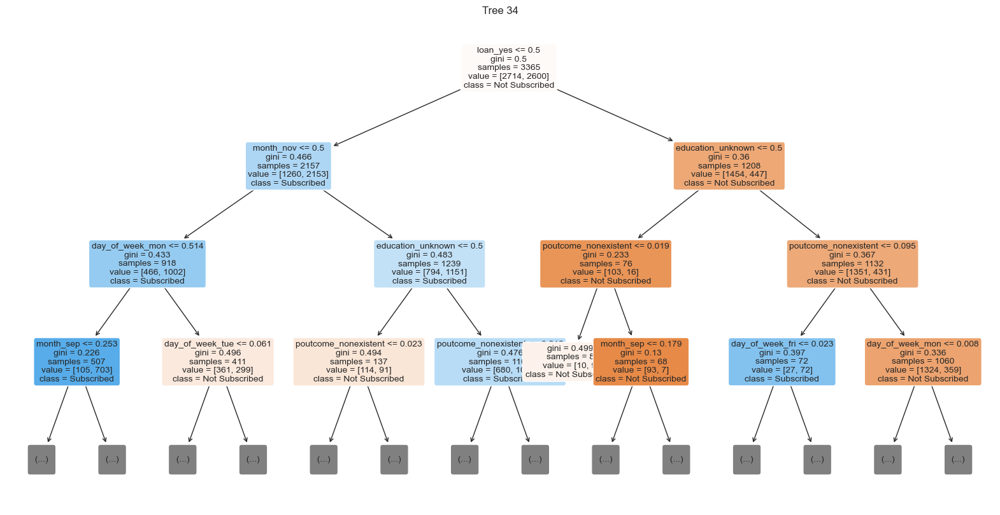

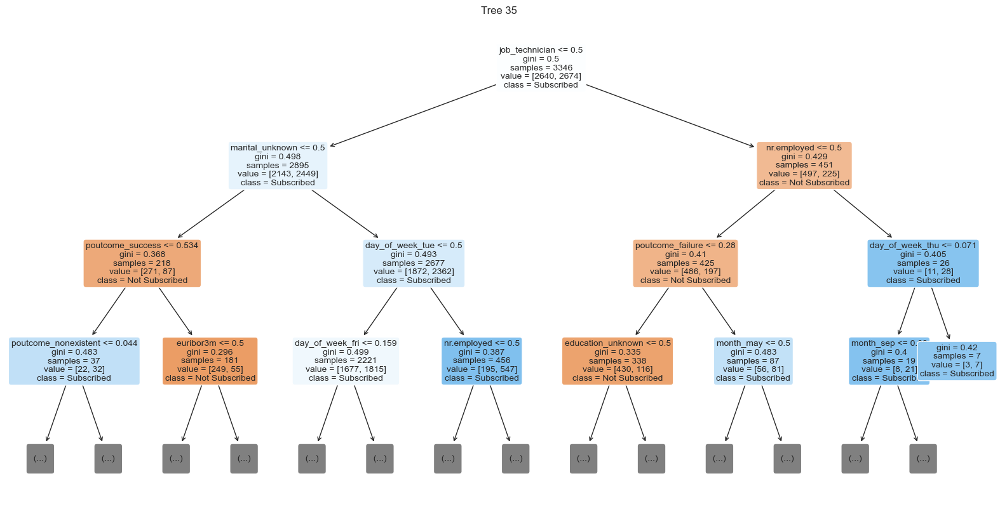

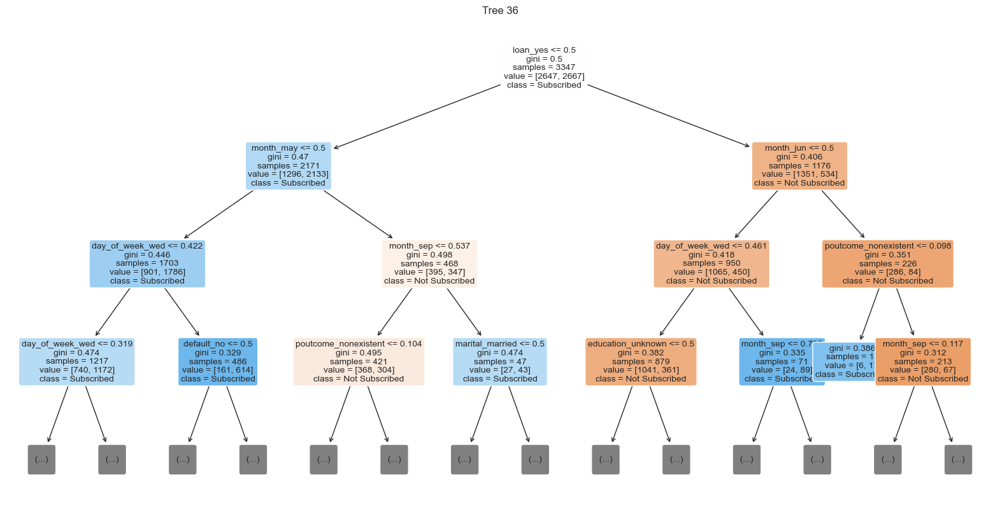

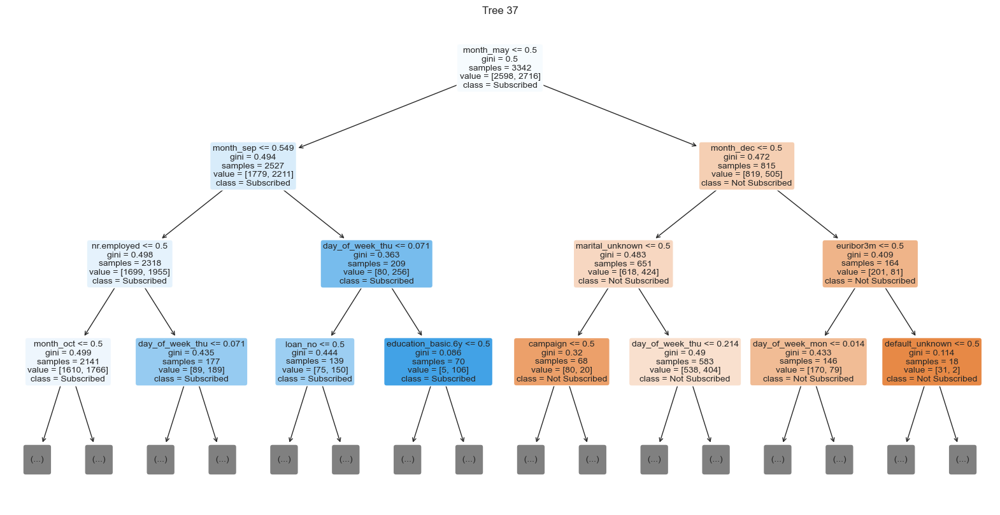

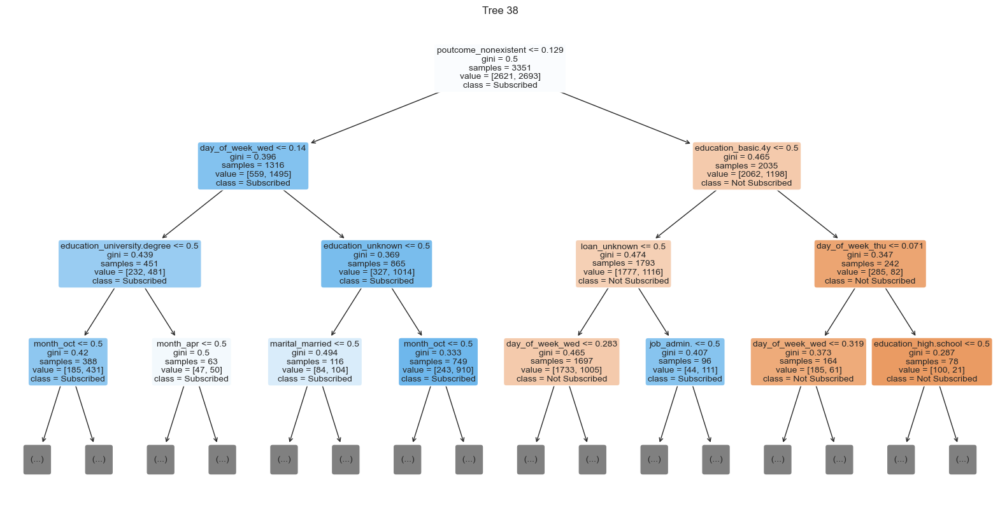

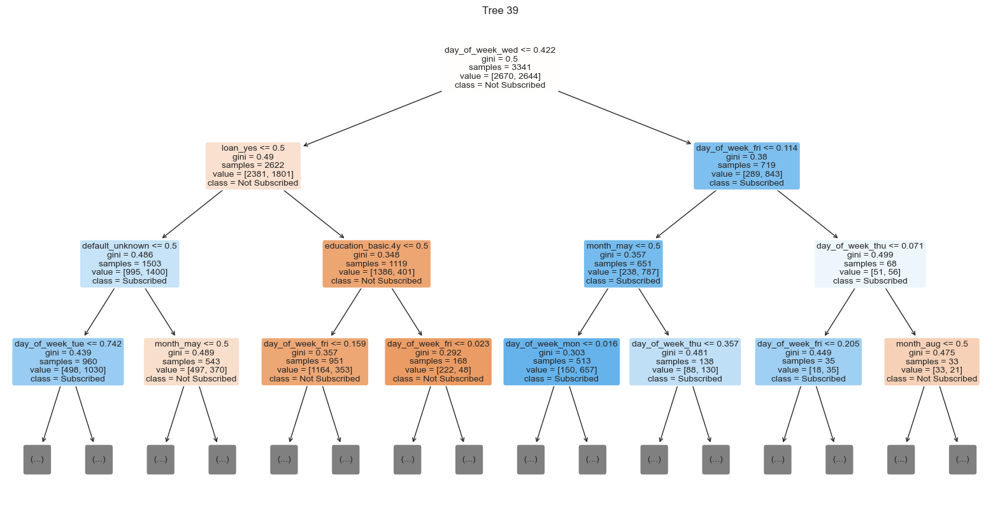

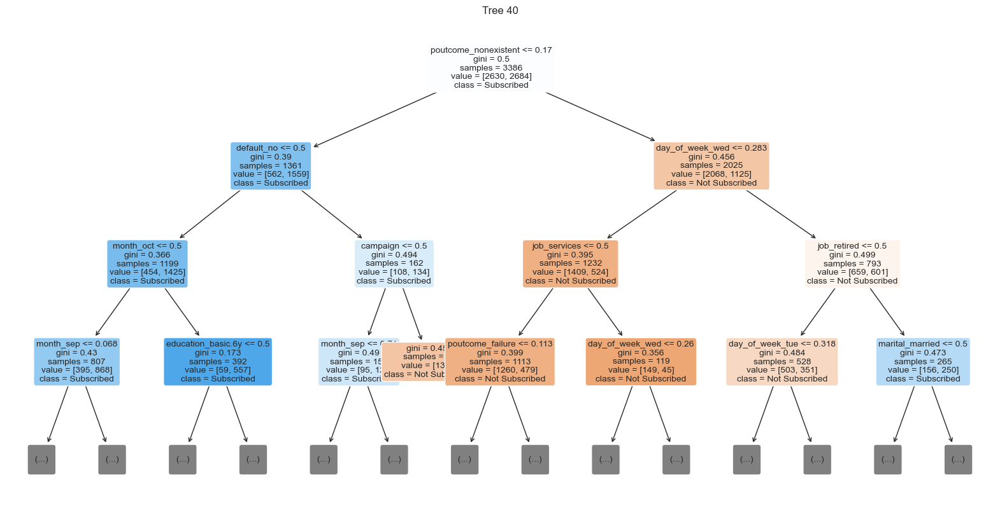

In [72]:
from sklearn.tree import plot_tree
import matplotlib.pyplot as plt
from imblearn.ensemble import BalancedRandomForestClassifier

# Define the range of trees to visualize
start_tree = 30  # 0-based index, so 10 refers to the 11th tree
end_tree = 40

# Loop through the desired range of trees and plot them
for i in range(start_tree, end_tree):
    chosen_tree = final_brf.estimators_[i]

    plt.figure(figsize=(20, 10))
    plot_tree(chosen_tree, feature_names=transformed_feature_names, class_names=['Not Subscribed', 'Subscribed'], 
              filled=True, rounded=True, fontsize=10, max_depth=3)
    plt.title(f"Tree {i+1}")
    plt.show()


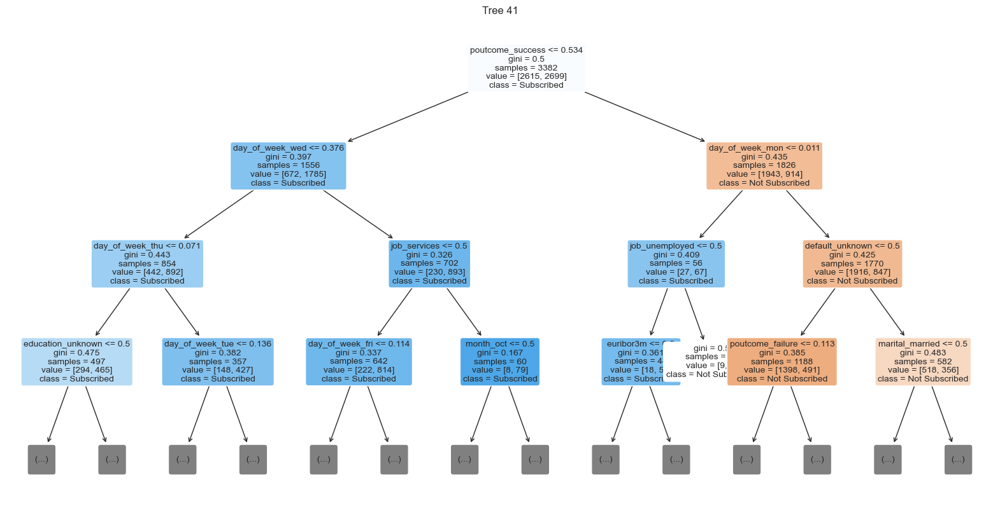

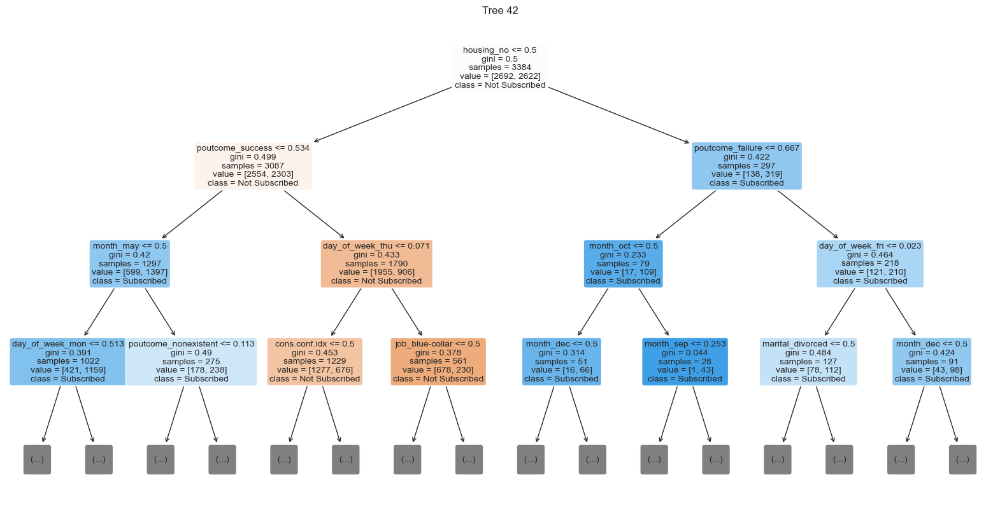

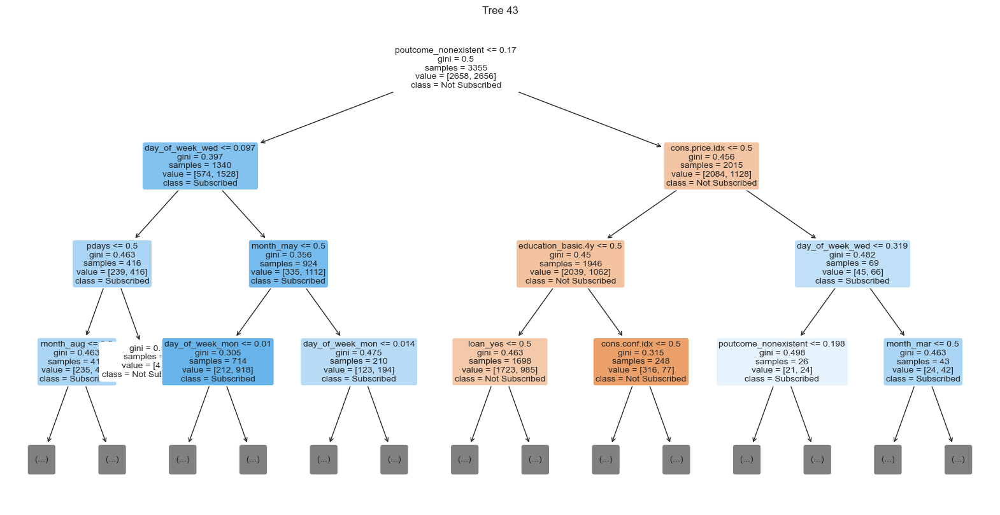

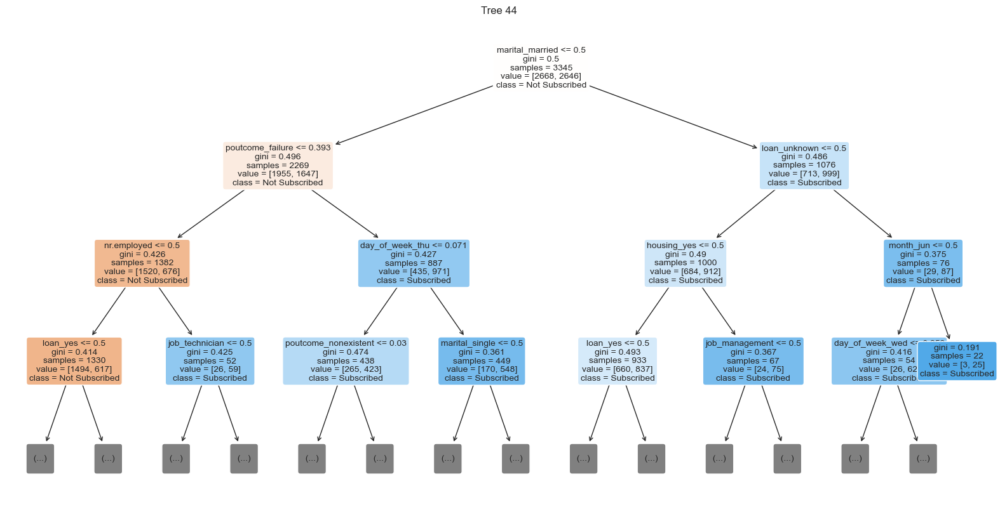

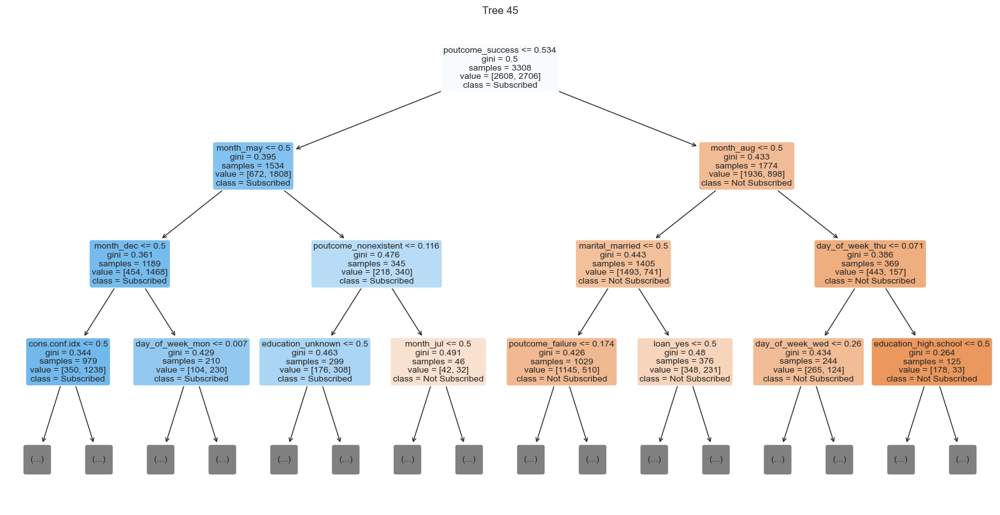

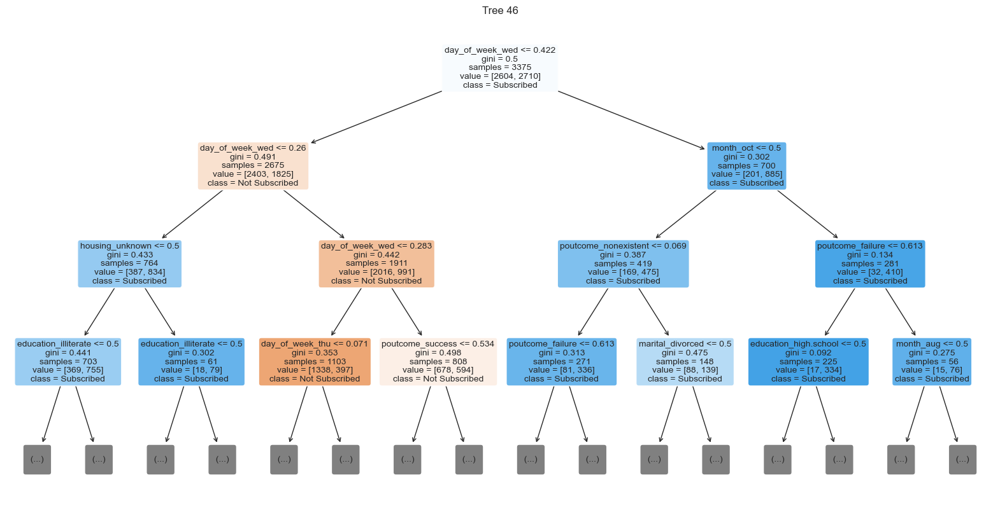

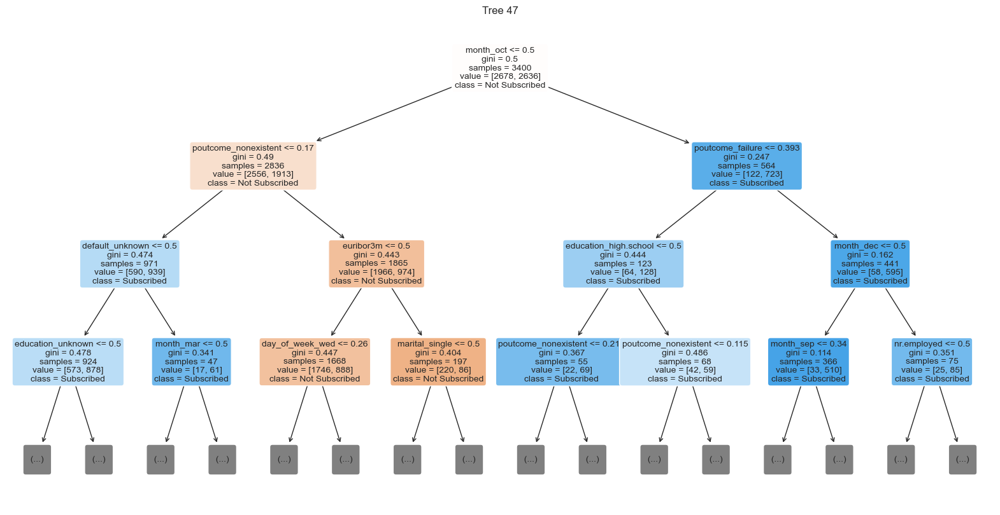

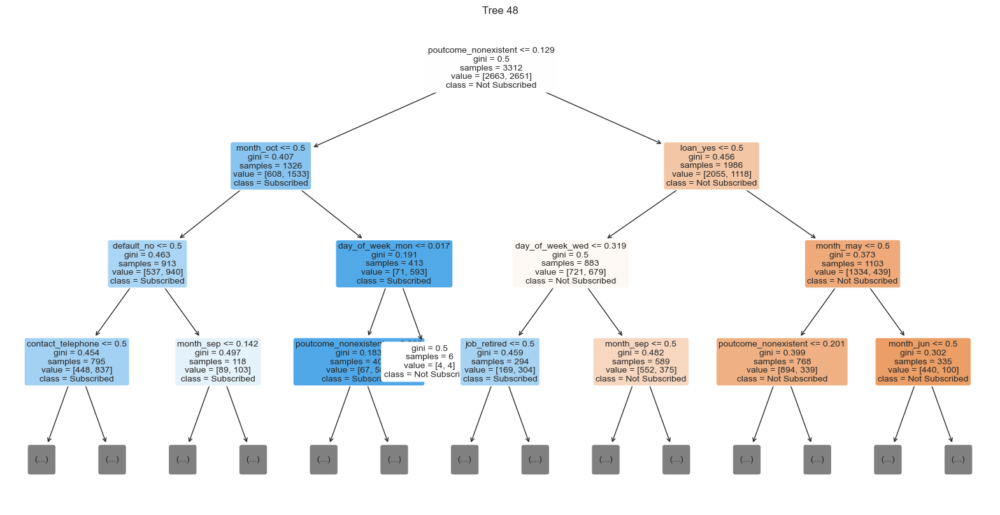

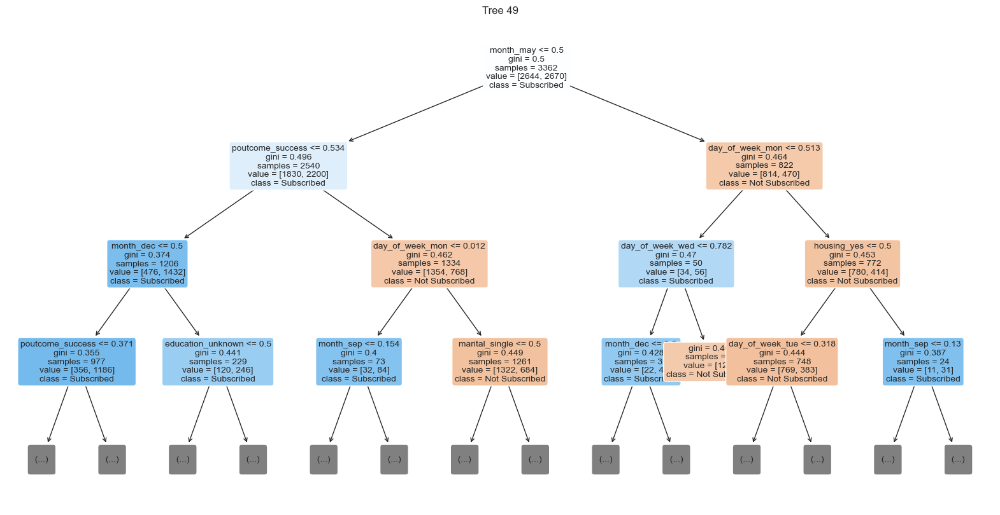

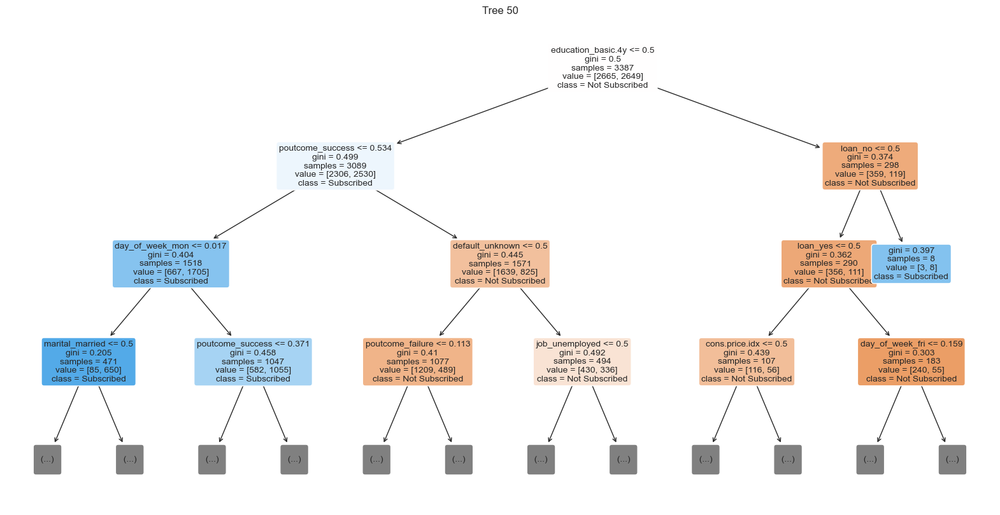

In [73]:
from sklearn.tree import plot_tree
import matplotlib.pyplot as plt
from imblearn.ensemble import BalancedRandomForestClassifier

# Define the range of trees to visualize
start_tree = 40  # 0-based index, so 10 refers to the 11th tree
end_tree = 50

# Loop through the desired range of trees and plot them
for i in range(start_tree, end_tree):
    chosen_tree = final_brf.estimators_[i]

    plt.figure(figsize=(20, 10))
    plot_tree(chosen_tree, feature_names=transformed_feature_names, class_names=['Not Subscribed', 'Subscribed'], 
              filled=True, rounded=True, fontsize=10, max_depth=3)
    plt.title(f"Tree {i+1}")
    plt.show()


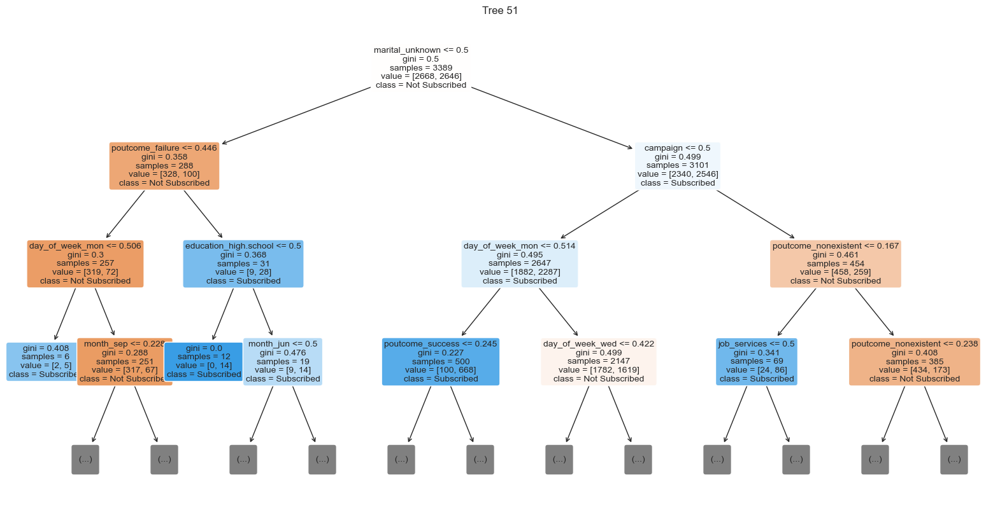

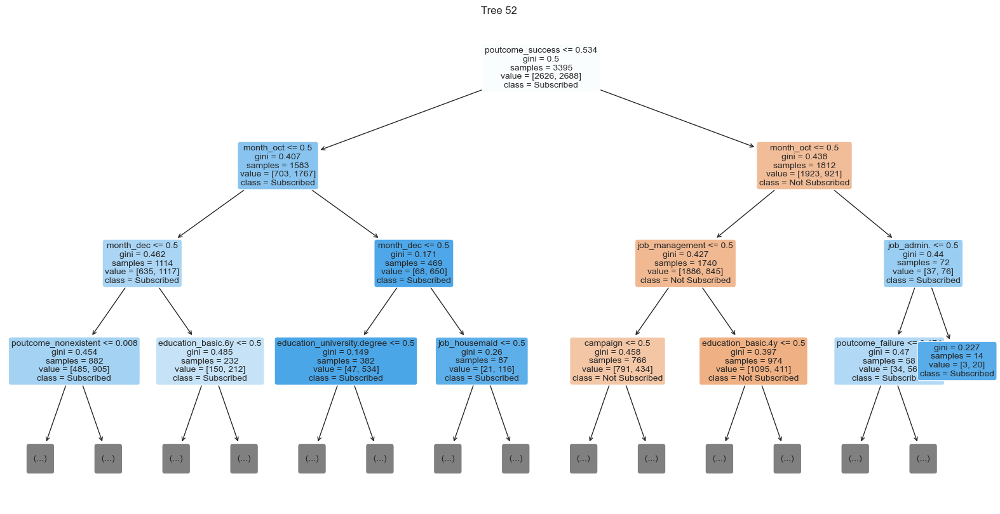

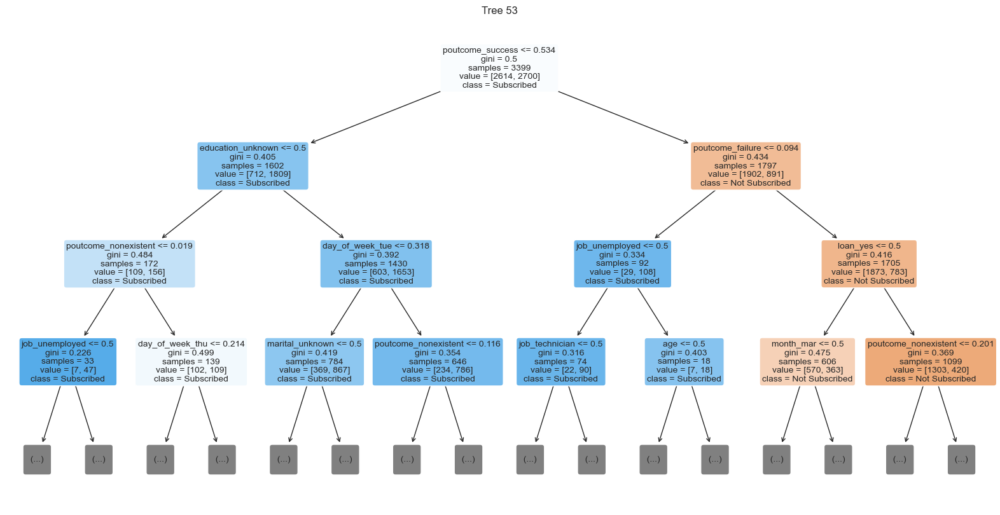

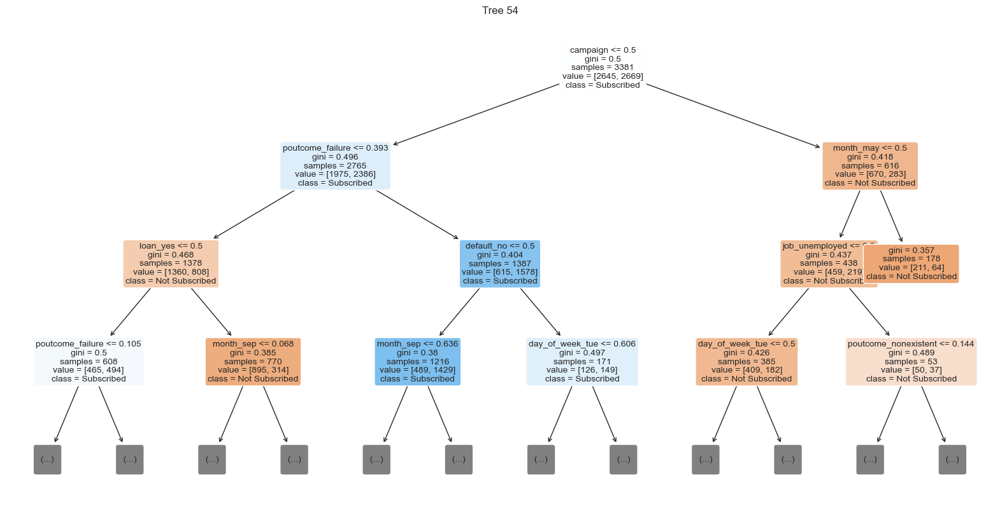

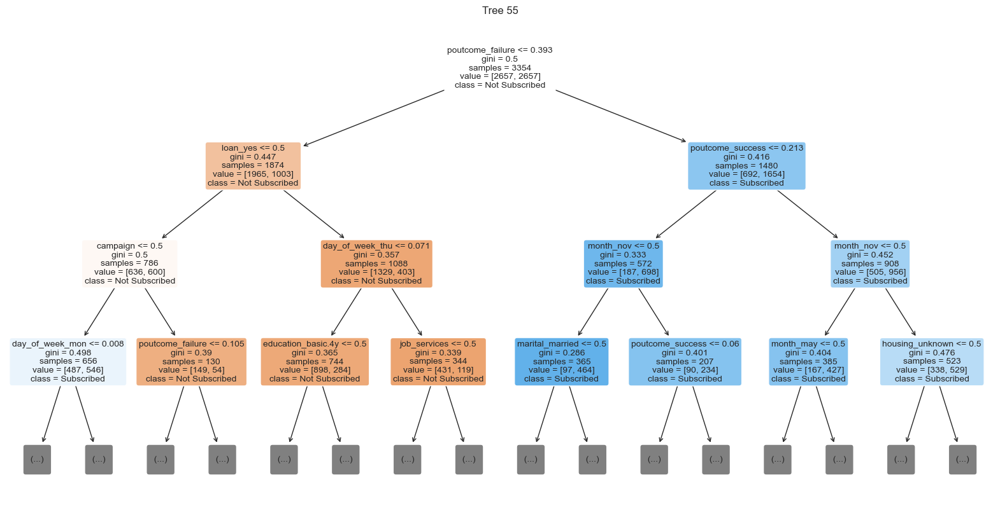

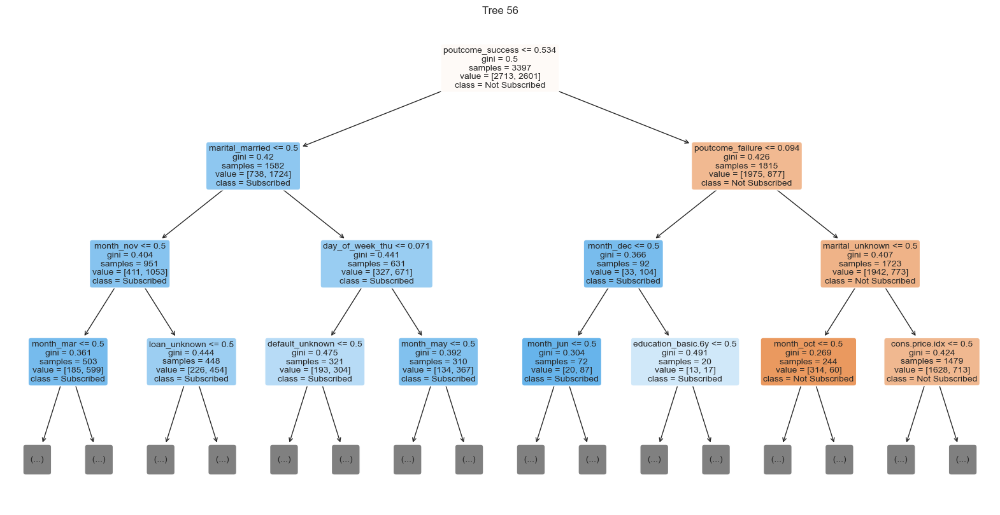

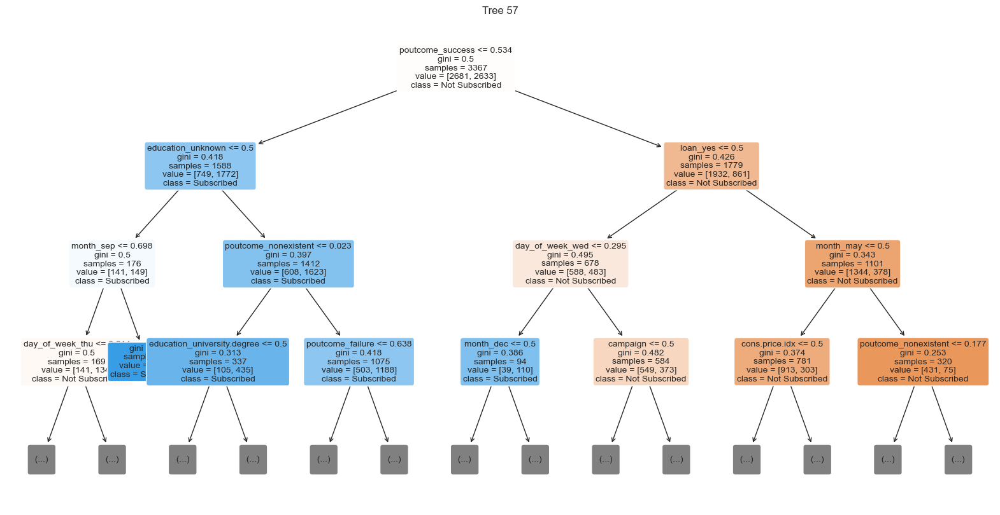

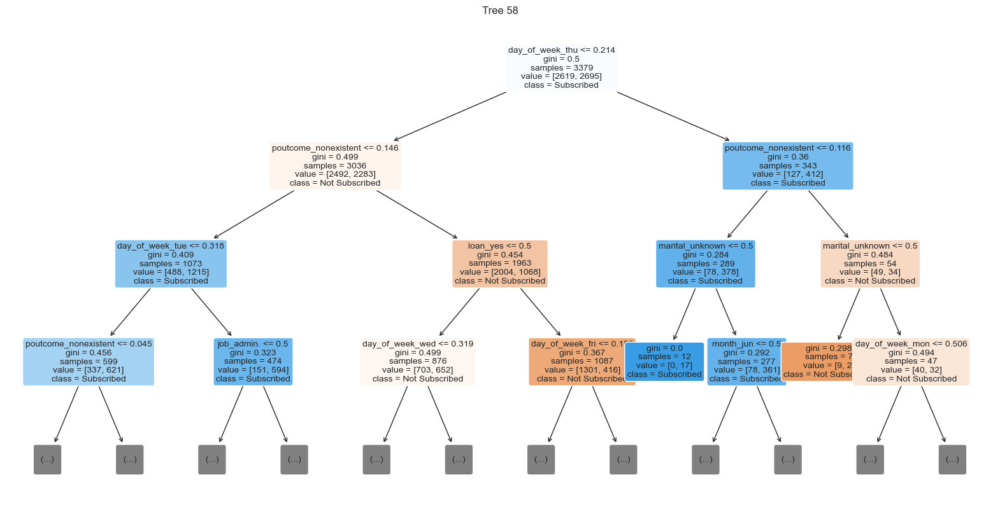

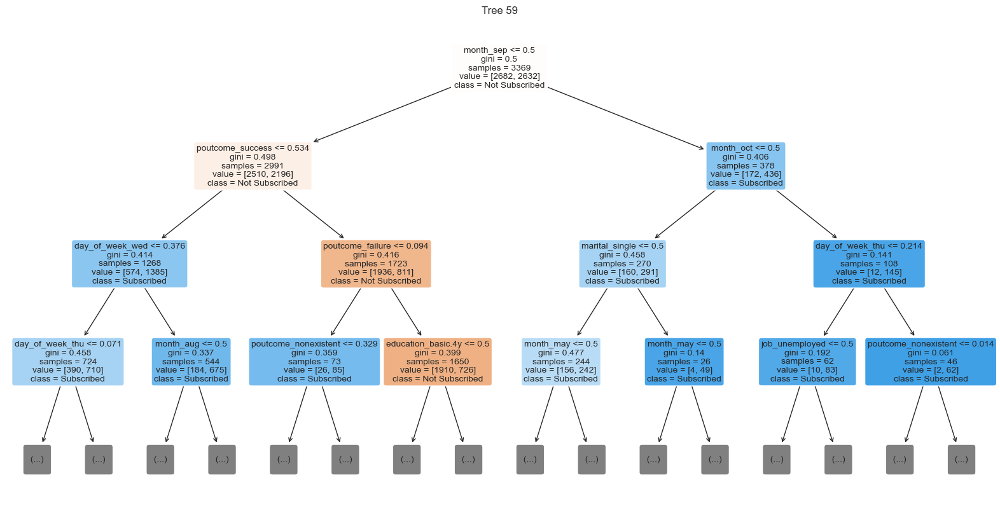

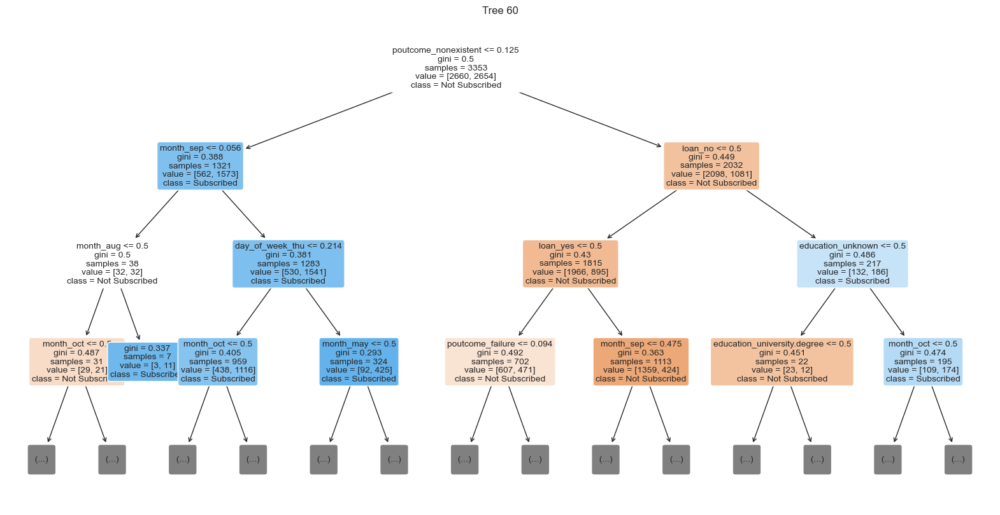

In [74]:
from sklearn.tree import plot_tree
import matplotlib.pyplot as plt
from imblearn.ensemble import BalancedRandomForestClassifier

# Define the range of trees to visualize
start_tree = 50  
end_tree = 60

# Loop through the desired range of trees and plot them
for i in range(start_tree, end_tree):
    chosen_tree = final_brf.estimators_[i]

    plt.figure(figsize=(20, 10))
    plot_tree(chosen_tree, feature_names=transformed_feature_names, class_names=['Not Subscribed', 'Subscribed'], 
              filled=True, rounded=True, fontsize=10, max_depth=3)
    plt.title(f"Tree {i+1}")
    plt.show()


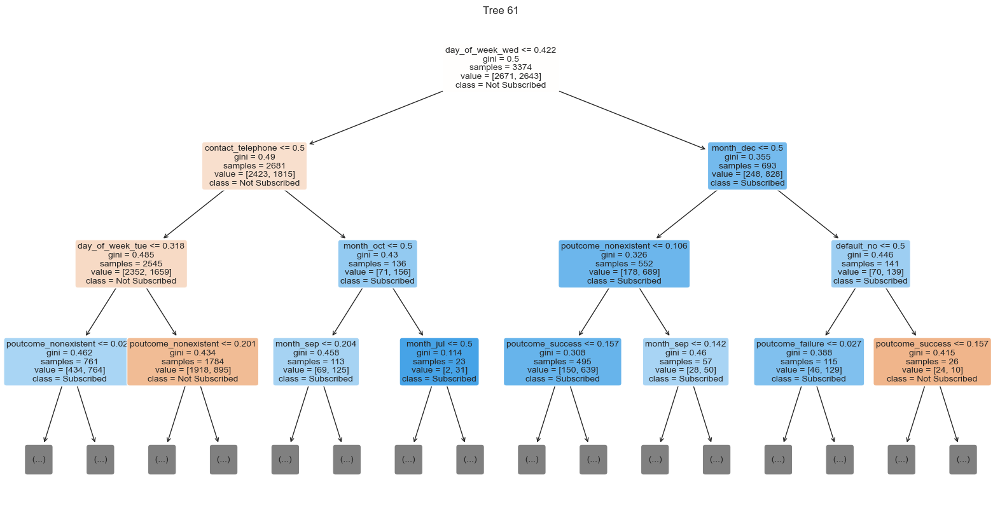

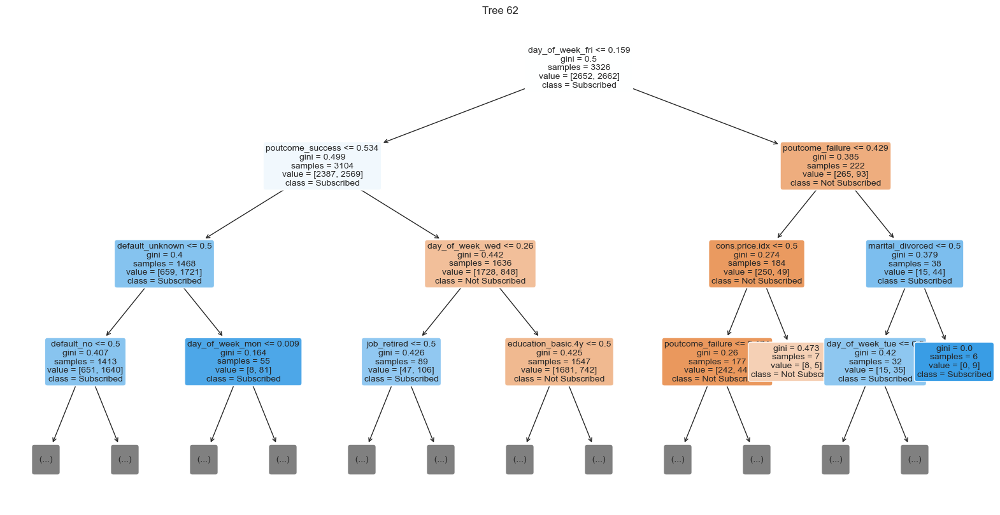

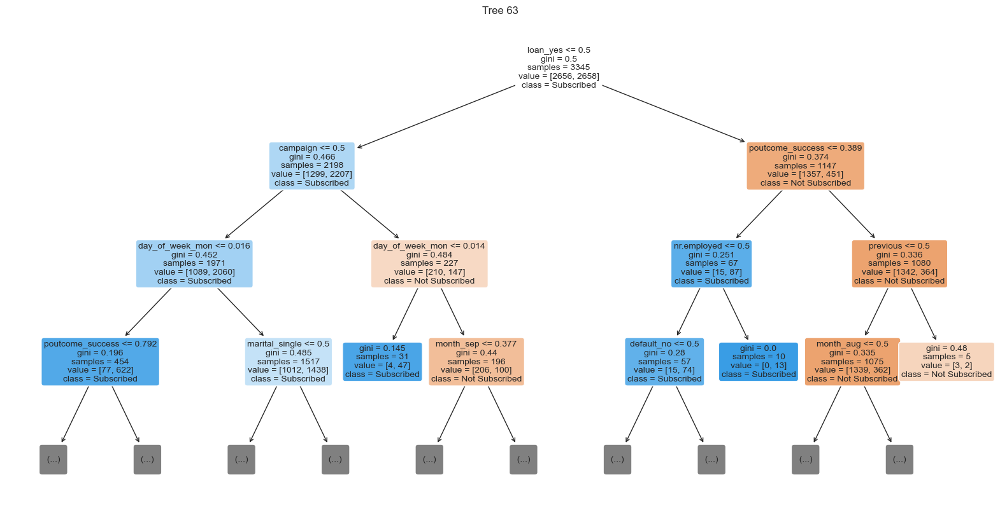

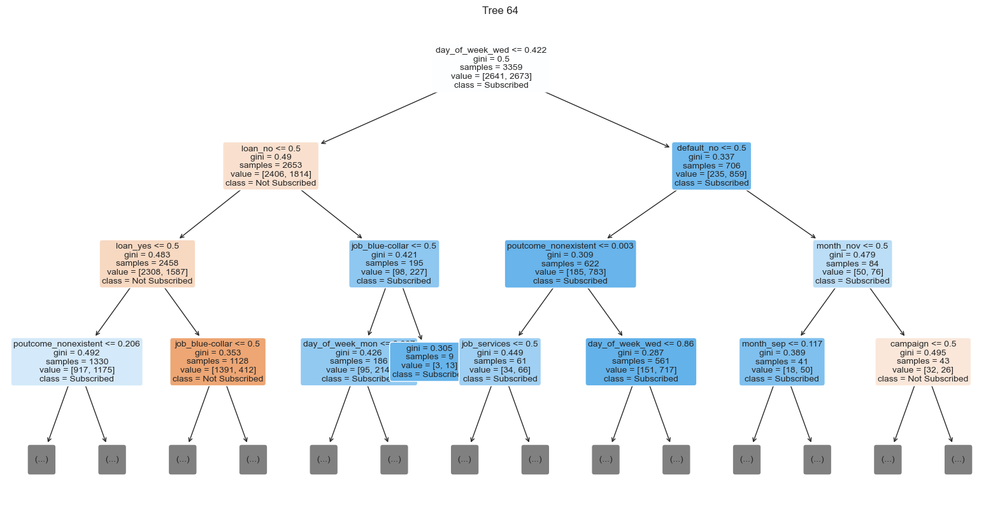

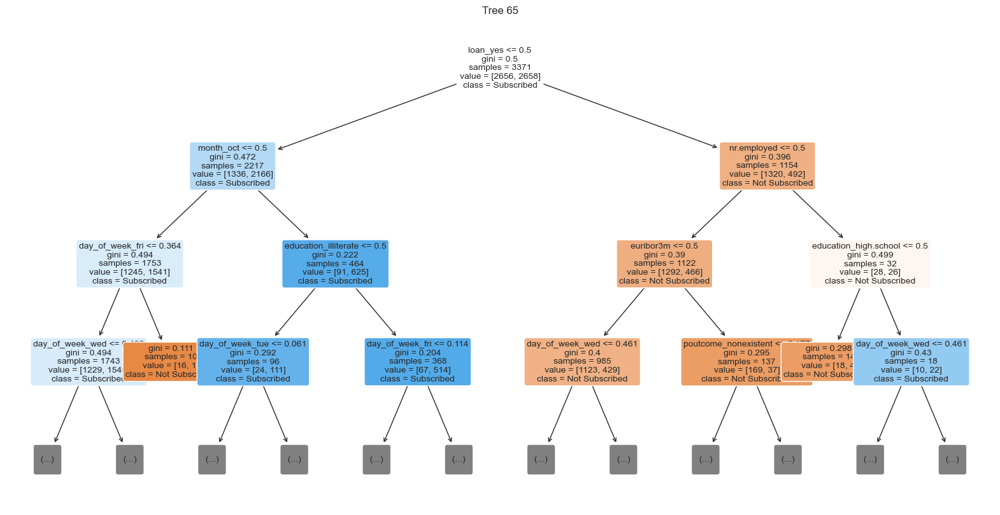

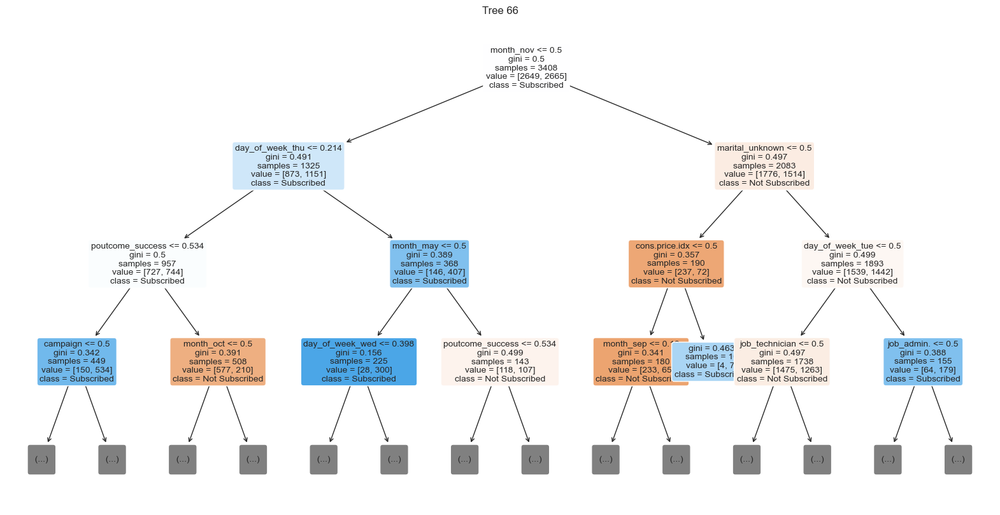

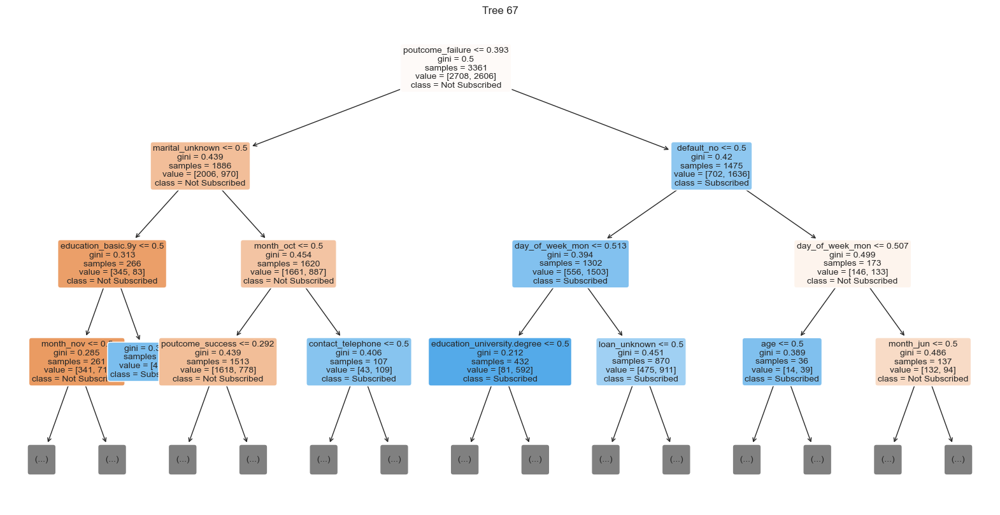

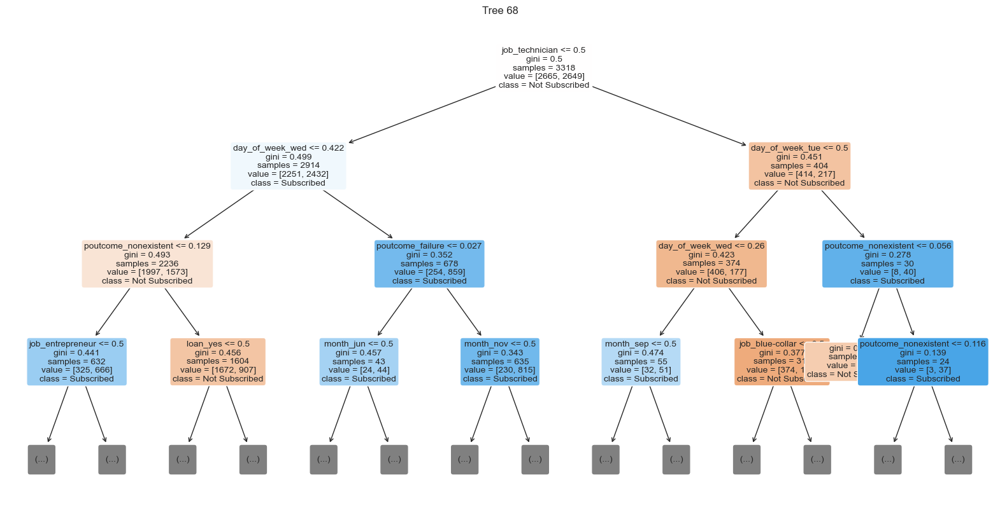

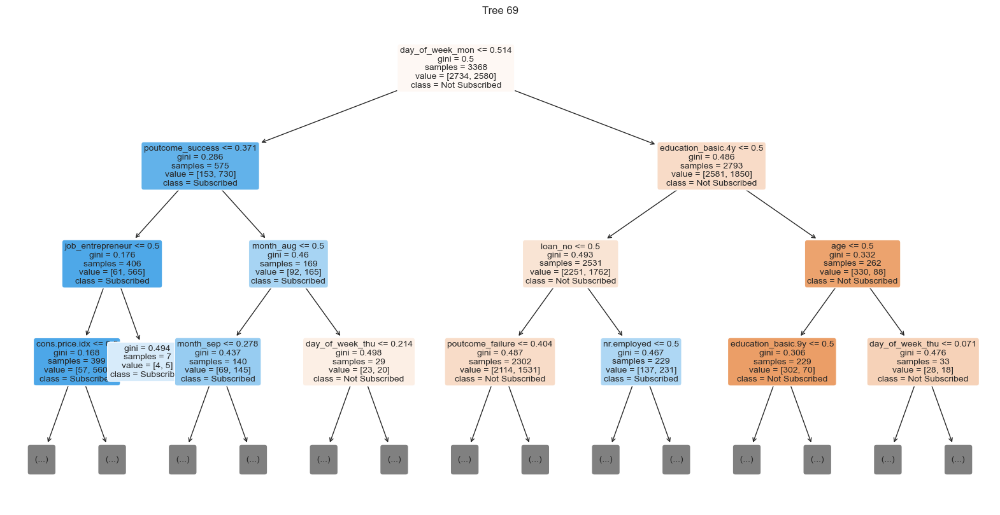

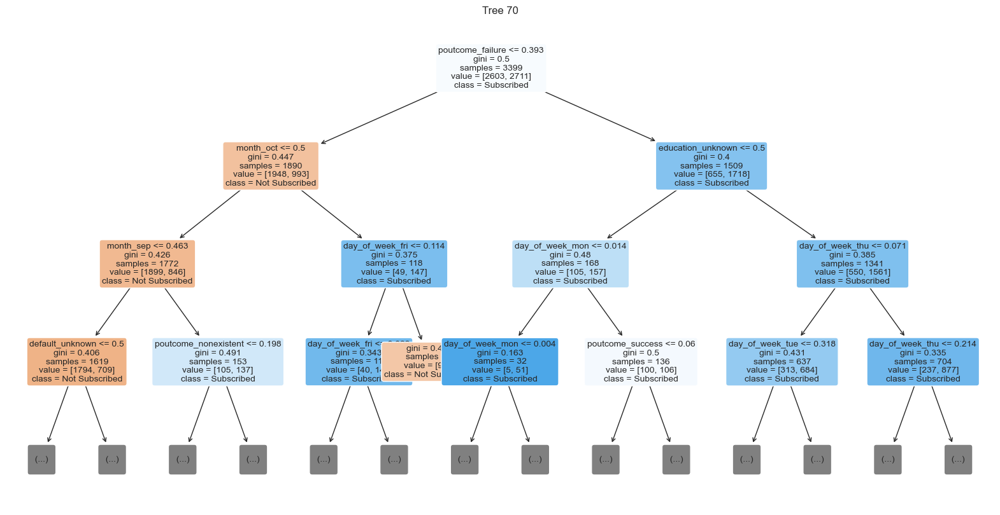

In [75]:
from sklearn.tree import plot_tree
import matplotlib.pyplot as plt
from imblearn.ensemble import BalancedRandomForestClassifier

# Define the range of trees to visualize
start_tree = 60  
end_tree = 70

# Loop through the desired range of trees and plot them
for i in range(start_tree, end_tree):
    chosen_tree = final_brf.estimators_[i]

    plt.figure(figsize=(20, 10))
    plot_tree(chosen_tree, feature_names=transformed_feature_names, class_names=['Not Subscribed', 'Subscribed'], 
              filled=True, rounded=True, fontsize=10, max_depth=3)
    plt.title(f"Tree {i+1}")
    plt.show()


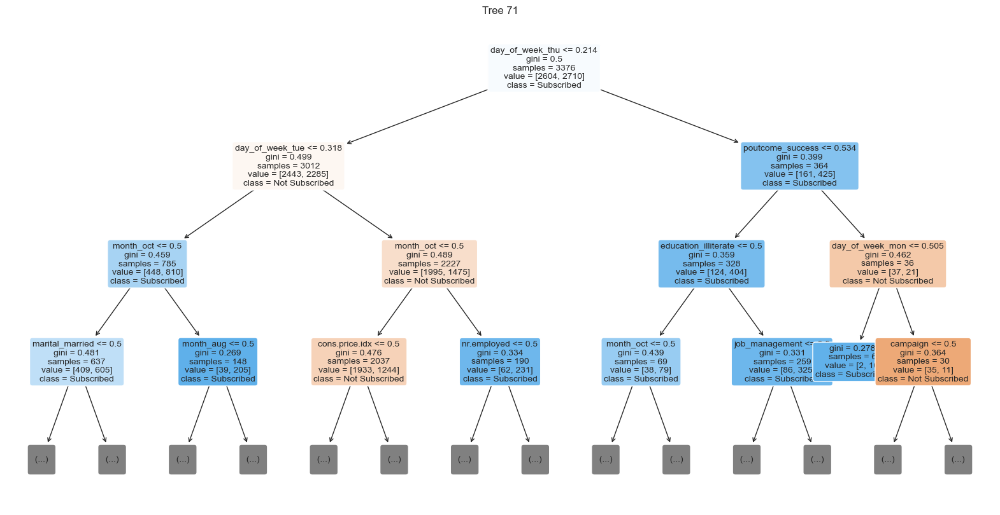

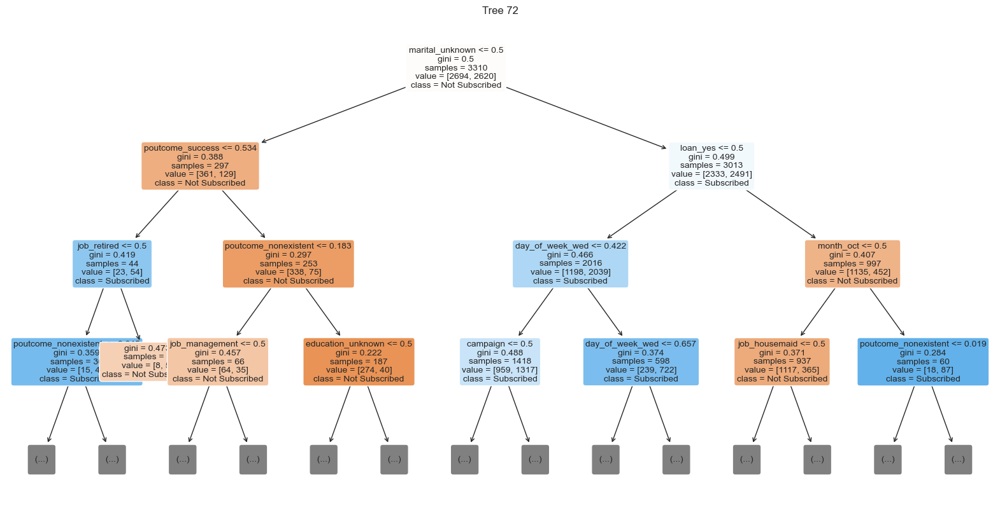

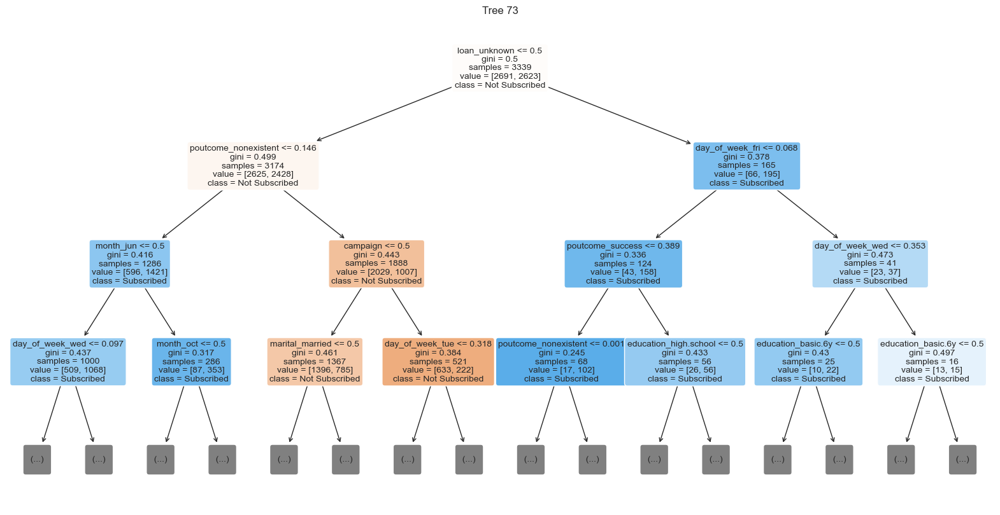

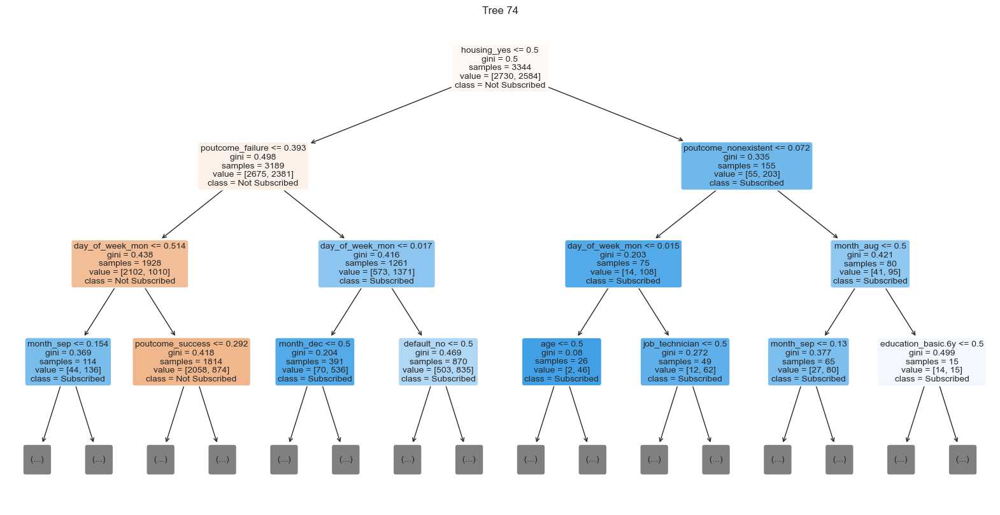

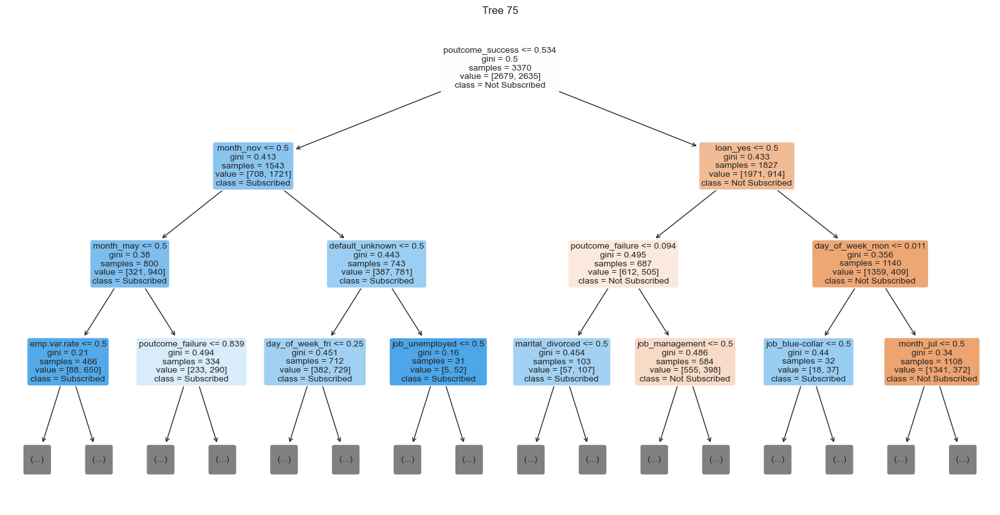

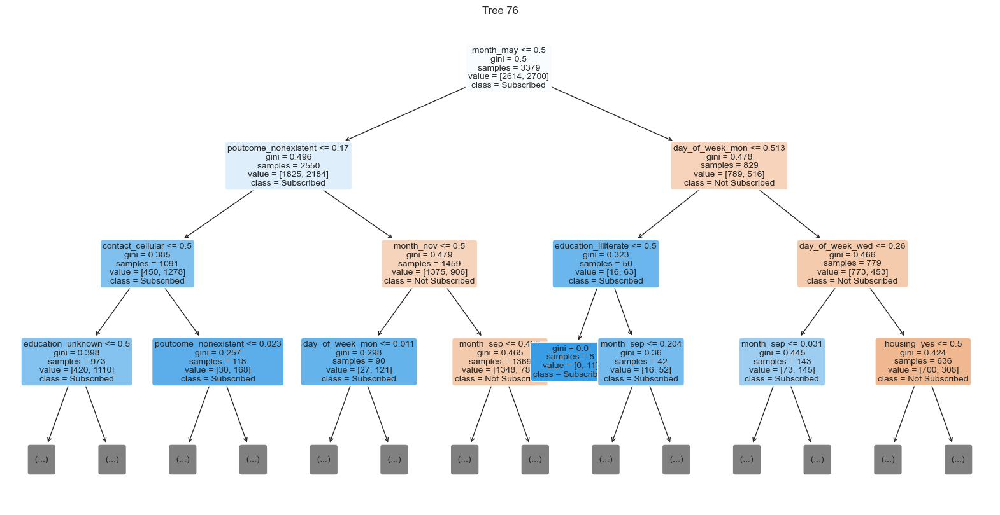

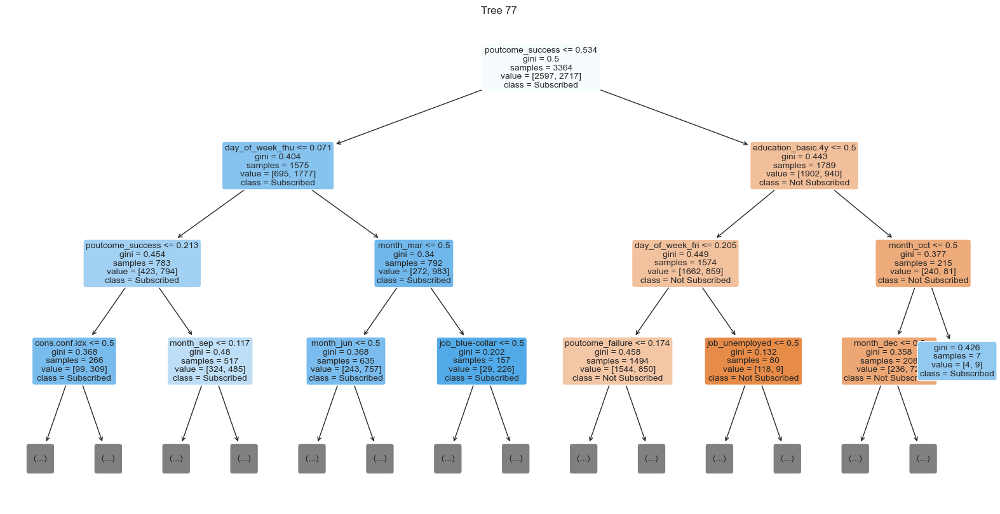

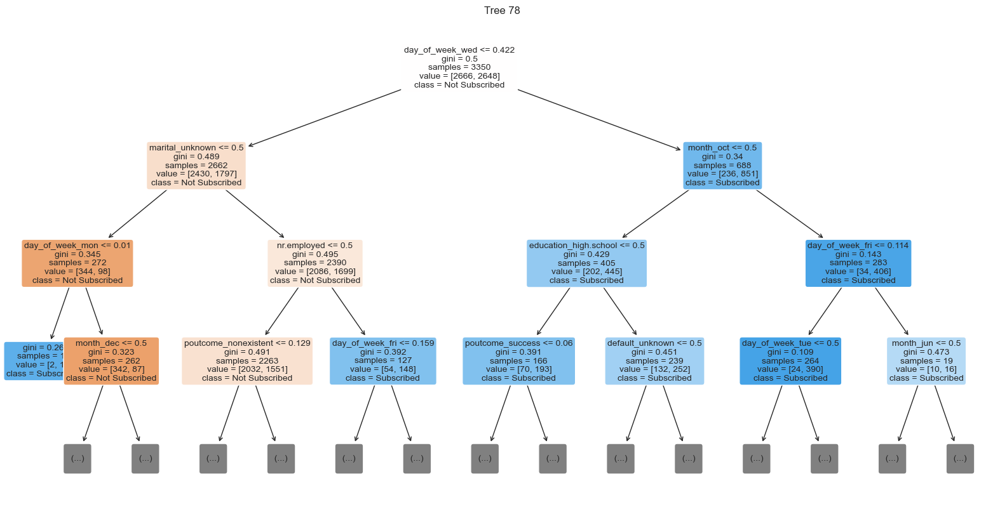

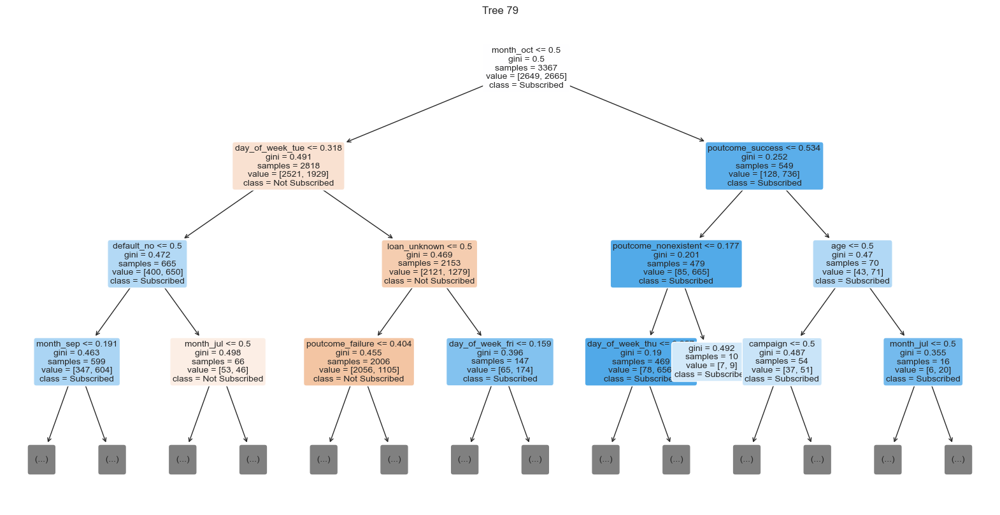

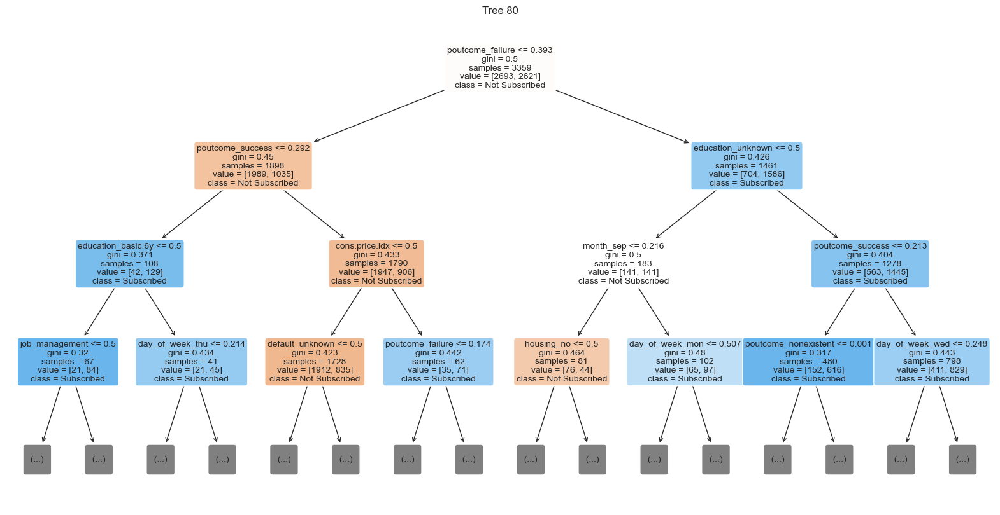

In [76]:
from sklearn.tree import plot_tree
import matplotlib.pyplot as plt
from imblearn.ensemble import BalancedRandomForestClassifier

# Define the range of trees to visualize
start_tree = 70  
end_tree = 80

# Loop through the desired range of trees and plot them
for i in range(start_tree, end_tree):
    chosen_tree = final_brf.estimators_[i]

    plt.figure(figsize=(20, 10))
    plot_tree(chosen_tree, feature_names=transformed_feature_names, class_names=['Not Subscribed', 'Subscribed'], 
              filled=True, rounded=True, fontsize=10, max_depth=3)
    plt.title(f"Tree {i+1}")
    plt.show()


Since there are 143 trees from random forest, after visualizing those trees randomly, we get the following
### Insights:
#### poutcome_success:

poutcome_success ≤ 0.534: Customers are inclined to subscribe. Several factors including day_of_week(fri,tue,mon,wed), poutcome_nonexistent, month_sep, housing_yes, and others enhance this likelihood. The frequent appearance of month_sep indicates its significance.

poutcome_success > 0.534: Generally, customers in this segment are not inclined to subscribe, with the exception being those with poutcome_failure ≤ 0.174. 

#### poutcome_nonexistent:

poutcome_nonexistent≤ 0.17: These customers are generally inclined to subscribe


#### Credit Default and Marital Status:

Customers with credit_default_yes > 0.5 and marital_status_unknown <= 0.5 are less likely to subscribe, indicating the strong influence of credit default status.

### Recommendations:
Tailored Strategies and Targeted Campaigns:

Develop different strategies based on customer’s past interactions and the month of contact.
Focus on customers with poutcome_success ≤ 0.469 and poutcome_nonexistent ≤ 0.145, as they show a higher inclination to subscribe.
Be cautious with campaigns in July for customers with poutcome_nonexistent ≤ 0.145 and optimize strategies for September.

Segmentation, Personalization, and Re-engagement:

Utilize insights around key features like poutcome_success, poutcome_nonexistent, and month_sep to refine targeting and messaging.
Develop personalized strategies considering customer attributes such as marital status, job type, and housing situation.

For customers with poutcome_failure ≤ 0.4, develop re-engagement strategies focusing on addressing issues from previous interactions.
Risk Management and Customer Education:

Adopt a cautious approach for customers with credit in default. Educate them on financial management and the benefits of the product, considering their credit history.
Comprehensive Customer Understanding:

Build a comprehensive understanding of each customer's profile by leveraging insights from both poutcome_success and credit default_yes along with other features.